# **Classification with Linear Models**

### **Folder chứa các file cần thiết cho quá trình thực thi chương trình:**
[Link đến thư mục trên Google Drive](https://drive.google.com/drive/folders/1WnS_msHSWi8y5DanKusG4fHOVZ1UbZrB?usp=sharing)


## **01. Data Loading & Preprocessing:**

### **Tiến Hành Load Dữ Liệu và Reshape Ảnh**

Trong bài này, chúng ta sẽ load dữ liệu từ tập dữ liệu Fashion-MNIST, sau đó tiến hành reshape để đưa về định dạng ảnh gốc. Dữ liệu trong Fashion-MNIST được lưu ở dạng (số mẫu, 28, 28) hoặc (số mẫu, 28, 28, 1), tức là ảnh đã ở dạng Grayscale (hình trắng đen).

#### **Các Bước Thực Hiện:**

1. **Load Dữ Liệu**: Sử dụng các hàm để đọc ảnh và nhãn từ các file nhị phân.
2. **Reshape Ảnh**: Chuyển đổi dữ liệu ảnh về dạng (số mẫu, 28, 28) hoặc (số mẫu, 28, 28, 1) để phù hợp với yêu cầu của mô hình.

In [ ]:
import numpy as np

def read_mnist_images(file):
    with open(file, 'rb') as f:
        f.read(16)
        buf = f.read()
    return np.frombuffer(buf, dtype=np.uint8)

def read_mnist_labels(file):
    with open(file, 'rb') as f:
        f.read(8)
        buf = f.read()
        return np.frombuffer(buf, dtype=np.uint8)


X_train = read_mnist_images('train-images-idx3-ubyte')
y_train = read_mnist_labels('train-labels-idx1-ubyte')
X_test = read_mnist_images('t10k-images-idx3-ubyte')
y_test = read_mnist_labels('t10k-labels-idx1-ubyte')


print("Train Images Shape:", X_train.shape)
print("Test Images Shape:", X_test.shape)

X_train = X_train.reshape(-1, 28, 28)
X_test = X_test.reshape(-1, 28, 28)


print("Train Images after reshape:", X_train.shape)
print("Test Images after reshape:", X_test.shape)


Train Images Shape: (47040000,)
Test Images Shape: (7840000,)
Train Images after reshape: (60000, 28, 28)
Test Images after reshape: (10000, 28, 28)


**Bộ dữ liệu đã được chia sẵn train-test nên nhóm sẽ chỉ tiến hành đọc vào và không chia lại vì 60000 cho tập train và 10000 cho tập test là con số hợp lí**

**Dữ liệu trong tập Fashion-MNIST có 10 class với các label tương ứng như sau:**

| Label | Description  |
|-------|--------------|
| 0     | T-shirt/top  |
| 1     | Trouser      |
| 2     | Pullover     |
| 3     | Dress        |
| 4     | Coat         |
| 5     | Sandal       |
| 6     | Shirt        |
| 7     | Sneaker      |
| 8     | Bag          |
| 9     | Ankle boot   |


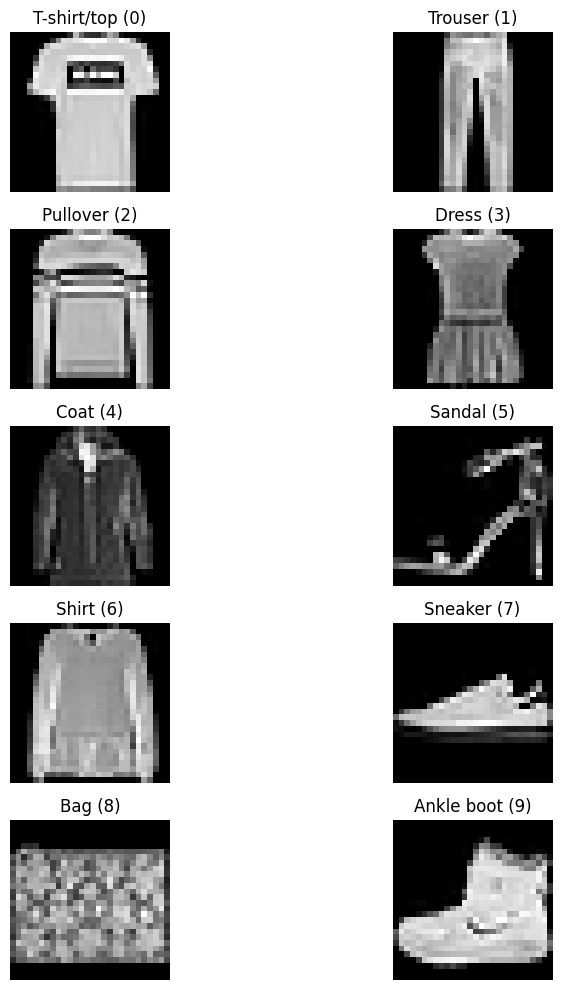

In [ ]:
import matplotlib.pyplot as plt

label_description = {
    0: "T-shirt/top",
    1: "Trouser",
    2: "Pullover",
    3: "Dress",
    4: "Coat",
    5: "Sandal",
    6: "Shirt",
    7: "Sneaker",
    8: "Bag",
    9: "Ankle boot"
}

plt.figure(figsize=(10, 10))
for i in range(10):
    plt.subplot(5, 2, i + 1)
    idx = np.where(y_train == i)[0][0]
    plt.imshow(X_train[idx], cmap='gray')
    plt.title(f"{label_description[i]} ({i})")
    plt.axis('off')

plt.tight_layout()
plt.show()

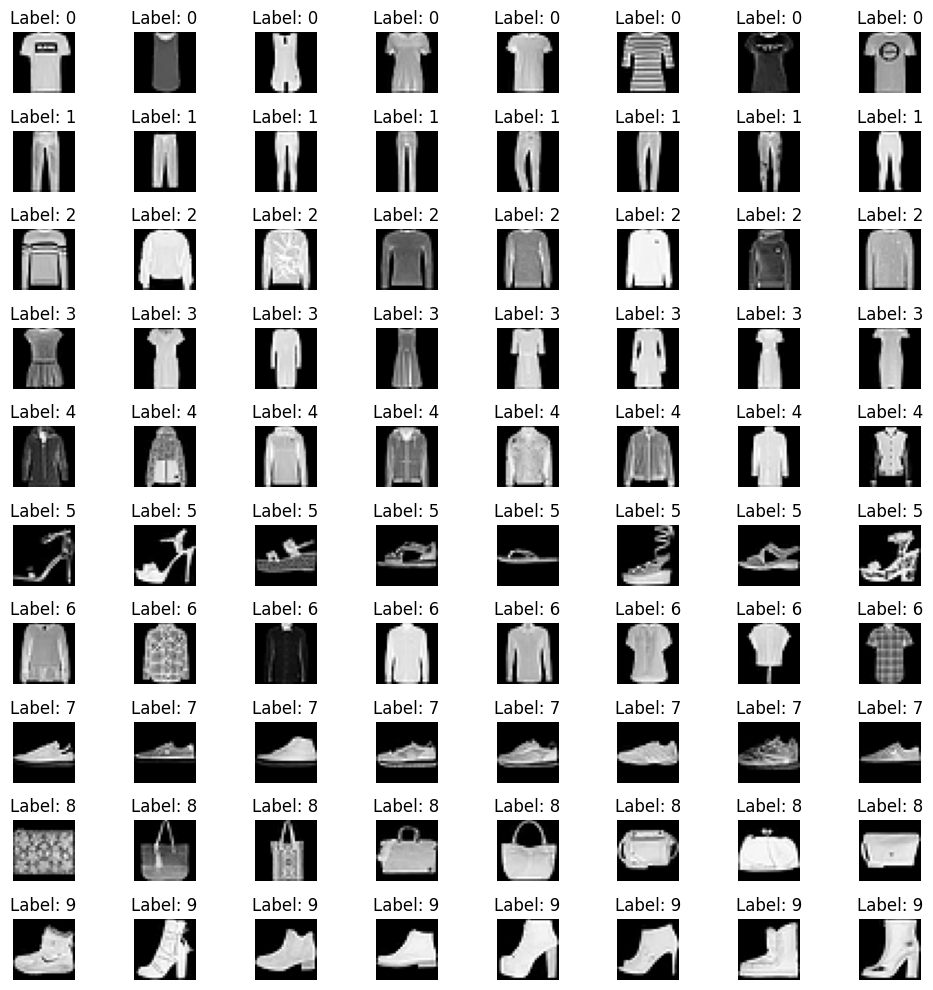

In [ ]:
#Tạo plot hiển thị label theo từng nhãn
def plot_images_per_label(images, labels, num_images_per_label=5):
    unique_labels = np.unique(labels)
    plt.figure(figsize=(10, 10))

    for i, label in enumerate(unique_labels):
        indices = np.where(labels == label)[0][:num_images_per_label]

        for j, idx in enumerate(indices):
            plt.subplot(len(unique_labels), num_images_per_label, i * num_images_per_label + j + 1)
            plt.imshow(images[idx], cmap='gray')
            plt.axis('off')
            plt.title(f'Label: {label}')
    plt.tight_layout()
    plt.show()

plot_images_per_label(X_train, y_train, num_images_per_label=8)


### **Chuẩn Hóa Dữ Liệu (Normalization)**

Các pixel của hình ảnh nằm trong khoảng giá trị từ 0 đến 255. Để quá trình học của mô hình hiệu quả hơn và tránh việc các giá trị lớn ảnh hưởng hiệu suất model, ta sẽ đưa dữ liệu từ [0, 255] -> [0 , 1]


In [3]:
print("Min pixel Train :", X_train.min())
print("Min pixel Train :", X_train.max())
print("Min pixel Test :", X_train.min())
print("Max pixel Test :", X_train.max())

Min pixel Train : 0
Min pixel Train : 255
Min pixel Test : 0
Max pixel Test : 255


In [ ]:
X_train_normalized = X_train / 255.0
X_test_normalized = X_test / 255.0
print("Min sau chuẩn hóa Train :", X_train_normalized.min())
print("Max sau chuẩn hóa Train :", X_train_normalized.max())
print("Min sau chuẩn hóa Test :", X_test_normalized.min())
print("Max sau chuẩn hóa Test :", X_test_normalized.max())


Min sau chuẩn hóa Train : 0.0
Max sau chuẩn hóa Train : 1.0
Min sau chuẩn hóa Test : 0.0
Max sau chuẩn hóa Test : 1.0


### **Làm phẳng**

Làm phẳng (flattening) các mảng dữ liệu hình ảnh, từ dạng **ma trận 2D** thành **vector 1D**. Điều này thường cần thiết trong các mô hình học máy hoặc deep learning (LR, SVM,...) vì yêu cầu đầu vào là **vector 1D**.

In [5]:
X_train_flat = X_train_normalized.reshape(-1, 28*28)
X_test_flat = X_test_normalized.reshape(-1, 28*28)

In [6]:
X_test_flat
X_train_flat

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

### **Kiểm tra phân bố của dữ liệu**

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def count_label(labels,set):
    unique, counts = np.unique(labels, return_counts=True)
    class_distribution = dict(zip(unique, counts))

    print(f"Số lượng mẫu cho mỗi nhãn của tập {set}:")
    for label, count in class_distribution.items():
        print(f"Nhãn {label}: {count} mẫu")

    plt.figure(figsize=(10, 6))
    sns.barplot(x=list(class_distribution.keys()), y=list(class_distribution.values()), hue=list(class_distribution.keys()),legend=False)
    plt.title('Class Distribution in Fashion-MNIST')
    plt.xlabel('Classes')
    plt.ylabel('Number of Samples')
    plt.xticks(ticks=np.arange(10), labels=[
        'T-shirt/top', 'Trouser', 'Pullover', 'Dress', 'Coat',
        'Sandal', 'Shirt', 'Sneaker', 'Bag', 'Ankle boot'
    ], rotation=45)
    plt.legend([], [], frameon=False)
    plt.show()


Số lượng mẫu cho mỗi nhãn của tập train:
Nhãn 0: 6000 mẫu
Nhãn 1: 6000 mẫu
Nhãn 2: 6000 mẫu
Nhãn 3: 6000 mẫu
Nhãn 4: 6000 mẫu
Nhãn 5: 6000 mẫu
Nhãn 6: 6000 mẫu
Nhãn 7: 6000 mẫu
Nhãn 8: 6000 mẫu
Nhãn 9: 6000 mẫu


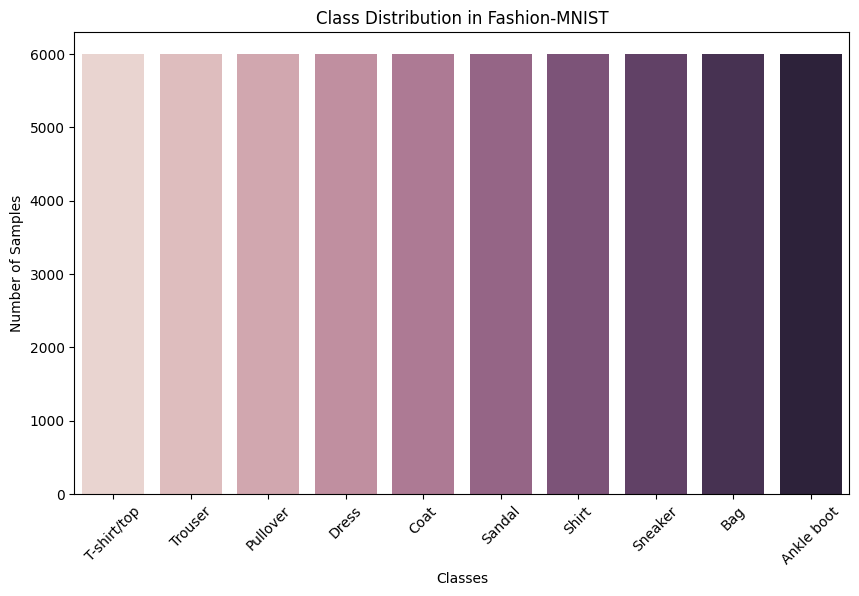

Số lượng mẫu cho mỗi nhãn của tập test:
Nhãn 0: 1000 mẫu
Nhãn 1: 1000 mẫu
Nhãn 2: 1000 mẫu
Nhãn 3: 1000 mẫu
Nhãn 4: 1000 mẫu
Nhãn 5: 1000 mẫu
Nhãn 6: 1000 mẫu
Nhãn 7: 1000 mẫu
Nhãn 8: 1000 mẫu
Nhãn 9: 1000 mẫu


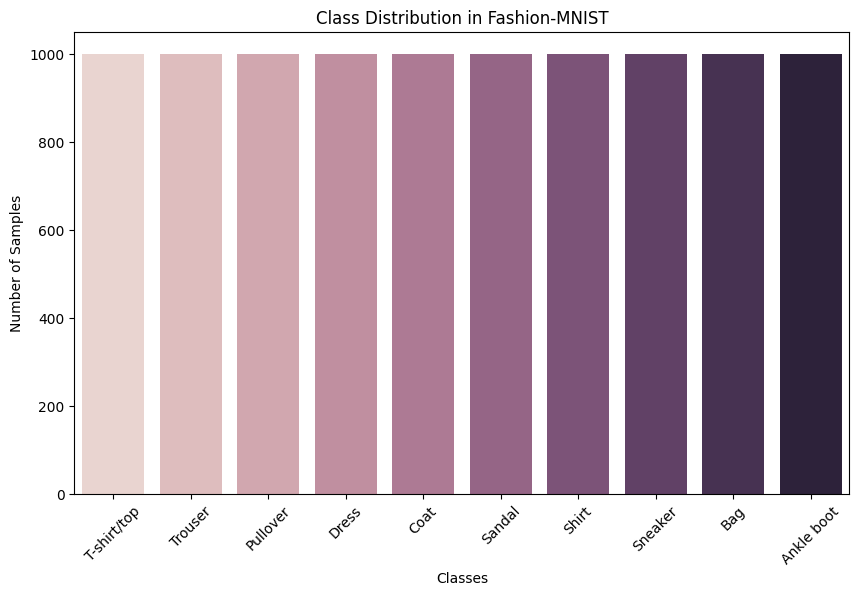

In [ ]:
count_label(y_train,"train")
count_label(y_test,"test")

**=> Không xuất hiện imbalance trong bộ data**

### Nhận định về sample size

### Xác định Kích Thước Mẫu Tối Ưu Cho Tập Huấn Luyện

Nhận thấy rằng kích thước mẫu hiện tại còn khá lớn, nhóm đã quyết định thiết kế một phương pháp để xác định lượng mẫu tối ưu cho tập huấn luyện. Cụ thể, chúng tôi sẽ áp dụng phương pháp **Cross Validation** cho từng kích thước mẫu từ **10,000** đến **40,000**.

### Mục tiêu:
- Tìm ra kích thước mẫu tối ưu bằng cách đánh giá hiệu suất của mô hình qua từng lần phân chia mẫu.
- Sử dụng kết quả từ Cross Validation để hỗ trợ cho quá trình tinh chỉnh và đánh giá được trade off giữa sample size - accuracy - time. Từ đó tạo tiền đề cho việc tìm ra kích thước mẫu tối ưu để tìm tham số tối ưu cho model

Việc tìm kiếm kích thước mẫu tối ưu không chỉ giúp cải thiện hiệu suất của mô hình mà còn tối ưu hóa thời gian huấn luyện, từ đó nâng cao hiệu quả của các nghiên cứu và ứng dụng thực tế.


**Nhưng để đảm bảo hiệu suất, nhóm quyết định khi train model thì vẫn sẽ dùng 60000 sample, còn việc undersampling sẽ dùng cho phần tuning và plot các biểu đồ cần thiết ( Vì có 1 số biểu đồ yêu cầu chi phí tính toán cao -> việc dùng undersampling để plot sẽ giúp nhóm có cái nhìn tổng quan hơn về dữ liệu)**

## **02. Dimensionality Reduction**

### **Discuss the concept of the curse of dimensionality and its impact on machine learning models, particularly in high-dimensional feature spaces.**

Khái niệm **Curse of Dimensionality**:
    Lời nguyền chiều dữ liệu là một hiện tượng xảy ra khi số lượng chiều (features) của dữ liệu tăng theo cấp số nhân, dẫn đến việc phân tích, xử lý và huấn luyện mô hình máy học trở nên phức tạp và ít hiệu quả hơn.

Tác động của **Curse of Dimensionality** đến các mô hình máy học:

**1. Sự thưa thớt của dữ liệu**:
  - Khi số chiều tăng lên, không gian trở nên rất lớn, dẫn đến tình trạng "thưa thớt" của các điểm dữ liệu, và lượng dữ liệu cần thiết để phủ kín không gian tăng lên theo cấp số nhân.
  - Có thể gây khó khăn cho các thuật toán trong việc nhận diện mẫu và quan hệ giữa các điểm dữ liệu, đặc biệt trong thuật toán phân cụm (K-Means) và phân loại.

**2. Tăng cường tính toán**: khi số chiều càng nhiều, khối lượng tính toán tính toán và yêu cầu về bộ nhớ, thời gian xử lý tăng theo cấp số nhân, sẽ gây khó khăn và tiêu hao nhiều tài nguyên.

**3. Overfitting**:
  - Với các chiều cao hơn, mô hình có xu hướng khớp với nhiễu (noise) thay vì mẫu cơ bản. Điều này làm giảm khả năng khái quát của mô hình đối với dữ liệu mới. Mô hình có thể ghi nhớ toàn bộ dữ liệu nhưng lại hoạt động kém khi áp dụng vào dữ liệu chưa từng thấy. Cách để giảm thiểu là sử dụng PCA hoặc Regularization.

**4. Hiện tượng "Concentration of Measure"**:
  - Hiện tượng này xảy ra khi phần lớn các điểm dữ liệu có xu hướng trở nên cách xa trung tâm và tập trung gần biên của không gian nhiều chiều khi số chiều tăng lên. Điều này khiến các mô hình bị sai lệch vì chúng sẽ có xu hướng phân biệt dữ liệu ở biên thay vì ở trung tâm, làm giảm độ chính xác và hiệu quả.

**5. Mất ý nghĩa khoảng cách**:
  - Khi số chiều tăng, khoảng cách giữa các điểm dữ liệu trong không gian gần như tương đương, dù ở xa hay gần đều có khoảng cách tương đối giống nhau do không gian bị phân tán quá mức.
  - Do đó, các thuật toán phụ thuộc vào khoảng cách như KNN, Euclid sẽ mất đi ý nghĩa và giảm độ chính xác trong việc đánh giá sự khác biệt giữa các điểm dữ liệu.

**6. Khó khăn trong visualization**:
  - Việc trực quan hóa dữ liệu nhiều chiều trở nên cực kì phức tạp. Chúng ta có thể hình dung tốt trong không gian 2 hoặc 3 chiều, trong khi dữ liệu máy học có hàng chục, hàng trăm chiều.
  - Điều này sẽ gây khó khăn trong việc khám phá, phân tích, làm mất khả năng phát hiện trực quan các mẫu và xu hướng tiềm ẩn.

### **2.1 Principal Component Analysis (PCA)**

**Vấn đề xảy ra khi tiến hành plot, cụ thể với số lượng sample là 60k khi chạy code đã bị crash vì tràn ram. Vì thế nhóm sẽ có 1 bước undersampling nhưng vẫn giữ được sự cân bằng của dữ liệu để tiền hành plot với 10k sample.**

<ipython-input-12-55d268de8fae>:16: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  X_train_small = xtrn_ytrn_data.groupby('class').apply(lambda x: x.sample(samples_per_class)).sample(frac=1, random_state=42).reset_index(drop=True)


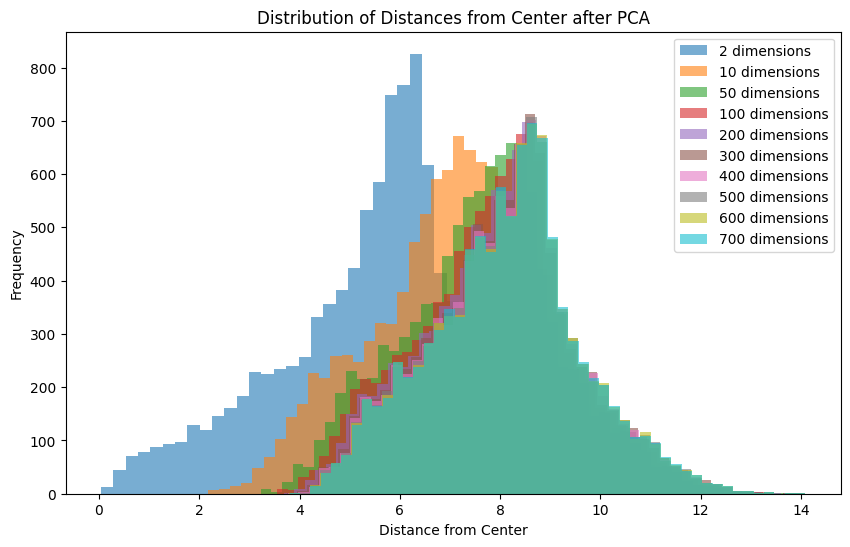

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import pandas as pd

plt.figure(figsize=(10, 6), facecolor='white')
dimensions_list = [2, 10, 50, 100, 200, 300, 400, 500, 600, 700]

xtrn_ytrn_data = pd.DataFrame(data=X_train_flat)
xtrn_ytrn_data['class'] = y_train

# Tạo tập con nhỏ cho training với 10,000 mẫu từ mỗi lớp
total_samples = 10000
samples_per_class = total_samples // 10

X_train_small = xtrn_ytrn_data.groupby('class').apply(lambda x: x.sample(samples_per_class)).sample(frac=1, random_state=42).reset_index(drop=True)
y_train_small = X_train_small['class'].values
X_train_small = X_train_small.drop(columns='class').values

all_distances = []
for dim in dimensions_list:
    # Khởi tạo và áp dụng PCA với số chiều lần lượt trong list
    pca = PCA(n_components=dim)
    X_train_pca = pca.fit_transform(X_train_small)

    # Tính khoảng cách từ gốc tọa độ đến từng điểm
    distances = np.linalg.norm(X_train_pca, axis=1)
    all_distances.extend(distances)

    # Vẽ biểu đồ cho khoảng cách từ gốc tọa độ
    plt.hist(distances, bins=50, alpha=0.6, label=f'{dim} dimensions')

plt.title('Distribution of Distances from Center after PCA')
plt.xlabel('Distance from Center')
plt.ylabel('Frequency')
plt.legend()
plt.show()


Biểu đồ trên minh họa hiện tượng **"Concentration of Measure"**, so sánh sự phân tán của dữ liệu sau khi áp dụng PCA. Các đường phân phối có sự thay đổi rõ rệt giữa các số chiều khác nhau:
  - Với số chiều thấp (2, 10, 50) dữ liệu tập trung gần gốc hơn, tức là dữ liệu sau khi giảm chiều không còn giữ được nhiều thông tin.
  - Khi số chiều tăng từ 100 lên 700, khoảng cách từ gốc có xu hướng tập trung nhiều hơn trong một khoảng hẹp hơn, thể hiện rõ hiện tượng **"Concentration of Measure"**. Các đường phân phối có xu hướng dịch chuyển sang phải, nghĩa là khoảng cách trung bình từ tâm trở nên xa hơn.
  - Có thể thấy rằng từ 100 chiều trở lên, sự khác biệt về phân bố khoảng cách không còn quá rõ rệt, cho thấy số chiều này đủ để giữ lại phần lớn thông tin.

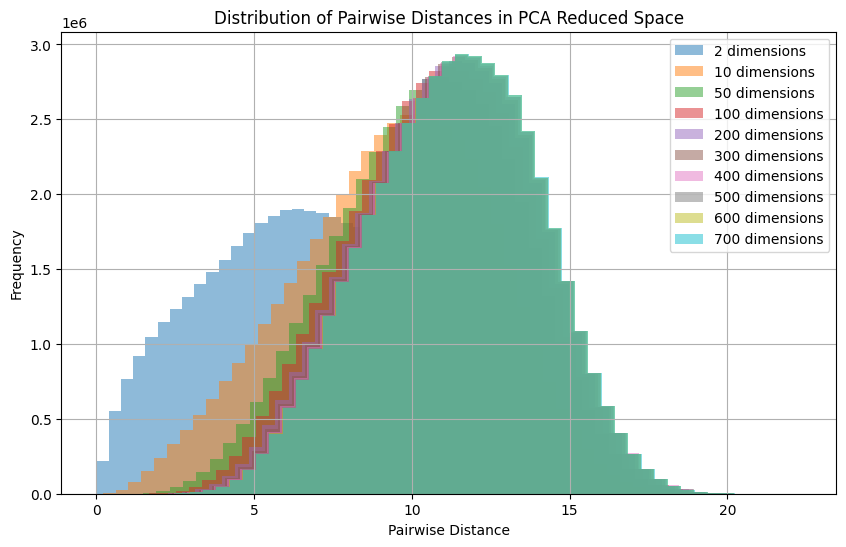

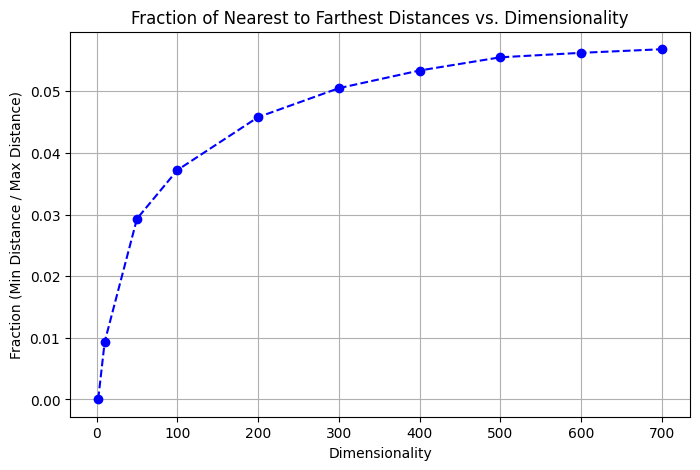

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from scipy.spatial.distance import pdist
import pandas as pd

# Giả sử X_train_small đã được định nghĩa
dimensions_list = [2, 10, 50, 100, 200, 300, 400, 500, 600, 700]
all_distances = []
fraction_list = []  # Danh sách để lưu trữ tỷ lệ min_distance / max_distance

plt.figure(figsize=(10, 6))

# Vòng lặp qua các kích thước chiều
for dim in dimensions_list:
    pca = PCA(n_components=dim)
    X_train_pca = pca.fit_transform(X_train_small)  # Giả sử X_train_flat đã được định nghĩa

    # Tính khoảng cách cặp đôi giữa các điểm
    distances = pdist(X_train_pca, metric='euclidean')
    all_distances.append(distances)  # Lưu trữ khoảng cách để sử dụng sau này

    # Tính min_distance và max_distance
    min_distance = np.min(distances)
    max_distance = np.max(distances)

    # Tính tỷ lệ min_distance / max_distance
    fraction = min_distance / max_distance
    fraction_list.append(fraction)

    # Vẽ histogram cho khoảng cách cặp đôi
    plt.hist(distances, bins=50, alpha=0.5, label=f'{dim} dimensions')

plt.title('Distribution of Pairwise Distances in PCA Reduced Space')
plt.xlabel('Pairwise Distance')
plt.ylabel('Frequency')
plt.legend()
plt.grid(True)
plt.show()

# Vẽ tỷ lệ min_distance / max_distance theo số chiều
plt.figure(figsize=(8, 5))
plt.plot(dimensions_list, fraction_list, marker='o', linestyle='--', color='b')
plt.title('Fraction of Nearest to Farthest Distances vs. Dimensionality')
plt.xlabel('Dimensionality')
plt.ylabel('Fraction (Min Distance / Max Distance)')
plt.grid(True)
plt.show()


Biểu đồ Pairwise Distance

- **Xu hướng phân phối**:
   - Khi số chiều tăng lên, các khoảng cách từng cặp có xu hướng tăng dần. Ở 2 chiều, các giá trị khoảng cách chủ yếu dao động ở mức thấp. Khi số chiều tăng lên (ví dụ: 700 chiều), phân phối dần chuyển dịch sang bên phải, với các khoảng cách lớn hơn.

- **Độ lệch chuẩn và khoảng cách trung bình**:
   - Ở chiều cao (như 700 chiều), phân phối trở nên rộng hơn và có độ lệch chuẩn lớn hơn, cho thấy sự phân tán của các khoảng cách lớn hơn. Điều này phản ánh rằng khi số chiều tăng lên, không gian vector trải dài ra và các điểm dữ liệu trở nên “xa” nhau hơn trong không gian cao chiều.

- **Hiệu ứng ‘Curse of Dimensionality’**:
   - Khi tăng số chiều, các khoảng cách trở nên ít ý nghĩa hơn, vì tất cả các điểm trong không gian cao chiều thường trở nên cách nhau gần như đều đặn. Điều này khiến cho việc phân cụm hoặc phân loại trở nên khó khăn hơn khi làm việc trong không gian cao chiều.


Biểu đồ Fraction of Nearest to Farthest Distances vs. Dimensionality

- **Xu hướng tăng dần**: Tỷ lệ giữa khoảng cách gần nhất và xa nhất tăng dần khi số chiều tăng lên. Điều này cho thấy rằng khi số chiều tăng, khoảng cách giữa các điểm gần nhất và xa nhất dần trở nên nhỏ lại so với nhau, mặc dù khoảng cách tuyệt đối vẫn tăng.

- **Hiện tượng "Curse of Dimensionality"**: Biểu đồ này minh họa hiện tượng "lời nguyền chiều" (curse of dimensionality), trong đó khi số chiều tăng, các điểm dữ liệu trở nên dàn đều nhau hơn trong không gian. Điều này dẫn đến khoảng cách giữa các điểm gần nhất và xa nhất dần hội tụ lại, tức là tỷ lệ khoảng cách gần nhất/xa nhất tiến đến một giá trị nhỏ và ổn định.

- **Giá trị ổn định**: Từ khoảng 500 chiều trở lên, tỷ lệ này dần ổn định quanh một giá trị, cho thấy tác động của việc tăng số chiều trở nên không đáng kể khi số chiều đủ lớn.

Biểu đồ này cho thấy trong các không gian có số chiều cao, việc phân biệt các điểm gần nhau trở nên khó khăn hơn, điều này có thể ảnh hưởng đến độ chính xác của các mô hình phân loại trong các không gian nhiều chiều như Fashion MNIST.


Giải thích cho phân bố bất thường của dữ liệu thông qua các plot về distribution

- **Ta có thể thấy rằng 2 biểu đồ về distribution có phân bố khi giảm chiều khá là gần gần nhau chứ không có sự thay đổi rõ ràng, để giải thích cho hiện tượng này thì nhóm đã khám phá được rằng: Ở các bức ảnh có các pixel 0 (Từ background) gây nhiễu, vì thế nên khi ta tiến hành giảm số chiều xuống, thì phân bố 2 biểu đồ có thể sẽ không thay đổi nhiều.**
- **Điều này có nghĩa là, vật thể chúng ta đang detect được giữ lại thông tin ở không gian ít chiều hơn là khi cán phẳng hình ảnh ra 784 chiều bởi vì các thông tin từ background không mang nhiều ý nghĩa để tiền hành phân loại**

Pixel values of the first image:
 [0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.00392157 0.        

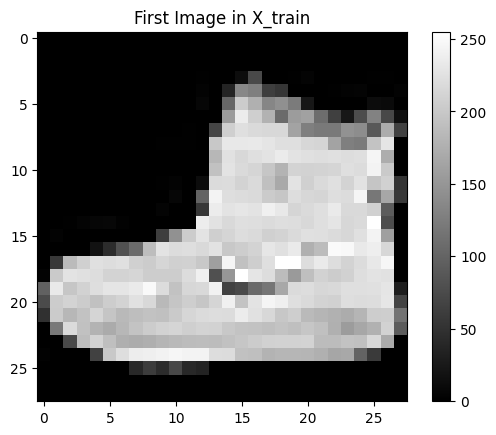

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
np.set_printoptions(threshold=np.inf)


# Lấy hình đầu tiên từ X_train
image = X_train[0]

# In ra mảng các pixel
print("Pixel values of the first image:\n", X_train_flat[0])

# Hiển thị hình ảnh
plt.imshow(image, cmap='gray')
plt.title("First Image in X_train")
plt.colorbar()
plt.show()


**Hình ảnh chiếc giày boot trên giúp minh họa rằng dữ liệu trong bộ data chứa nhiều điểm ảnh nền (background) có pixel bằng 0, và việc giảm chiều với PCA đã loại bỏ phần lớn thông tin từ nền để tập trung vào những đặc trưng của đối tượng chính, dẫn đến sự ổn định và tương đồng của các phân bố khi thay đổi chiều.**

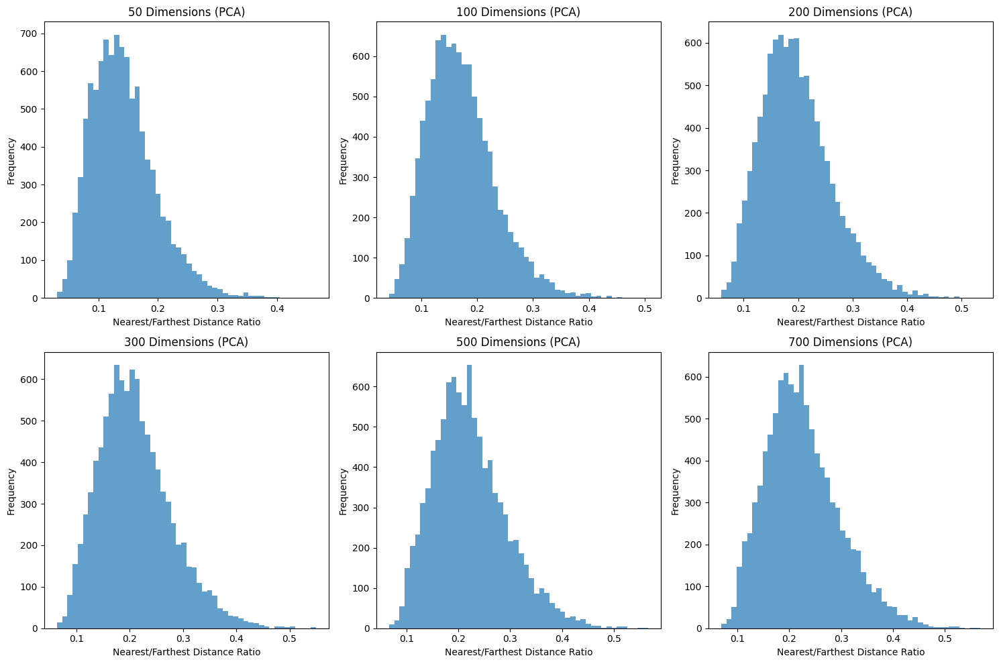

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

random_dimensions_list = [50, 100, 200,300,500,700]


fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 10))
axes = axes.ravel()

for i, dim in enumerate(random_dimensions_list):
    # Áp dụng PCA để giảm số chiều xuống dim
    pca = PCA(n_components=dim)
    points = pca.fit_transform(X_train_small)

    distance_matrix = cdist(points, points)

    # Loại bỏ khoảng cách tự thân bằng cách đánh dấu đường chéo bằng NaN
    np.fill_diagonal(distance_matrix, np.nan)

    # Đối với mỗi điểm, tìm khoảng cách gần nhất và xa nhất, loại trừ khoảng cách tự thân
    nearest_distances = np.nanmin(distance_matrix, axis=1)  # Khoảng cách nhỏ nhất không phải tự thân
    farthest_distances = np.nanmax(distance_matrix, axis=1)  # Khoảng cách lớn nhất không phải tự thân

    # Tính tỷ lệ giữa khoảng cách gần nhất và xa nhất cho mỗi điểm
    ratios = nearest_distances / (farthest_distances + 1e-10)  # Thêm một epsilon nhỏ

    # Vẽ histogram của các tỷ lệ này trong subplot tương ứng
    axes[i].hist(ratios, bins=50, alpha=0.7)
    axes[i].set_title(f'{dim} Dimensions (PCA)')
    axes[i].set_xlabel('Nearest/Farthest Distance Ratio')
    axes[i].set_ylabel('Frequency')

# Điều chỉnh bố cục để tránh chồng chéo
plt.tight_layout()
plt.show()


- Khi số chiều tăng, các khoảng cách giữa các điểm trong không gian thường trở nên ít phân biệt hơn(gần hơn).
- Điều này thể hiện qua sự tập trung của các giá trị tỷ lệ xung quanh một khoảng hẹp khi số chiều tăng, vì khi có nhiều chiều hơn, khoảng cách gần nhất và xa nhất có xu hướng “hội tụ” lại, làm giảm ý nghĩa của các khoảng cách trong không gian.

In [ ]:
import plotly.express as px
import pandas as pd
import plotly.io as pio
from sklearn.decomposition import PCA

pca = PCA(n_components=3)
X_pca_plot = pca.fit_transform(X_train_flat)

pca_df = pd.DataFrame({
    'Principal Component 1': X_pca_plot[:, 0],
    'Principal Component 2': X_pca_plot[:, 1],
    'Principal Component 3': X_pca_plot[:, 2],
    'Class': y_train
})

# Vẽ biểu đồ phân tán 3D theo từng lớp
fig_3d = px.scatter_3d(
    pca_df,
    x='Principal Component 1',
    y='Principal Component 2',
    z='Principal Component 3',
    color='Class',
    title='PCA 3D Scatter Plot by Class',
    labels={
        'Principal Component 1': 'Principal Component 1',
        'Principal Component 2': 'Principal Component 2',
        'Principal Component 3': 'Principal Component 3'
    },
    opacity=0.7
)

# Vẽ biểu đồ phân tán 2D (sử dụng hai thành phần chính đầu tiên)
fig_2d = px.scatter(
    pca_df,
    x='Principal Component 1',
    y='Principal Component 2',
    color='Class',
    title='PCA 2D Scatter Plot by Class',
    labels={
        'Principal Component 1': 'Principal Component 1',
        'Principal Component 2': 'Principal Component 2'
    },
    opacity=0.7
)

pio.renderers.default = "vscode" 
fig_2d.show()
fig_3d.show()


**Trong trường hợp plotly không thể hiện thị, tụi em có chuẩn bị bản dự phòng**

<img src="https://github.com/ThuanLy-0092/NDM/raw/main/pca1.png" alt="My Image" style="width: 700px;"/>


<img src="https://github.com/ThuanLy-0092/NDM/raw/main/pca2%20(2).png" alt="My Image" style="width: 700px;"/>


**PCA 2D Scatter Plot**
* Biểu đồ 2D sử dụng 2 thành phần chính đầu tiên để biểu diễn dữ liệu.
* Ta thấy, một số ít lớp (được phân biệt bằng màu sắc) có sự phân biệt tương đối rõ ràng, trong khi những lớp khác có phần chồng lấn. Điều này cho thấy một vài đặc trưng của dữ liệu là tương đồng giữa các lớp, khiến chúng không hoàn toàn phân tách rõ rệt.

**PCA 3D Scatter Plot**
* Biểu diễn với 3 thành phần chính giúp bổ sung thêm một chiều thông tin so với 2D, cho phép thấy rõ hơn sự phân bố của dữ liệu trong không gian đa chiều.
* Một số lớp được tách biệt tốt hơn trong biểu đồ 3D so với 2D, nhưng vẫn có sự chồng chéo nhất định, đặc biệt là ở trung tâm của các nhóm dữ liệu.
* Biểu đồ 3D cho thấy dữ liệu không thể dễ dàng tách biệt chỉ bằng các mặt phẳng đơn giản, điều này ngụ ý rằng bài toán phân loại trên tập dữ liệu này có thể yêu cầu các thuật toán phức tạp hơn như SVM, mạng nơ-ron, hoặc các mô hình phi tuyến tính.

**Phương sai giải thích** cho biết mức độ thông tin từ dữ liệu gốc mà mỗi thành phần chính có thể nắm bắt được. Thành phần có phương sai giải thích **càng cao càng quan trọng**, bởi vì nó thể hiện khả năng nắm bắt và mô tả nhiều đặc trưng quan trọng của dữ liệu.

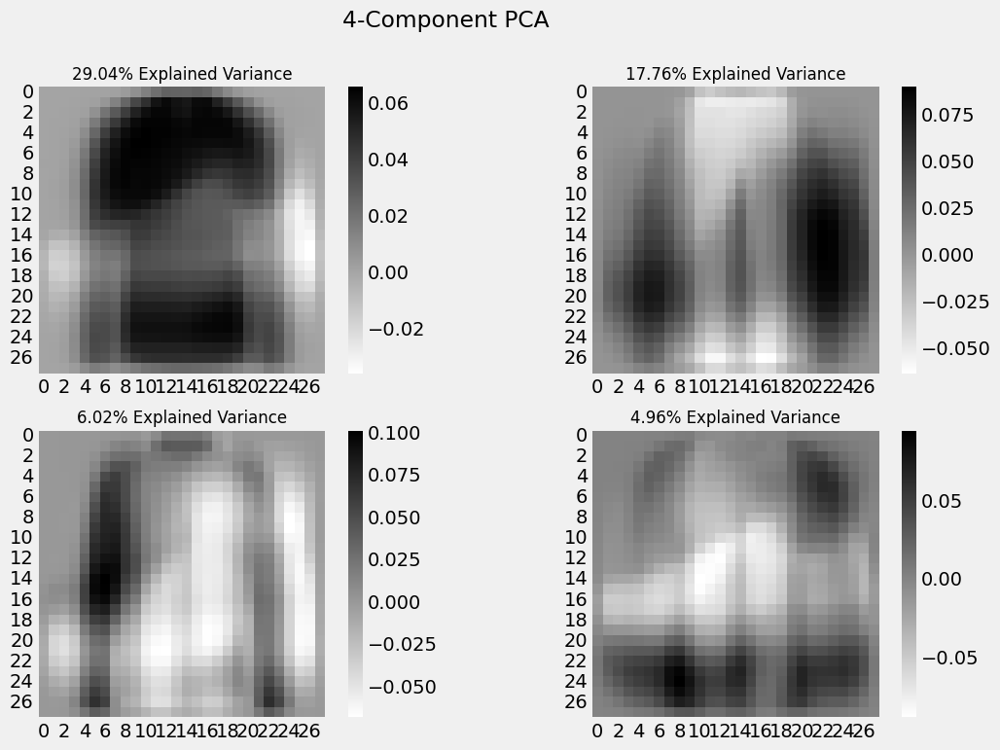

In [ ]:
# Khởi tạo PCA với 4 thành phần chính
PCA_4_com = PCA(n_components=4)
PCA_4_com.fit(X_train_flat).transform(X_train_flat)

plt.style.use('fivethirtyeight')
fig, axarr = plt.subplots(2, 2, figsize=(12, 8))

# Lặp qua các thành phần PCA và vẽ heatmap
for i, ax in enumerate(axarr.flat):
    sns.heatmap(PCA_4_com.components_[i, :].reshape(28, 28), ax=ax, cmap='gray_r')
    ax.set_title("{0:.2f}% Explained Variance".format(PCA_4_com.explained_variance_ratio_[i] * 100), fontsize=12)
    ax.set_aspect('equal')

plt.suptitle('4-Component PCA')
plt.show()

Kết quả PCA trên với 4 thành phần chính:
* Thành phần đầu tiên **29.04%** phương sai, cho thấy nó đóng góp phần lớn vào việc nắm bắt sự biến thiên của dữ liệu. Đây là thành phần quan trọng nhất, mang nhiều thông tin về đặc trưng chung của tập dữ liệu. (Có vẻ như là một loại trang phục hoặc vật dụng có kích cỡ lớn (ví dụ: áo thun hoặc áo tay dài), thay vì những phụ kiện nhỏ như giày dép.)

* Thành phần thứ hai nắm giữ **17.76%** phương sai, bổ sung thêm thông tin quan trọng về sự biến thiên của dữ liệu, nhưng ít hơn so với thành phần đầu tiên. (Trông như phản ánh phần không gian trống xung quanh một cái quần hoặc trang phục hẹp. Các khoảng sáng ở giữa cho thấy khoảng cách giữa các bộ phận chính của vật thể, chẳng hạn như hai ống quần.)

* Thành phần thứ ba (**6.02%** phương sai) và thứ tư (**4.96%** phương sai): Các thành phần này giải thích ít phương sai hơn, tập trung vào các chi tiết nhỏ hoặc các biến thể không phổ biến, mang đến những đặc trưng phụ hoặc nhiễu. (Thành phần thứ ba có vẻ như liên quan đến một phần của giày hoặc một phụ kiện nhỏ hơn, trông bao quát hơn nữa thì cũng có thể thấy nó giống như một cái áo thân màu trắng và tay áo màu đậm. Ngoài ra thành phần thứ tư tiếp tục thể hiện các đặc điểm gắn với một loại phụ kiện nhỏ hoặc giày dép. Vùng sáng nằm ở giữa hình ảnh cho thấy cấu trúc có thể là một phần lưỡi giày hoặc quai giày.)

Tổng phương sai giải thích của 4 thành phần đầu tiên là **57.78%**, có nghĩa là hơn một nửa lượng thông tin của dữ liệu gốc đã được giữ lại chỉ bằng 4 thành phần này. Việc phân tích này cho thấy PCA đã phân rã dữ liệu thành các lớp đặc điểm khác nhau, từ trang phục lớn đến chi tiết nhỏ như giày dép. Mỗi chiều bổ sung chúng ta thêm vào PCA sẽ nắm bắt ít biến thể hơn trong mô hình.

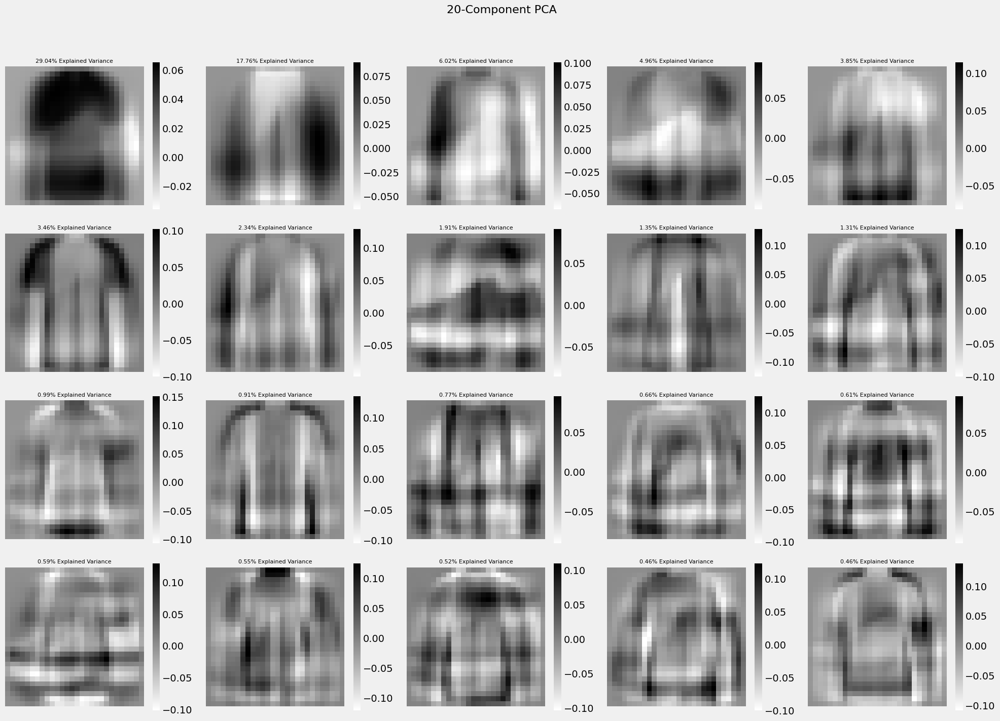

In [ ]:
# Khởi tạo PCA với 100 thành phần
PCA_100_com = PCA(n_components=100)
PCA_100_com.fit(X_train_flat)

plt.style.use('fivethirtyeight')
fig, axarr = plt.subplots(4, 5, figsize=(20, 15))  # Tạo lưới 4x5 để hiển thị 20 thành phần đầu tiên

# Lặp qua 20 thành phần đầu tiên của PCA và vẽ heatmap
for i, ax in enumerate(axarr.flat[:20]):
    sns.heatmap(PCA_100_com.components_[i].reshape(28, 28), ax=ax, cmap='gray_r')
    ax.set_title("{0:.2f}% Explained Variance".format(PCA_100_com.explained_variance_ratio_[i] * 100), fontsize=8)
    ax.set_aspect('equal')
    ax.axis('off')

plt.suptitle('20-Component PCA', fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

Nếu sử dụng nhiều hơn 4 thành phần, chẳng hạn như 100 thành phần, mỗi thành phần bổ sung sẽ giải thích thêm một phần rất nhỏ của phương sai (thường **dưới 4%**). Các thành phần này thường đại diện cho những chi tiết tinh tế hoặc nhiễu trong dữ liệu, chẳng hạn như hoa văn nhỏ, phụ kiện hoặc nếp gấp không đáng kể. Tuy việc tăng số thành phần giúp giữ lại gần như toàn bộ thông tin (gần 100% phương sai), nhưng đồng thời cũng làm tăng độ phức tạp và khiến quá trình tính toán trở nên tốn kém hơn.

In [11]:
# Khởi tạo PCA và áp dụng lên dữ liệu
pca = PCA(n_components=700)
X_pca = pca.fit_transform(X_train_flat)

# Tạo DataFrame tính tỷ lệ phương sai tích lũy và giá trị riêng
pca_df = pd.DataFrame({
    'n_components': range(1, len(pca.explained_variance_) + 1),
    'Cumulative Variance': np.cumsum(pca.explained_variance_ratio_),
    'Eigen Value': pca.explained_variance_
})

# Vẽ biểu đồ giá trị riêng (Eigen Value)
fig_eigen = px.line(
    pca_df,
    x='n_components',
    y='Eigen Value',
    title='Eigen Values by Number of Principal Components',
    labels={
        'n_components': 'Number of components',
        'Eigen Value': 'Eigen Value'
    }
)
fig_eigen.update_traces(line=dict(color='violet', width=3))
fig_eigen.update_layout(
    title_font=dict(size=20, family='Arial', color='black'),
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
    width=800,
    height=500
)
fig_eigen.show()

# Vẽ biểu đồ tỷ lệ phương sai tích lũy
fig = px.line(
    pca_df,
    x='n_components',
    y='Cumulative Variance',
    title='Cumulative Explained Variance by Number of Principal Components',
    labels={
        'n_components': 'Number of components',
        'Cumulative Variance': 'Cumulative variance ratio'
    }
)
fig.update_traces(line=dict(color='violet', width=3))
fig.update_layout(
    title_font=dict(size=20, family='Arial', color='black'),
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
    width=800,
    height=500
)
fig.show()


**Trong trường hợp plotly không hiển thị, nhóm em có chuẩn bị bản dự phòng cho plot**

<img src="https://github.com/ThuanLy-0092/NDM/raw/main/pca3.png" alt="My Image" style="width: 700px;"/>


<img src="https://github.com/ThuanLy-0092/NDM/raw/main/pca3.png" alt="My Image" style="width: 700px;"/>


Biểu đồ giúp quyết định **số lượng thành phần chính (components)** cần thiết khi thực hiện PCA.

Ban đầu, đường cong tăng rất nhanh, nhưng dần dần tiến tới bão hòa và có xu hướng nằm ngang. Điều này cho thấy rằng việc thêm các thành phần chính sau một điểm nào đó sẽ không còn giúp ích nhiều trong việc giải thích thêm phương sai.
- 50 components: phương sai tích lũy đạt khoảng 85%
- 100 components: phương sai tích lũy đạt khoảng 90%.
- 200 components: phương sai tích lũy khoảng 95%
- Từ 200 đến 600 components: phương sai tăng chậm và dần bão hòa, nghĩa là khi chọn thêm thành phần sẽ không cải thiện đáng kể việc giải thích phương sai.

Thay vì sử dụng tất cả các thành phần chính, có thể chọn một lượng ít thành phần (vd: 50, 100, 200) vì chúng đã giải thích được **trên 85%** phương sai của dữ liệu, đảm bảo sự cân bằng giữa việc giữ lại thông tin và giảm chiều dữ liệu.

In [ ]:
def find_number_of_components(X, explained_variance_threshold=None):
    pca = PCA()
    pca.fit(X)

    # Tính tổng phương sai giải thích cộng dồn
    cumulative_explained_variance = np.cumsum(pca.explained_variance_ratio_)

    # Tìm số lượng thành phần cần thiết để đạt ngưỡng phương sai giải thích
    if explained_variance_threshold is not None:
        num_components = np.argmax(cumulative_explained_variance >= explained_variance_threshold) + 1
        return num_components
    else:
        return cumulative_explained_variance

cumulative_explained_variance = find_number_of_components(X_train_flat, explained_variance_threshold=None)

In [ ]:
thresholds = [0.8, 0.85, 0.9, 0.95, 0.99]
threshold_data = []
for threshold in thresholds:
    num_components = np.argmax(cumulative_explained_variance >= threshold) + 1
    threshold_data.append([threshold * 100, num_components])

threshold_df = pd.DataFrame(threshold_data, columns=['Tỷ lệ phương sai (%)', 'Số lượng thành phần cần thiết'])
print(threshold_df)

   Tỷ lệ phương sai (%)  Số lượng thành phần cần thiết
0                  80.0                             24
1                  85.0                             43
2                  90.0                             84
3                  95.0                            187
4                  99.0                            459


In [ ]:
# Áp dụng PCA để giảm chiều dữ liệu xuống 187 thành phần
num_components_95 = np.argmax(cumulative_explained_variance >= 0.95) + 1
pca_187 = PCA(n_components=num_components_95)
X_train_pca = pca_187.fit_transform(X_train_flat)
X_test_pca = pca_187.transform(X_test_flat)
print(f"Kích thước dữ liệu sau khi giảm chiều: {X_train_pca.shape}")

Kích thước dữ liệu sau khi giảm chiều: (60000, 187)


### **2.2 Linear Discriminant Analysis (LDA)**

#### **Ý tưởng:**
- Làm sao cho **khoảng cách từ mean(X1) đến các điểm khác trong X1 là nhỏ nhất**
- Nhưng cũng phải **đảm bảo khoảng cách từ mean(X1) đến các mean(Xn) là lớn nhất**
> **minimize Within-class distance, maximize Between-class distance**

<img src="https://github.com/ThuanLy-0092/NDM/raw/main/LDA1.png" alt="My Image" style="width: 700px;"/>



- Trong 1 số trường hợp, **khi dùng PCA sẽ cho ra kết quả như đường màu xanh** bên dưới => **các dữ liệu từ các lớp khác nhau bị chồng chéo lên và gây ra vấn đề khó classify**, **vì thế việc sử dụng LDA có thể trở nên cần thiết để chiếu  dữ liệu lên đường màu vàng và hỗ trợ tốt hơn cho việc classify** => Nhóm quyết định **thử cả 2 phương pháp.**

<img src="https://github.com/ThuanLy-0092/NDM/raw/main/LDA2.png" alt="My Image" style="width: 700px;"/>


#### **Công Thức Ma Trận Giữa Các Lớp và Trong Các Lớp**

1. **Ma Trận Giữa Các Lớp \( S_B \)**:
   $$
   S_B = \sum_{i=1}^{c} n_i (\mu_i - \mu)(\mu_i - \mu)^T
   $$
   - c : Số lớp
   - n_i : Số lượng mẫu trong lớp i (Ta lấy n_i làm trọng số vì có thể có những class có nhiều phần tử so với các classes còn lại.)
   - mu_i : Trung bình của lớp i
   - mu : Trung bình tổng thể

2. **Ma Trận Trong Các Lớp \( S_W \)**:
   $$
   S_W = \sum_{i=1}^{c} \sum_{x \in D_i} (x - \mu_i)(x - \mu_i)^T
   $$
   - D_i: Tập dữ liệu của lớp \( i \)
   - x : Điểm dữ liệu trong lớp \( i \)


#### **Hàm Loss trong LDA**

Trong LDA, ta tìm ma trận biến đổi \( W \) sao cho tối đa hóa tỷ lệ giữa ma trận phương sai giữa các lớp \( $S_B$ \) và ma trận phương sai trong các lớp \( $S_W$ \):

$$
W = \text{argmax}_W \, \frac{|W^T S_B W|}{|W^T S_W W|}
$$

Trong đó:
- \( $S_B$ \): Ma trận phương sai giữa các lớp.
- \( $S_W$ \): Ma trận phương sai trong các lớp.
- \( W \): Ma trận biến đổi để tối đa hóa tỷ lệ giữa \( $S_B$ \) và \( $S_W$ \).


#### **Hạng của Ma Trận \( S_B \) trong LDA**

$$
\text{rank}(S_B) \leq C - 1
$$

trong đó  C  là số lớp.

##### **Giải thích**

1. **Ma trận \( $S_B$ \) dựa trên các vector trung bình của các lớp**: Ma trận \( $S_B$ \) được xây dựng từ các vector trung bình của từng lớp, đại diện cho thông tin về khoảng cách giữa các trung bình lớp với nhau.

2. **Hạng tối đa của \( $S_B$ \)**: Vì chỉ có \( C \) vector trung bình lớp, nhưng các vector này chỉ tạo ra tối đa \( C - 1 \) chiều độc lập (do chúng phụ thuộc vào trung bình tổng thể), nên hạng tối đa của \( $S_B$ \) là \( C - 1 \).

Điều này có nghĩa rằng, khi số chiều lớn hơn số lớp \( C \), không gian mà \( $S_B$ \) trải ra sẽ không bao gồm tất cả các chiều, và các chiều dư thừa này sẽ không ảnh hưởng đến \( $S_B$ \).


#### **Giả định của LDA và việc áp dụng với dữ liệu pixel**

LDA đưa ra một số giả định đơn giản hóa về dữ liệu:

1. **Dữ liệu có phân phối chuẩn (Gaussian)**:
   - Nghĩa là khi vẽ đồ thị phân phối của mỗi biến, ta sẽ thấy hình dạng của nó giống như một đường cong chuông.

2. **Phương sai đồng nhất**:
   - Các giá trị của mỗi biến phân bố xung quanh giá trị trung bình với mức độ biến thiên giống nhau.



In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import shapiro, levene


def check_homogeneity(X, y):
    unique_classes = np.unique(y)
    class_data = [X[y == cls] for cls in unique_classes]

    stat, p_value = levene(*class_data)
    return stat, p_value


levene_stat, levene_p = check_homogeneity(X_train_flat, y_train)

if isinstance(levene_stat, np.ndarray) or isinstance(levene_p, np.ndarray):
    levene_stat = levene_stat[0]
    levene_p = levene_p[0]

print(f'\nLevene Test: Statistics={levene_stat:}, p-value={levene_p:}')
if levene_p > 0.05:
    print('    Phương sai đồng nhất (không bác bỏ H0)')
else:
    print('    Không có phương sai đồng nhất (bác bỏ H0)')




Levene Test: Statistics=1.0108687951351432, p-value=0.4283086213483949
    Phương sai đồng nhất (không bác bỏ H0)


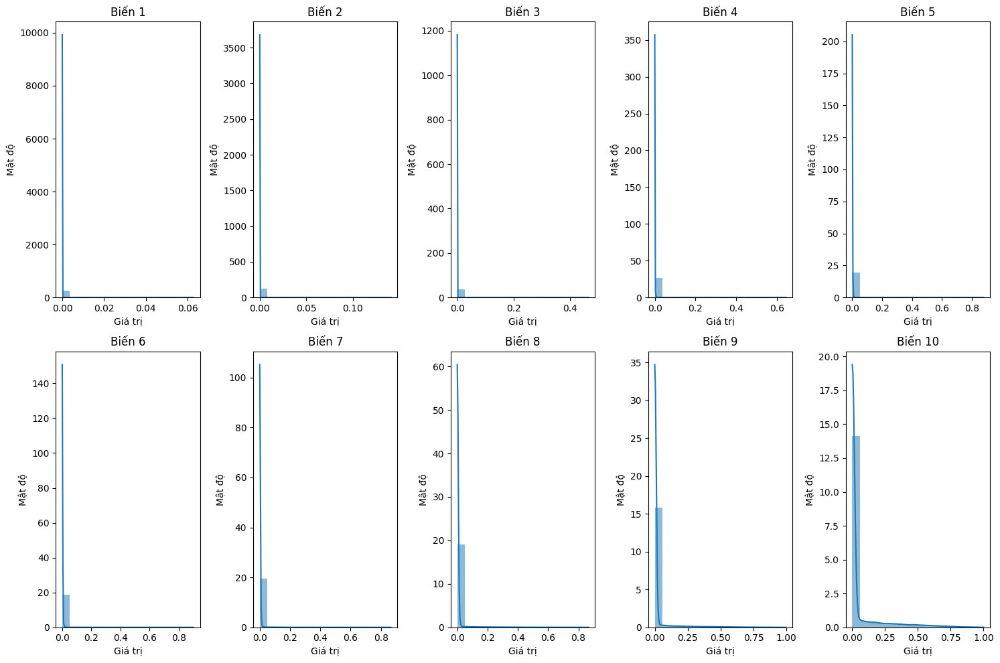

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Chuyển đổi X_train_flat thành DataFrame
X_train_df = pd.DataFrame(X_train_flat)

# Thiết lập kích thước cho các biểu đồ
plt.figure(figsize=(15, 10), facecolor='white')

# Vẽ phân phối cho 10 biến đầu tiên (mỗi cột trong DataFrame)
for i in range(10):  # Chỉ vẽ cho 10 biến đầu tiên
    ax = plt.subplot(2, 5, i + 1)  # 2x5 grid cho 10 biến
    ax.set_facecolor('white')  # Đặt nền trắng cho mỗi biểu đồ con
    sns.histplot(X_train_df.iloc[:, i], kde=True, stat="density", linewidth=0, ax=ax)
    plt.title(f'Biến {i + 1}')
    plt.xlabel('Giá trị')
    plt.ylabel('Mật độ')

plt.tight_layout()
plt.show()


##### **Áp dụng giả định của LDA với dữ liệu pixel**

Với dữ liệu là các pixel ảnh (đã chuyển về dạng 784 chiều), việc thỏa mãn giả định phân phối chuẩn **rất khó đạt được** do đặc tính riêng của dữ liệu hình ảnh. Tuy nhiên, vì **mục tiêu của LDA trong trường hợp này chỉ là giảm chiều dữ liệu** mà vẫn giữ được các đặc trưng riêng để phân loại các lớp, nên chúng ta không cần phải đảm bảo quá chặt chẽ về các giả định này.

Thay vào đó, có thể **ưu tiên khả năng giữ lại thông tin phân loại qua các chiều thấp hơn** là yêu cầu dữ liệu phải hoàn toàn thỏa mãn các giả định trên. Điều này giúp **LDA vẫn có thể mang lại hiệu quả** trong việc giảm chiều và tăng hiệu quả tính toán mà không làm mất đi nhiều đặc trưng quan trọng của dữ liệu.


Nói chung, **việc có "giả định" trong thống kê không có nghĩa là các phương pháp chỉ có thể được áp dụng nếu giả định đúng** (nếu đúng như vậy, thống kê không bao giờ có thể được áp dụng vì "tất cả các mô hình đều sai" - nhưng một số thì hữu ích). **Nó chỉ có nghĩa là có một số lý thuyết toán học nhất định đảm bảo rằng phương pháp có một hoặc nhiều đặc điểm tốt trong trường hợp giả định đúng**. Nó không có nghĩa là phương pháp nhất thiết là tệ nếu giả định không đúng.

In [ ]:
import numpy as np
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

lda = LDA(n_components=9)
X_train_lda = lda.fit_transform(X_train_flat, y_train)
X_test_lda = lda.transform(X_test_flat)


print("Train LDA Shape:", X_train_lda.shape)
print("Test LDA Shape:", X_test_lda.shape)
print("LDA Components:", lda.coef_)
print("LDA Explained Variance Ratio:", lda.explained_variance_ratio_)

Train LDA Shape: (60000, 9)
Test LDA Shape: (10000, 9)
LDA Components: [[-26.67080028   6.15509083  38.28806249 ...  -0.71337326  -1.64263472
    0.67267657]
 [ 58.04356248 -40.43478514   4.5515839  ...  -1.39188333   1.05252621
   -3.42120644]
 [  4.1654369  -53.15572071  28.26843254 ...   1.22934059  -0.76814553
    1.81900821]
 ...
 [-84.88113467  81.79736998 -35.98590751 ...   0.11898668   1.06999083
   -0.48545436]
 [-55.23187366 103.10039978 -71.27272868 ...  -1.65858836  -2.7586628
    0.89490952]
 [-49.89274436  49.92406232 -23.62631391 ...  -0.25072387  -0.592088
    3.37048334]]
LDA Explained Variance Ratio: [0.44566231 0.21978128 0.09304346 0.07341999 0.06094608 0.04322803
 0.0379874  0.01602057 0.00991087]


In [12]:
import pandas as pd
import numpy as np
import plotly.express as px
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

import plotly.io as pio


lda = LDA(n_components=9)
X_lda = lda.fit_transform(X_train_flat, y_train)


explained_variance_ratio = lda.explained_variance_ratio_
cumulative_variance_ratio = np.cumsum(explained_variance_ratio)

lda_df = pd.DataFrame({
    'n_components': range(1, len(explained_variance_ratio) + 1),
    'Cumulative Variance': cumulative_variance_ratio,
    'Eigen Value': explained_variance_ratio
})

fig_eigen_lda = px.line(
    lda_df,
    x='n_components',
    y='Eigen Value',
    title='Eigen Values by Number of Linear Discriminants',
    labels={
        'n_components': 'Number of components',
        'Eigen Value': 'Eigen Value'
    }
)
fig_eigen_lda.update_traces(line=dict(color='orange', width=3))
fig_eigen_lda.update_layout(
    title_font=dict(size=20, family='Arial', color='black'),
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
    width=800,
    height=500
)
fig_eigen_lda.show()

# Vẽ biểu đồ tỷ lệ phương sai tích lũy
fig_cumulative_lda = px.line(
    lda_df,
    x='n_components',
    y='Cumulative Variance',
    title='Cumulative Explained Variance by Number of Linear Discriminants',
    labels={
        'n_components': 'Number of components',
        'Cumulative Variance': 'Cumulative variance ratio'
    }
)
fig_cumulative_lda.update_traces(line=dict(color='orange', width=3))
fig_cumulative_lda.update_layout(
    title_font=dict(size=20, family='Arial', color='black'),
    xaxis=dict(showgrid=True),
    yaxis=dict(showgrid=True),
    width=800,
    height=500
)

pio.renderers.default = "vscode"
fig_cumulative_lda.show()


**Trong trường hợp plotly không hiển thị, nhóm em có chuẩn bị bản dự phòng**

<img src="https://github.com/ThuanLy-0092/NDM/raw/main/img_lda1.png" alt="My Image" style="width: 700px;"/>

<img src="https://github.com/ThuanLy-0092/NDM/raw/main/%C3%ACmg_lda2.png" alt="My Image" style="width: 700px;"/>

**Giống như PCA thì ở LDA, các thành phần cũng được sắp xếp giảm dần theo lượng phương sai giữ lại được.**

- Ở PCA, các thành phần chính được xác định dựa trên **phương sai tối đa hóa mà không phụ thuộc vào nhãn lớp**. Các thành phần này được sắp xếp theo lượng phương sai giải thích được giảm dần mà chúng giữ lại được, từ thành phần có phương sai lớn nhất đến thành phần có phương sai nhỏ nhất.(Principal Components (PCs))
- Trong LDA, mặc dù các thành phần cũng được sắp xếp theo thứ tự quan trọng, nhưng chúng **được xác định với mục tiêu giữ được lượng thông tin để phân biệt các lớp**. Các thành phần trong LDA không chỉ đơn thuần là tối đa hóa phương sai mà còn tối đa hóa sự phân biệt giữa các lớp.(Linear Discriminants (LDs))



In [14]:
import plotly.express as px
import pandas as pd
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA


lda = LDA(n_components=9)
X_lda_plot = lda.fit_transform(X_train_flat, y_train)


lda_df = pd.DataFrame({
    'LD Component 1': X_lda_plot[:, 0],
    'LD Component 2': X_lda_plot[:, 1],
    'Class': y_train
})


fig_lda_2d = px.scatter(
    lda_df,
    x='LD Component 1',
    y='LD Component 2',
    color='Class',
    title='LDA 2D Scatter Plot by Class',
    labels={
        'LD Component 1': 'LD Component 1',
        'LD Component 2': 'LD Component 2'
    },
    opacity=0.7
)


fig_lda_3d = px.scatter_3d(
    lda_df,
    x='LD Component 1',
    y='LD Component 2',
    z='Class',
    color='Class',
    title='LDA 3D Scatter Plot by Class',
    labels={
        'LD Component 1': 'LD Component 1',
        'LD Component 2': 'LD Component 2',
        'Class': 'Class'
    },
    opacity=0.7
)
pio.renderers.default = "vscode"
fig_lda_2d.show()
fig_lda_3d.show()


**Trong trường hợp plotly không hiển thị, nhóm em có chuẩn bị bản dự phòng**

<img src="https://github.com/ThuanLy-0092/NDM/raw/main/img_lda3.png" alt="My Image" style="width: 700px;"/>

<img src="https://github.com/ThuanLy-0092/NDM/raw/main/img_lda4.png" alt="My Image" style="width: 700px;"/>

**So với plot của PCA (Có thể lướt đến phần PCA để xem) ta thấy được rằng LDA đã phân các lớp ra khá rõ ràng, việc này chứng tỏ nó hoạt động tốt trong việc giữ lại đặc trưng riêng cho từng lớp.**

**Giữ lại C-1 thành phần sẽ giúp đảm bảo rằng mình sẽ sử dụng tối đa thông tin để phân loại. Việc giữ lại ít hơn C-1 có thể dẫn đến việc mất mát thông tin quan trọng cần thiết để phân biệt các lớp, do đó có thể làm giảm hiệu suất của mô hình phân loại. Số class ở đây cũng đã khá thấp (10 classes) thì việc giữ lại C-1 chiều là hoàn toàn hợp lí**

In [ ]:
lda = LDA(n_components=9)
X_train_lda = lda.fit_transform(X_train_flat, y_train)
X_test_lda = lda.transform(X_test_flat)

## **03. Logistic Regression**

> Hồi quy Logistic là một thuật toán học máy có giám sát được sử dụng trong bài toán phân loại. Mục tiêu là dự đoán xác suất một trường hợp thuộc vào một lớp nhất định hay không.

> Hồi quy Logistic dùng để phân loại nhị phân, trong đó sử dụng hàm sigmoid, lấy đầu vào là các biến độc lập và tạo ra xác suất từ 0 đến 1.

> Hàm sigmoid:
+ Hàm sigmoid là một hàm toán học được sử dụng để ánh xạ các giá trị khác về phạm vi từ 0 đến 1 và không vượt qua hai nút nên đồ thị của nó có hình dạng là một đường cong hình chữ S.
+ Trong hồi quy Logistic, ta sử dụng khái niệm giá trị ngưỡng, xác định xác suất đầu ra là 0 hoặc 1. Dưới ngưỡng có xu hướng mang giá trị 0, còn trên ngưỡng thì có xu hướng mang giá trị là 1.

> Giả định của hồi quy Logistic:
+ Các features phải độc lập.
+ Biến target phải là biến nhị phân. Đối với nhiều hơn hai loại, hàm SoftMax được sử dụng.
+ Mối quan hệ tuyến tính giữa các biến độc lập và tỷ lệ cược logarit: Mối quan hệ giữa các biến độc lập và tỷ lệ cược logarit của biến phụ thuộc phải là tuyến tính.
+ Không có giá trị ngoại lệ.
+ Kích thước mẫu lớn: Kích thước mẫu đủ lớn.

> Ở bài này, tụi em dùng Logistic Regression theo chiến thuật One vs. Rest (OvR). Dưới đây là 1 số ý cơ bản về OvR:
+ Với mỗi class i trong k class, sẽ tạo giá trị nhị phân cho class i với k - 1 class còn lại (ví dụ class i có giá trị 1, thì k - 1 class còn lại có giá trị 0).
+ Thực hiện bài toán classification cho 2 class (class i vs. k - 1 class còn lại).
+ Mỗi class i có 1 logistic model riêng và mô hình sẽ gắn nhán dựa trên lớp có xác suất cao nhất.



### **Cách hoạt động của Logistic Regression**

> Giả sử các biến đầu vào là độc lập có dạng:
$$
X = \begin{pmatrix}
x11 & ... & x1m \\
x21 & ... & x2m \\
⋮ & ⋱ & ⋮ \\
xn1 & ... & xnm
\end{pmatrix}
$$

> Biến target Y chỉ chứa giá trị 0 hoặc 1:
$$
y =
\begin{cases}
0 & \text{if Class 1} \\
1 & \text{if Class 2}
\end{cases}
$$

> Gọi w là trọng số và b là sai số, ta triển khai hàm đa tuyến tính cho biến đầu vào X như sau (tương tự như Linear Regression):
$$
z = w . X + b
$$

> Hàm sigmoid: Bây giờ ta sẽ áp dụng hàm sigmoid cho biến z vừa được triển khai ở trên để tìm xác suất trong đoạn 0 hoặc 1.
$$
\sigma(z) = \frac{1}{1 + e^{-z}}
$$
Nhận xét về $\sigma(z)$:
+ $\sigma(z)$ tiến về 1 khi z tiến về dương vô cùng.
+ $\sigma(z)$ tiến về 0 khi z tiến về âm vô cùng.
+ $\sigma(z)$ luôn nằm giữa 0 và 1.

> Xác suất được tính như sau:
$$
P(y = 1) = p(z)
$$
$$
P(y = 0) = 1 - p(z)
$$

> Ở đây sẽ sử dụng khái niệm Odd (tỷ lệ cược), được tính như sau:
$odd = \frac{p(A)}{p(not A)}$. Riêng ở đây:
$$
e^z = \frac{p(x)}{1 - p(x)}
$$
Triển khai logarit lên odd, ta nhận được Log Odd:
$$
log[\frac{p(x)}{1 - p(x)}]  = z
$$
Ta biến đổi hai vế, kết quả cuối cùng thu được là:
$$
p(x) =  \frac{1}{1 + e^{(w . X + b)}}
$$

> Hàm Likehood của Logistic Regression:
$$
L(b, w) = \prod_{i=1}^{n} p(x_i)^{y_i} (1 - p(x_i))^{1 - y_i}
$$

> Lấy log của Likelihood:
$$
log[L(b, w)] = log[\prod_{i=1}^{n} p(x_i)^{y_i} (1 - p(x_i))^{1 - y_i}]
$$
Biển đổi hai vế, ta thu được kết quả cuối cùng:
$$
J = \sum_{i=1}^{n} -\log1 + e^{w \cdot x_i + b} + \sum_{i=1}^{n} y_i (w \cdot x_i + b)
$$

> Gradient của Log Likelihood:
$$
\frac{\partial J}{\partial w_j} = \sum_{i=1}^{n} (y_i - p(x_i; b, w))x_{ij}
$$
Triển khai phương pháp Gradient Descent cho đến khi tìm được nghiệm tối ưu.

### Full dimension + Logistic Regression

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
import time  # Thêm thư viện time

# Tạo Logistic Regression model
log_reg = LogisticRegression(max_iter=1000)

# Bắt đầu đếm thời gian
start_time = time.time()

# Huấn luyện mô hình
log_reg.fit(X_train_flat, y_train)

# Kết thúc đếm thời gian
fit_time = time.time() - start_time

# In ra thời gian huấn luyện
print(f"Time taken to fit the Logistic Regression model: {fit_time:.4f} seconds")

Time taken to fit the Logistic Regression model: 241.6189 seconds


Thời gian dự đoán model Logistic Regression: 0.04 giây
              precision    recall  f1-score   support

 T-shirt/top     0.7990    0.8070    0.8030      1000
     Trouser     0.9715    0.9560    0.9637      1000
    Pullover     0.7254    0.7370    0.7312      1000
       Dress     0.8280    0.8620    0.8447      1000
        Coat     0.7408    0.7630    0.7517      1000
      Sandal     0.9427    0.9210    0.9317      1000
       Shirt     0.6251    0.5670    0.5947      1000
     Sneaker     0.9107    0.9380    0.9241      1000
         Bag     0.9285    0.9350    0.9317      1000
  Ankle boot     0.9509    0.9490    0.9499      1000

    accuracy                         0.8435     10000
   macro avg     0.8423    0.8435    0.8426     10000
weighted avg     0.8423    0.8435    0.8426     10000



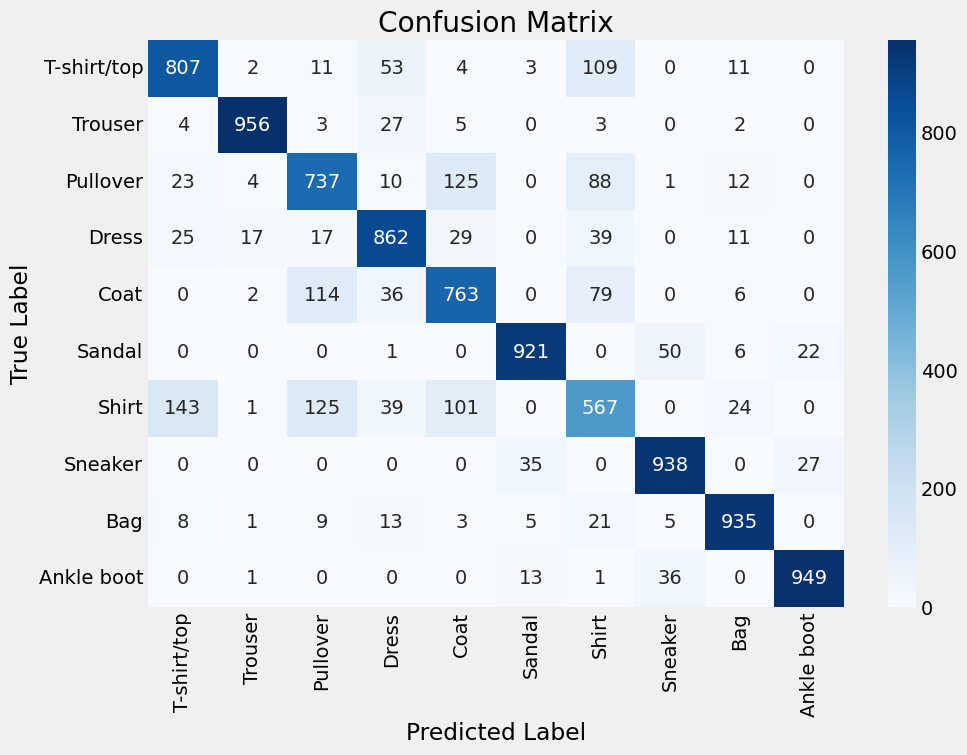

In [ ]:
# Khởi động bộ đếm thời gian
start_time = time.time()

# Dự đoán trên tập kiểm tra
y_pred = log_reg.predict(X_test_flat)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian dự đoán
eval_time = end_time - start_time
print("Thời gian dự đoán model Logistic Regression: {:.2f} giây".format(eval_time))

# In báo cáo phân loại
report = classification_report(y_test, y_pred, target_names=list(label_description.values()), digits=4)
print(report)

# Tạo confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Hiển thị confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

- Time taken to fit the Logistic Regression model: 241.6189 seconds
- Thời gian dự đoán model Logistic Regression: 0.04 giây

#### Công Thức Đánh Giá Mô Hình

- **Precision**:
$$
\text{Precision} = \frac{TP}{TP + FP}
$$
Trong đó:
- \( TP \): True Positives
- \( FP \): False Positives

- **Recall** :
$$
\text{Recall} = \frac{TP}{TP + FN}
$$
Trong đó:
- \( FN \): False Negatives

- **Accuracy**:
$$
\text{Accuracy} = \frac{TP + TN}{TP + TN + FP + FN}
$$
Trong đó:
- \( TN \): True Negatives

- **F1-Score**:
$$
\text{F1} = 2 \cdot \frac{\text{Precision} \cdot \text{Recall}}{\text{Precision} + \text{Recall}}
$$


#### Đánh giá tổng quan trên Confusion matrix

1/ Nhận dạng tốt với một số lớp nhất định:
- Các lớp như **Trouser** và **Ankle boot** có độ chính xác rất cao, thể hiện qua số lượng dự đoán đúng lớn trên đường chéo (956 và 949 tương ứng). Điều này cho thấy mô hình dễ dàng nhận diện được đặc điểm đặc trưng của các loại trang phục này.

2/ Lỗi phổ biến giữa các lớp có hình dạng tương tự:
- **T-shirt/top** có số lượng nhầm lẫn đáng kể với **Shirt** (109 mẫu). Điều này có thể do hai loại trang phục này có đặc điểm hình dạng tương tự nhau, khiến mô hình gặp khó khăn trong việc phân biệt.
- **Pullover** và **Coat** cũng bị nhầm lẫn với nhau (114 mẫu), điều này có thể xuất phát từ hình dạng tương đồng giữa chúng trong tập dữ liệu Fashion-MNIST.

3/ Các lớp ít bị nhầm lẫn:
- **Sandal** và **Sneaker** ít bị nhầm lẫn với các lớp khác, điều này có thể do hình dáng đặc trưng của chúng dễ phân biệt hơn so với các loại trang phục khác.

4/ Một số lỗi nhỏ và không đáng kể:
- Các nhầm lẫn nhỏ như **Ankle boot** với **Sneaker** (27 mẫu) là hợp lý vì chúng đều là các loại giày và có một số đặc điểm hình dạng tương đồng.


#### 1. Các Lớp Bị Nhầm Lẫn
- **Shirt, Pullover, và Coat**:
  - Các lớp này có hình dáng tương tự nhau, dẫn đến việc mô hình gặp khó khăn trong việc phân loại chính xác.
  - Sự tương đồng trong kiểu dáng và màu sắc có thể khiến các đặc trưng phân loại trở nên không rõ ràng.

#### 2. Thông Số Phân Loại Thấp
- **Độ Chính Xác Thấp**:
  - Các lớp này thường có độ chính xác thấp hơn mức trung bình (macro avg: 0.84).
- **Chỉ Số F1 Thấp**:
  - Chỉ số F1 cho các lớp này thường nằm trong khoảng từ 0.59 đến 0.73, cho thấy hiệu suất không ổn định.

#### 3. Nguyên Nhân Gây Ra Vấn Đề

- **Thiếu Đặc Trưng Để Phân Loại**:
  - Sự tương đồng về hình dáng và thiết kế của các sản phẩm có thể làm cho mô hình khó phân biệt giữa chúng.

#### Kết Luận

Việc các lớp có thông số thấp hơn bình thường trong Fashion-MNIST có thể là kết quả của nhiều yếu tố từ sự tương đồng trong hình dáng. Cần có các giải pháp và cải tiến hợp lý để cải thiện hiệu suất phân loại cho các lớp này.


**Dựa vào công thức tính giữa các metrics, nhóm quyết định dùng F1 score và accuracy làm key metrics. Bởi vì F1-score cho cái nhìn tổng quát nhất về precision và recall, còn accuracy cho thấy tỉ lệ dự đoán đúng trên tổng số dự đoán.**

### Retrain with LDA 9 dimensions

Time to fit Logistic Regression: 3.05 seconds
              precision    recall  f1-score   support

 T-shirt/top       0.79      0.80      0.79      1000
     Trouser       0.98      0.95      0.96      1000
    Pullover       0.70      0.70      0.70      1000
       Dress       0.82      0.85      0.83      1000
        Coat       0.71      0.74      0.72      1000
      Sandal       0.91      0.89      0.90      1000
       Shirt       0.60      0.55      0.57      1000
     Sneaker       0.89      0.91      0.90      1000
         Bag       0.93      0.94      0.94      1000
  Ankle boot       0.92      0.92      0.92      1000

    accuracy                           0.82     10000
   macro avg       0.82      0.82      0.82     10000
weighted avg       0.82      0.82      0.82     10000



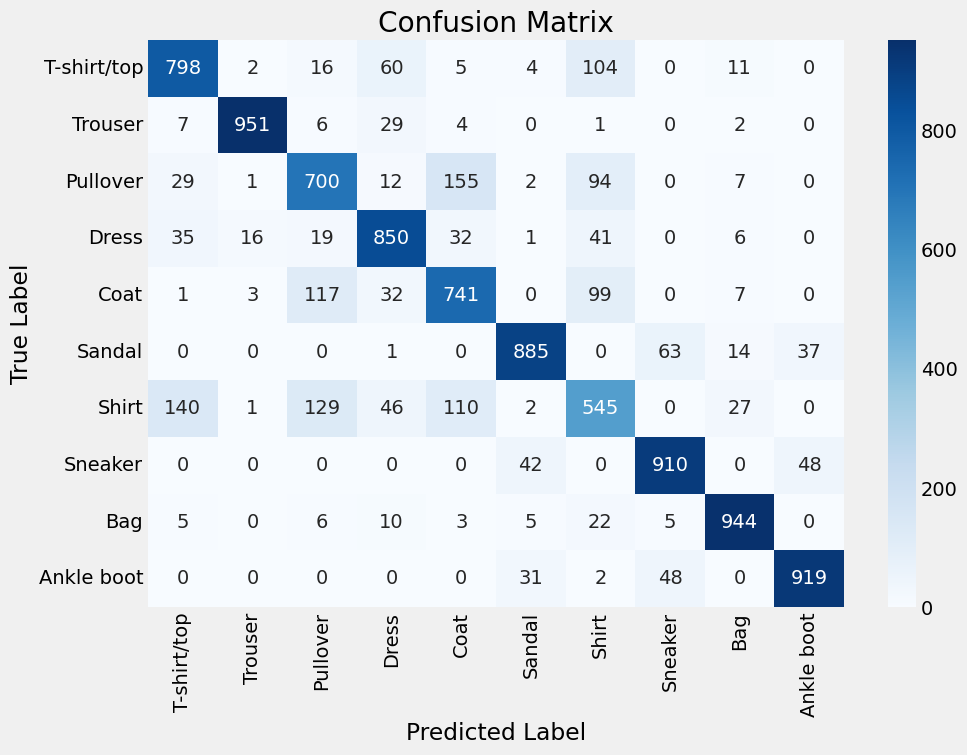

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import time
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix

# Khởi tạo và áp dụng LDA lên dữ liệu
lda = LDA(n_components=9)

X_train_lda = lda.fit_transform(X_train_flat, y_train)
X_test_lda = lda.transform(X_test_flat)


# Khởi tạo và huấn luyện Logistic Regression
log_reg = LogisticRegression(max_iter=1000)

start_time = time.time()
log_reg.fit(X_train_lda, y_train)
fit_time = time.time() - start_time
print(f"Time to fit Logistic Regression: {fit_time:.2f} seconds")

# Dự đoán và đo thời gian dự đoán
start_time = time.time()
y_pred = log_reg.predict(X_test_lda)
predict_time = time.time() - start_time


# In báo cáo phân loại
report = classification_report(y_test, y_pred, target_names=list(label_description.values()))
print(report)

# Tạo và hiển thị confusion matrix
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()


In [ ]:
print(f"Time to fit Logistic Regression - LDA: {fit_time:.2f} seconds")
print(f"Time to eval Logistic Regression - LDA: {predict_time:.4f} seconds")

- Time to fit Logistic Regression - LDA: 3.05 seconds seconds
- Time to eval Logistic Regression - LDA: 0.0021 seconds

### Retrain with PCA 95%

Prediction time: 0.01 seconds
              precision    recall  f1-score   support

 T-shirt/top       0.80      0.81      0.81      1000
     Trouser       0.98      0.95      0.97      1000
    Pullover       0.72      0.74      0.73      1000
       Dress       0.83      0.87      0.85      1000
        Coat       0.74      0.76      0.75      1000
      Sandal       0.94      0.93      0.93      1000
       Shirt       0.62      0.56      0.59      1000
     Sneaker       0.90      0.94      0.92      1000
         Bag       0.93      0.94      0.94      1000
  Ankle boot       0.95      0.94      0.95      1000

    accuracy                           0.84     10000
   macro avg       0.84      0.84      0.84     10000
weighted avg       0.84      0.84      0.84     10000



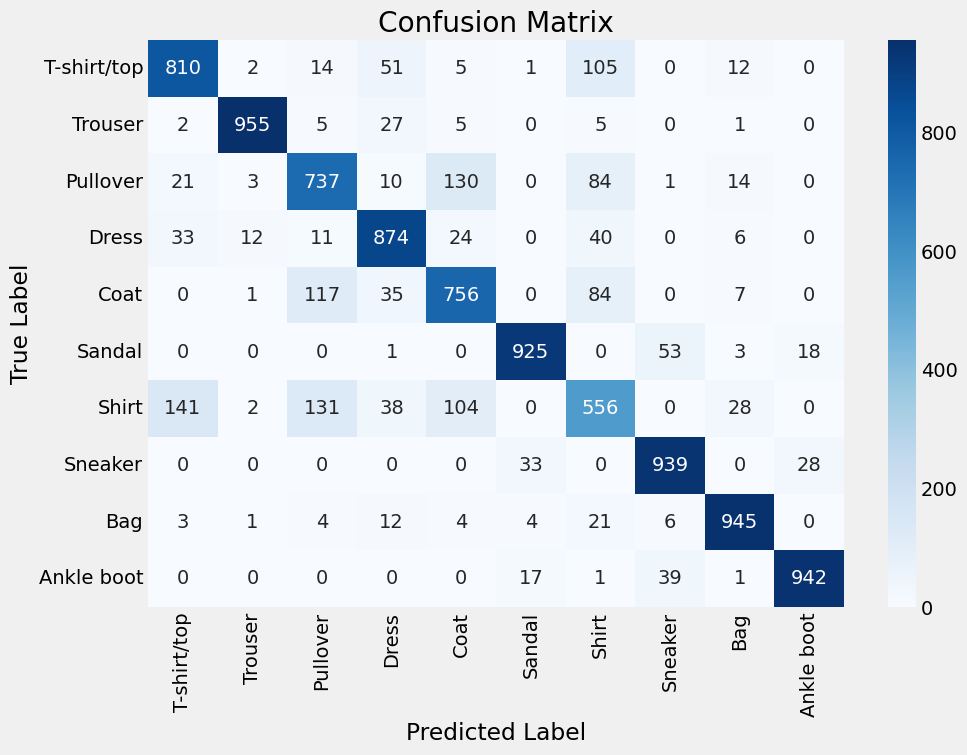

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import time
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix

# Bắt đầu đo thời gian huấn luyện mô hình
start_train = time.time()
log_reg = LogisticRegression(max_iter=1000)
log_reg.fit(X_train_pca, y_train)
end_train = time.time()


# Bắt đầu đo thời gian dự đoán
start_pred = time.time()
y_pred = log_reg.predict(X_test_pca)
end_pred = time.time()
print(f"Prediction time: {end_pred - start_pred:.2f} seconds")

# Hiển thị báo cáo phân loại
report = classification_report(y_test, y_pred, target_names=list(label_description.values()))
print(report)

# Tạo confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Hiển thị confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()


In [ ]:
print(f"Training time Logistic Regression - PCA: {end_train - start_train:.2f} seconds")
print(f"Eval time Logistic Regression - PCA: {end_pred - start_pred:.4f} seconds")

Training time Logistic Regression - PCA: 52.02 seconds
Training time Logistic Regression - PCA: 0.0110 seconds


- Training time Logistic Regression - PCA: 52.02 seconds
- Eval time Logistic Regression - PCA: 0.0110 seconds

### Reflect on the trade-offs between dimensionality reduction and model performance.

| Phiên bản                     | Accuracy | F1-Score | Thời gian huấn luyện (giây) |
|-------------------------------|----------|----------|-------------------------------|
| Logistic Regression - full dimension          | 0.8435   | 0.8426   | 241.62                        |
| Logistic Regression - LDA - 9 dimension    | 0.8200   | 0.8200   | 3.05                          |
| Logistic Regression - PCA -187 dimensions     | 0.8400   | 0.8400   | 58.01                         |


- Logistic Regression không sử dụng phương pháp giảm chiều đạt hiệu suất tốt nhất nhưng tốn nhiều thời gian hơn. Nếu thời gian huấn luyện là một yếu tố quan trọng, việc sử dụng LDA có thể giúp tiết kiệm thời gian, mặc dù có thể làm giảm hiệu suất.
- PCA cung cấp một sự cân bằng giữa độ chính xác và thời gian huấn luyện, cho thấy nó là một lựa chọn hợp lý nếu cần giảm thiểu thời gian mà vẫn giữ được hiệu suất chấp nhận được.
- Bên cạnh đó với số lượng chiều là 9 chiều thì LDA vẫn giữ được 1 hiệu suất khá ổn, mặc dù không thể đọ lại với PCA và full dimension verse nhưng chi phí tính toán của nó là vô cùng thấp

### Tuning (Bonus)

#### Under sampling

In [ ]:
import pandas as pd
import numpy as np
import time
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score
import matplotlib.pyplot as plt
from sklearn.model_selection import StratifiedKFold
import csv

# Tạo DataFrame từ dữ liệu hiện có
xtrn_ytrn_data = pd.DataFrame(data=X_train_flat)
xtrn_ytrn_data['class'] = y_train

# Biến lưu trữ kết quả cho việc vẽ biểu đồ
accuracies = []
train_times = []

# Tạo tập con
# Danh sách các kích thước mẫu tổng bạn muốn thử nghiệm
total_sample_sizes = [10000, 20000, 30000, 40000]

# Sử dụng Stratified Cross Validation
skf = StratifiedKFold(n_splits=4, shuffle=True, random_state=42)

# Tạo file CSV để lưu kết quả
with open('training_undersampling_logistic.csv', mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['Sample Size', 'Training Time (s)', 'Validation Accuracy', 'Validation F1-score'])

    # Lặp qua các kích thước mẫu tổng
    for total_samples in total_sample_sizes:
        samples_per_class = total_samples // 10  # số mẫu mỗi lớp

        # Tạo tập con nhỏ cho training từ tập còn lại
        X_train_small = xtrn_ytrn_data.groupby('class').apply(lambda x: x.sample(samples_per_class)).sample(frac=1, random_state=42).reset_index(drop=True)
        y_train_small = X_train_small['class'].values
        X_train_small = X_train_small.drop(columns='class').values  # Loại bỏ cột nhãn khỏi X_train_small

        # Sử dụng StratifiedKFold để chia nhỏ tập con nhỏ
        for train_index, val_index in skf.split(X_train_small, y_train_small):
            X_train_fold, X_val_fold = X_train_small[train_index], X_train_small[val_index]
            y_train_fold, y_val_fold = y_train_small[train_index], y_train_small[val_index]

            # Bắt đầu đếm thời gian huấn luyện
            start_time = time.time()

            # Tạo mô hình Logistic Regression
            log_reg_model = LogisticRegression(max_iter=1000)
            log_reg_model.fit(X_train_fold, y_train_fold)  # Huấn luyện mô hình với tập con nhỏ

            # Kết thúc đếm thời gian huấn luyện
            training_time = time.time() - start_time

            # Dự đoán trên tập validation
            y_pred_val = log_reg_model.predict(X_val_fold)

            # Tính toán accuracy trên tập validation
            accuracy = accuracy_score(y_val_fold, y_pred_val)
            f1 = f1_score(y_val_fold, y_pred_val, average='weighted')

            # Lưu kết quả cho việc vẽ biểu đồ
            accuracies.append(accuracy)
            train_times.append(training_time)

            # Lưu kết quả vào file CSV
            writer.writerow([samples_per_class * 10, training_time, accuracy, f1])

            # In ra kết quả
            print(f"Sample size: {samples_per_class * 10} (total), Training Time: {training_time:.2f} seconds, Validation Accuracy: {accuracy:.4f}, Validation F1-score: {f1:.4f}")


In [ ]:
import plotly.subplots as sp
import plotly.graph_objects as go

# Đọc kết quả từ file CSV để vẽ biểu đồ
results = pd.read_csv('/content/training_undersampling_logistic.csv')

# Lấy giá trị trung bình cho mỗi sample size
results_avg = results.groupby('Sample Size').mean().reset_index()

fig = sp.make_subplots(rows=1, cols=2, subplot_titles=("Training Time vs Total Sample Size", "Validation Accuracy vs Total Sample Size"))
traces = [
    {'x': results_avg['Sample Size'], 'y': results_avg['Training Time (s)'], 'name': 'Training Time (s)', 'color': 'blue', 'row': 1, 'col': 1, 'yaxis_title': 'Training Time (s)'},
    {'x': results_avg['Sample Size'], 'y': results_avg['Validation Accuracy'], 'name': 'Validation Accuracy', 'color': 'red', 'row': 1, 'col': 2, 'yaxis_title': 'Validation Accuracy'}
]

for trace in traces:
    fig.add_trace(go.Scatter(
        x=trace['x'], y=trace['y'],
        mode='lines+markers', name=trace['name'], line=dict(width=3, color=trace['color'])
    ), row=trace['row'], col=trace['col'])

    # Cập nhật tiêu đề cho các trục
    fig.update_xaxes(title_text='Total Sample Size', row=trace['row'], col=trace['col'])
    fig.update_yaxes(title_text=trace['yaxis_title'], row=trace['row'], col=trace['col'])

# Cập nhật layout để hiển thị hai biểu đồ bên cạnh nhau
fig.update_layout(
    width=1200,
    height=550,
)
fig.show()

<img src="https://github.com/ThuanLy-0092/NDM/raw/main/UndersamplingLR.png" alt="My Image" style="width: 700px;"/>


**Ở đây ta thấy được rằng điểm elbow nằm ở 20000 sample, vì time tăng mạnh từ mốc 20000 sample và accuracy có dấu hiệu tăng chậm lại từ mốc này**

#### Hyperparameter tuning sau khi chọn ra optimal samplesize

#### Quy Trình Huấn Luyện Mô Hình Logistic Regression với Tinh Chỉnh Hyperparameters

1. **Tinh Chỉnh Hyperparameters (Hyperparameter Tuning)**:
   - Chúng ta sử dụng `GridSearchCV` để tìm kiếm các hyperparameters tối ưu cho mô hình. Trong trường hợp này, chúng ta thử nghiệm với các giá trị khác nhau của tham số `C` và kiểu `penalty`.
   - Quy trình này diễn ra trên một tập con nhỏ của dữ liệu huấn luyện (`X_train_small`), giúp giảm thiểu thời gian tính toán và cho phép thử nghiệm nhanh chóng với nhiều cấu hình khác nhau.

2. **Huấn Luyện Lại Mô Hình**:
   - Sau khi tìm được các hyperparameters tốt nhất, chúng ta huấn luyện lại mô hình với toàn bộ dữ liệu huấn luyện (`X_train_flat`).
   - Việc này rất quan trọng vì mô hình cần phải học từ tất cả dữ liệu có sẵn để tối đa hóa khả năng tổng quát (generalization). Mô hình được huấn luyện trên toàn bộ dữ liệu sẽ có cơ hội học được nhiều đặc trưng hơn và cải thiện hiệu suất khi gặp dữ liệu chưa thấy.

3. **Lưu Mô Hình**:
   - Cuối cùng, sau khi huấn luyện lại mô hình với các hyperparameters tối ưu, chúng ta lưu mô hình vào một file pickle để có thể sử dụng trong tương lai mà không cần phải huấn luyện lại.

### Kết Luận
Quy trình này giúp nhóm tận dụng tối đa thông tin từ dữ liệu huấn luyện, từ đó nâng cao độ chính xác và khả năng dự đoán của mô hình trên dữ liệu mới. Việc huấn luyện lại trên toàn bộ dữ liệu sau khi tinh chỉnh hyperparameters là một bước quan trọng trong quy trình phát triển mô hình máy học.


#### Full dimension

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
import pandas as pd
import pickle

# Tạo DataFrame từ dữ liệu hiện có
xtrn_ytrn_data = pd.DataFrame(data=X_train_flat)
xtrn_ytrn_data['class'] = y_train

# Lấy 20,000 mẫu từ tập training với mỗi lớp có số mẫu ngang nhau
total_samples = 20000
samples_per_class = total_samples // 10

# Tạo tập con nhỏ cho training
X_train_small = pd.concat([xtrn_ytrn_data[xtrn_ytrn_data['class'] == i].sample(samples_per_class, random_state=42) for i in range(10)], axis=0)
y_train_small = X_train_small['class'].values
X_train_small = X_train_small.drop(columns='class').values  # Loại bỏ cột nhãn

# Định nghĩa lưới tham số để tìm kiếm
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'penalty': ['l2']
}

# Khởi tạo Logistic Regression và GridSearchCV
log_reg = LogisticRegression(max_iter=1000)
grid_search = GridSearchCV(log_reg, param_grid, cv=5, scoring='accuracy', n_jobs=-1)

# Tìm kiếm các tham số tốt nhất
grid_search.fit(X_train_small, y_train_small)

print("Best Parameters:", grid_search.best_params_)
print("Best Cross-Validation Score:", grid_search.best_score_)

# Huấn luyện lại mô hình với hyperparameter tối ưu trên toàn bộ dữ liệu
best_log_reg = grid_search.best_estimator_
best_log_reg.fit(X_train_flat, y_train)

# In kết quả trên toàn bộ dữ liệu
print("Model fitted on the entire dataset.")

# Lưu mô hình vào file pickle
with open('best_logistic_regression_model.pkl', 'wb') as file:
    pickle.dump(best_log_reg, file)

print("Model saved to best_logistic_regression_model.pkl")


Best Parameters: {'C': 0.1, 'penalty': 'l2'}
Best Cross-Validation Score: 0.8510500000000001
Model fitted on the entire dataset.
Model saved to best_logistic_regression_model.pkl


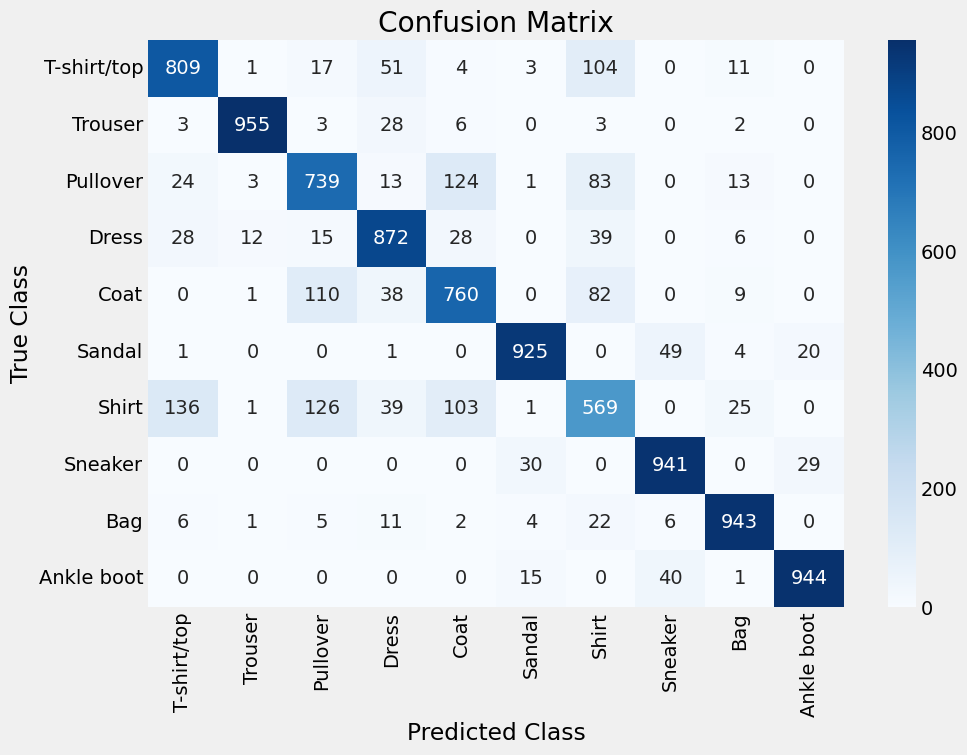

Classification Report:
               precision    recall  f1-score   support

 T-shirt/top       0.80      0.81      0.81      1000
     Trouser       0.98      0.95      0.97      1000
    Pullover       0.73      0.74      0.73      1000
       Dress       0.83      0.87      0.85      1000
        Coat       0.74      0.76      0.75      1000
      Sandal       0.94      0.93      0.93      1000
       Shirt       0.63      0.57      0.60      1000
     Sneaker       0.91      0.94      0.92      1000
         Bag       0.93      0.94      0.94      1000
  Ankle boot       0.95      0.94      0.95      1000

    accuracy                           0.85     10000
   macro avg       0.84      0.85      0.84     10000
weighted avg       0.84      0.85      0.84     10000



In [ ]:
import pickle
import pandas as pd
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Tải mô hình từ file pickle
with open('best_logistic_regression_model.pkl', 'rb') as file:
    loaded_model = pickle.load(file)

# Giả sử X_test_flat và y_test là tập dữ liệu test đã được chuẩn bị
# Sử dụng mô hình đã tải để dự đoán
predictions = loaded_model.predict(X_test_flat)

# Hiển thị ma trận nhầm lẫn
conf_matrix = confusion_matrix(y_test, predictions)

# Vẽ ma trận nhầm lẫn
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel('Predicted Class')
plt.ylabel('True Class')
plt.title('Confusion Matrix')
plt.show()

# In báo cáo phân loại
report = classification_report(y_test, predictions,target_names=list(label_description.values()))
print("Classification Report:\n", report)



#### PCA-187 dimension

In [ ]:
# Tạo DataFrame từ dữ liệu LDA hiện có
xtrn_ytrn_data_lda = pd.DataFrame(data=X_train_pca)
xtrn_ytrn_data_lda['class'] = y_train

# Tạo tập con nhỏ cho training với 20,000 mẫu
total_samples = 20000
samples_per_class = total_samples // 10
X_train_small = xtrn_ytrn_data_lda.groupby('class').apply(lambda x: x.sample(samples_per_class, random_state=42)).sample(frac=1, random_state=42).reset_index(drop=True)
y_train_small = X_train_small['class'].values
X_train_small = X_train_small.drop(columns='class').values  # Loại bỏ cột nhãn

# Khởi tạo Logistic Regression và GridSearchCV
log_reg = LogisticRegression(max_iter=1000)
grid_search = GridSearchCV(log_reg, param_grid, cv=5, scoring='accuracy', n_jobs=-1)

# Tìm kiếm các tham số tốt nhất
grid_search.fit(X_train_small, y_train_small)

print("Best Parameters:", grid_search.best_params_)
print("Best Cross-Validation Score:", grid_search.best_score_)

# Huấn luyện lại mô hình với hyperparameter tối ưu trên toàn bộ dữ liệu
best_log_reg = grid_search.best_estimator_
best_log_reg.fit(X_train_pca, y_train)

# In kết quả trên toàn bộ dữ liệu
print("Model fitted on the entire dataset.")

# Lưu mô hình vào file pickle
with open('best_logistic_regression_PCA_model.pkl', 'wb') as file:
    pickle.dump(best_log_reg, file)

print("Model saved to best_logistic_regression_PCA_model.pkl")


<ipython-input-50-6ed9c21e237e>:8: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



Best Parameters: {'C': 0.1, 'penalty': 'l2'}
Best Cross-Validation Score: 0.85085
Model fitted on the entire dataset.
Model saved to best_logistic_regression_PCA_model.pkl


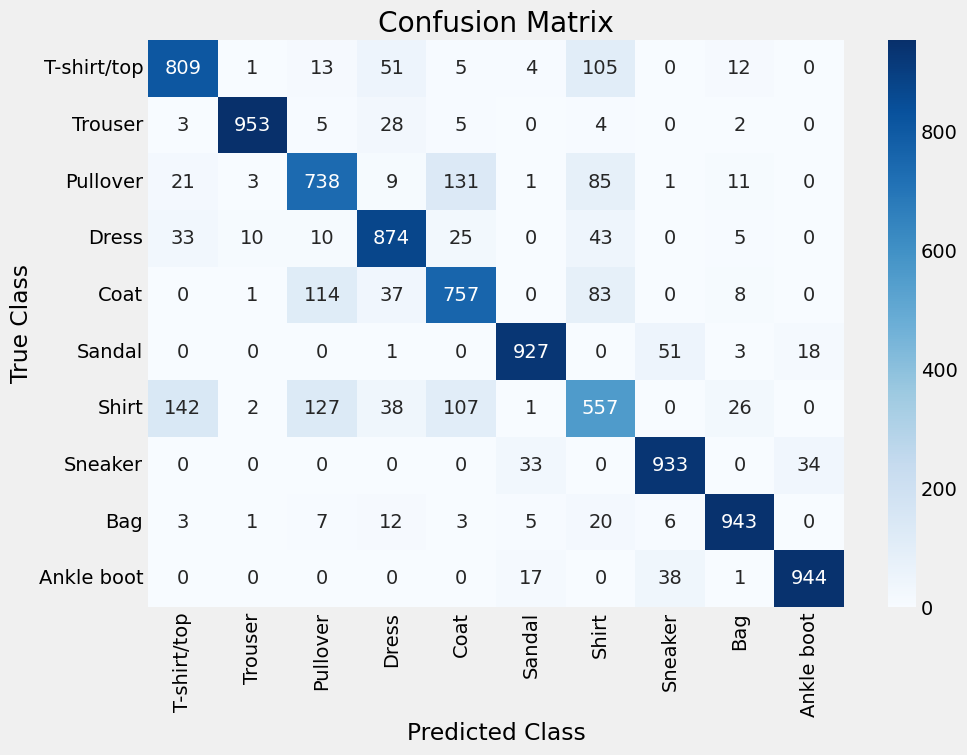

Classification Report:
               precision    recall  f1-score   support

 T-shirt/top       0.80      0.81      0.80      1000
     Trouser       0.98      0.95      0.97      1000
    Pullover       0.73      0.74      0.73      1000
       Dress       0.83      0.87      0.85      1000
        Coat       0.73      0.76      0.74      1000
      Sandal       0.94      0.93      0.93      1000
       Shirt       0.62      0.56      0.59      1000
     Sneaker       0.91      0.93      0.92      1000
         Bag       0.93      0.94      0.94      1000
  Ankle boot       0.95      0.94      0.95      1000

    accuracy                           0.84     10000
   macro avg       0.84      0.84      0.84     10000
weighted avg       0.84      0.84      0.84     10000



In [ ]:
import pickle
import pandas as pd
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Tải mô hình từ file pickle
with open('best_logistic_regression_PCA_model.pkl', 'rb') as file:
    loaded_model = pickle.load(file)

# Giả sử X_test_flat và y_test là tập dữ liệu test đã được chuẩn bị
# Sử dụng mô hình đã tải để dự đoán
predictions = loaded_model.predict(X_test_pca)

# Hiển thị ma trận nhầm lẫn
conf_matrix = confusion_matrix(y_test, predictions)

# Vẽ ma trận nhầm lẫn
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel('Predicted Class')
plt.ylabel('True Class')
plt.title('Confusion Matrix')
plt.show()

# In báo cáo phân loại
report = classification_report(y_test, predictions,target_names=list(label_description.values()))
print("Classification Report:\n", report)



#### LDA -9 dimension

**Với LDA số chiều đã khá nhỏ nên việc undersampling là không cần thiết**

In [ ]:
# Khởi tạo Logistic Regression và GridSearchCV
log_reg = LogisticRegression(max_iter=1000)
grid_search = GridSearchCV(log_reg, param_grid, cv=5, scoring='accuracy', n_jobs=-1)

# Tìm kiếm các tham số tốt nhất
grid_search.fit(X_train_lda, y_train)

print("Best Parameters:", grid_search.best_params_)
print("Best Cross-Validation Score:", grid_search.best_score_)

# Huấn luyện lại mô hình với hyperparameter tối ưu trên toàn bộ dữ liệu
best_log_reg = grid_search.best_estimator_
best_log_reg.fit(X_train_lda, y_train)

# In kết quả trên toàn bộ dữ liệu
print("Model fitted on the entire dataset.")

# Lưu mô hình vào file pickle
with open('best_logistic_regression_LDA_model.pkl', 'wb') as file:
    pickle.dump(best_log_reg, file)

print("Model saved to best_logistic_regression_LDA_model.pkl")


Best Parameters: {'C': 10, 'penalty': 'l2'}
Best Cross-Validation Score: 0.8421166666666666
Model fitted on the entire dataset.
Model saved to best_logistic_regression_LDA_model.pkl


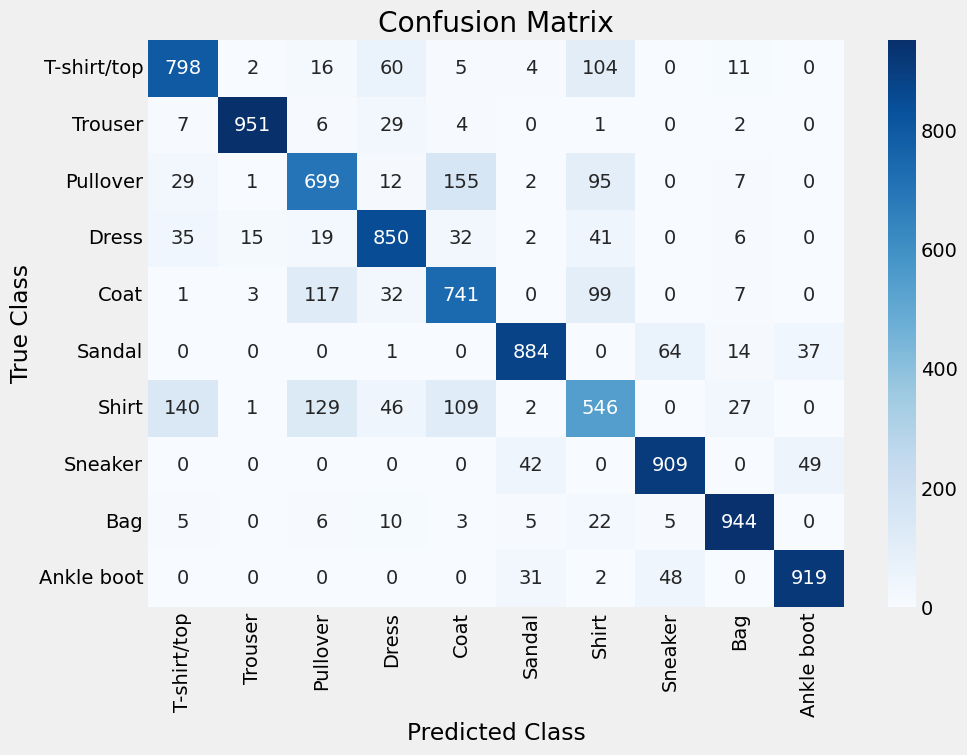

Classification Report:
               precision    recall  f1-score   support

 T-shirt/top       0.79      0.80      0.79      1000
     Trouser       0.98      0.95      0.96      1000
    Pullover       0.70      0.70      0.70      1000
       Dress       0.82      0.85      0.83      1000
        Coat       0.71      0.74      0.72      1000
      Sandal       0.91      0.88      0.90      1000
       Shirt       0.60      0.55      0.57      1000
     Sneaker       0.89      0.91      0.90      1000
         Bag       0.93      0.94      0.94      1000
  Ankle boot       0.91      0.92      0.92      1000

    accuracy                           0.82     10000
   macro avg       0.82      0.82      0.82     10000
weighted avg       0.82      0.82      0.82     10000



In [ ]:
import pickle
import pandas as pd
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Tải mô hình từ file pickle
with open('best_logistic_regression_LDA_model.pkl', 'rb') as file:
    loaded_model = pickle.load(file)

# Giả sử X_test_flat và y_test là tập dữ liệu test đã được chuẩn bị
# Sử dụng mô hình đã tải để dự đoán
predictions = loaded_model.predict(X_test_lda)

# Hiển thị ma trận nhầm lẫn
conf_matrix = confusion_matrix(y_test, predictions)

# Vẽ ma trận nhầm lẫn
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel('Predicted Class')
plt.ylabel('True Class')
plt.title('Confusion Matrix')
plt.show()

# In báo cáo phân loại
report = classification_report(y_test, predictions,target_names=list(label_description.values()))
print("Classification Report:\n", report)

### Summarize

**Sau quá trình tuning, nhóm nhận thấy model Logistic Regression có lẽ đã đạt đến giới hạn và không tiếp tục cải thiện độ chính xác được nữa, có lẽ vì sự đơn giản của model nên nó không học được các mối quan hệ phức tạp khác giữa các lớp có độ tương đồng cao**

**Do đó ta tiến hành sử dụng SVM với mong muốn cải thiện được hiệu suất**

## **04. Support Vector Machine (SVM)**

Support Vector Machine (SVM) là một thuật toán học có giám sát được sử dụng phổ biến cho các bài toán phân loại và hồi quy.

SVM hoạt động bằng cách tìm một siêu phẳng (hyperplane) tối ưu trong không gian nhiều chiều để phân tách các điểm dữ liệu thành các lớp khác nhau.

#### **Các dạng Support Vector Machine:**
* **Linear SVM:** Được sử dụng khi dữ liệu có thể được phân tách một cách tuyến tính. Điều này có nghĩa là có thể tìm thấy một siêu phẳng trong không gian đầu vào để chia các lớp dữ liệu.
* **Non - linear SVM:** Khi dữ liệu không thể phân tách tuyến tính, SVM có thể sử dụng kernel trick để ánh xạ dữ liệu sang không gian có chiều cao hơn, nơi dữ liệu có thể được phân tách tuyến tính. Các kernel phổ biến: **RBF(Radial Basis Function), polynomial, sigmoid**.

#### **Giải thích thêm:**
* Kernel trick là một kỹ thuật giúp tính toán hiệu quả khi chuyển đổi dữ liệu sang không gian cao hơn mà không cần phải trực tiếp thực hiện việc chuyển đổi.

* SVM sử dụng các kernel để tìm ra Support Vector Classifiers và xác định biên phân loại một cách hiệu quả trong không gian nhiều chiều, giúp phân loại dữ liệu mà trước đó không thể phân tách trong không gian ban đầu.

Fashion-MNIST là tập dữ liệu hình ảnh chứa 10 loại sản phẩm thời trang, với các đặc điểm đa dạng và có thể có đặc trưng tương đồng hoặc khác biệt giữa các loại (ví dụ: giày dép so với áo sơ mi rất khác biệt nhưng áo thun và áo sơ mi lại có những đặc trưng tương đồng).

Vì thế, cần tiến hành thử nghiệm cả hai phương pháp: **Linear SVM** và **RBF SVM** (Non-linear SVM) để xác định được liệu mô hình tuyến tính hay phi tuyến sẽ phù hợp hơn với tập dữ liệu. Từ đó đưa ra nhận xét chính xác hơn về hiệu suất tổng thể.

### **Bài toán phân loại đa lớp**

SVM là một thuật toán phân loại nhị phân tuy nhiên với bộ dữ liệu nhiều lớp như Fashion-MNIST chúng ta cần mở rộng SVM để giải quyết bài toán phân loại đa lớp.

Để mở rộng thành thuật toán phân loại đa lớp chúng ra cần quan tâm hai chiến lược One-vs-One (OvO) và One-vs-Rest (OvR).
* **OvO**: SVM sẽ huấn luyện một mô hình riêng cho mỗi cặp lớp khác nhau trong dữ liệu.
* **OvR**: SVM sẽ huấn luyện một mô hình cho mỗi lớp và phân biệt lớp đó với tất cả các lớp còn lại.

Như ta quan sát ở những phần trên (PCA/LDA), dễ dàng nhận thấy dữ liệu có các lớp khó phân biệt và có nhiều đặc trưng chồng lấn lên nhau. Do đó, chiến lược thích hợp cho mô hình SVM sẽ là OvO vì nó có thể cho kết quả chính xác và tổng quát tốt hơn khi dữ liệu không thể phân tách rõ ràng bằng một đường tuyến tính; cũng như OvO sẽ tập trung phân biệt từng cặp lớp nên có thể tạo ra các siêu phẳng phân chia tốt hơn cho những trường hợp phức tạp.

### Linear SVM

* Kernel tuyến tính là tích vô hướng của hai vector trong không gian đầu vào.

* Khi sử dụng kernel tuyến tính, SVM sẽ tạo ra một siêu phẳng (hyperplane) phân cách tuyến tính giữa các lớp dữ liệu.

Kernel tuyến tính được tính theo công thức:

$$k(\mathbf{x}, \mathbf{z}) = \mathbf{x}^T \mathbf{z}$$

Trong đó: **x** và **z** là các vector đầu vào.



**Tham số cần quan tâm:**

Tham số C trong SVM là một hệ số điều chỉnh cho mô hình có sẵn sàng chấp nhận lỗi phân loại đến mức nào trong quá trình huấn luyện.

Khi C lớn, mô hình sẽ cố gắng giảm thiểu lỗi phân loại càng nhiều càng tốt. Kết quả sẽ xảy ra hiện tượng quá khớp (overfitting) với tập huấn luyện.

Khi C nhỏ, cho phép vi phạm lớn hơn với một số điểm dữ liệu, điều này giúp mô hình có khả năng tổng quát tốt hơn (generalization).

### Full dimension + Linear SVM

In [ ]:
import time
from sklearn.svm import SVC

# Khởi động bộ đếm thời gian
start_time = time.time()

# Huấn luyện mô hình
full_linear_svm = SVC(kernel='linear', decision_function_shape='ovo', C=1)
full_linear_svm.fit(X_train_flat, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

Thời gian huấn luyện model: 517.90 giây


In [ ]:
# Tính margin dựa trên các support vectors và trọng số của các siêu phẳng
import numpy as np
from itertools import combinations

# Tính danh sách các cặp lớp
classes = list(label_description.values()) # y_train là nhãn của dữ liệu huấn luyện
pairs = list(combinations(classes, 2))  # Lấy tất cả các cặp lớp

# Kiểm tra nếu mô hình có thuộc tính coef_ (chỉ tồn tại nếu kernel là 'linear')
if hasattr(full_linear_svm, 'coef_'):
    margins = []
    for i, (w, pair) in enumerate(zip(full_linear_svm.coef_, pairs)):
        # Tính margin: khoảng cách giữa siêu phẳng và các support vectors gần nhất
        margin = 2 / np.linalg.norm(w)
        margins.append(margin)
        print(f"Biên độ Margin cho cặp lớp {pair}: {margin:.4f}")
else:
    print("Không thể tính biên độ margin cho kernel phi tuyến.")


Biên độ Margin cho cặp lớp ('T-shirt/top', 'Trouser'): 0.1862
Biên độ Margin cho cặp lớp ('T-shirt/top', 'Pullover'): 0.1630
Biên độ Margin cho cặp lớp ('T-shirt/top', 'Dress'): 0.1583
Biên độ Margin cho cặp lớp ('T-shirt/top', 'Coat'): 0.1719
Biên độ Margin cho cặp lớp ('T-shirt/top', 'Sandal'): 0.5941
Biên độ Margin cho cặp lớp ('T-shirt/top', 'Shirt'): 0.1685
Biên độ Margin cho cặp lớp ('T-shirt/top', 'Sneaker'): 1.1372
Biên độ Margin cho cặp lớp ('T-shirt/top', 'Bag'): 0.1575
Biên độ Margin cho cặp lớp ('T-shirt/top', 'Ankle boot'): 1.2319
Biên độ Margin cho cặp lớp ('Trouser', 'Pullover'): 0.2273
Biên độ Margin cho cặp lớp ('Trouser', 'Dress'): 0.1901
Biên độ Margin cho cặp lớp ('Trouser', 'Coat'): 0.2809
Biên độ Margin cho cặp lớp ('Trouser', 'Sandal'): 1.1425
Biên độ Margin cho cặp lớp ('Trouser', 'Shirt'): 0.2079
Biên độ Margin cho cặp lớp ('Trouser', 'Sneaker'): 2.0960
Biên độ Margin cho cặp lớp ('Trouser', 'Bag'): 0.3546
Biên độ Margin cho cặp lớp ('Trouser', 'Ankle boot'): 1

Nhận xét trực quan trên lớp 'T-shirt' ta thấy các lớp có những thiết kế gần giống với nó thì biên độ margin sẽ nhỏ (vd: ''Pullover', 'Dress', 'Coat', 'Shirt') cho thấy rằng việc phân biệt lớp đó với các lớp khác gặp khó khăn hơn, có thể do đặc trưng bị chồng lấn với các lớp khác hoặc có nhiễu (noise). Với các lớp 'Sneaker', 'Ankle boot' thì lớp 'T-shirt' có biên rộng (margin lớn) chứng tỏ mô hình đã phân biệt tốt giữa các lớp đó, giảm thiểu khả năng mô hình bị sai khi gặp dữ liệu mới.

Giá trị margin không đồng đều giữa các lớp là điều thường gặp khi các lớp có mức độ phức tạp và sự khác biệt khác nhau. Do đó, ta cần thử sử dụng các kernel phi tuyến (RBF kernel) để cải thiện các dữ liệu có các lớp bị chồng lấn hoặc sử dụng kỹ thuật Feature Engineering như Dimensionality Reduction (bằng PCA).

Thời gian dự đoán model: 122.97 giây
              precision    recall  f1-score   support

 T-shirt/top       0.75      0.81      0.78      1000
     Trouser       0.97      0.96      0.97      1000
    Pullover       0.74      0.77      0.75      1000
       Dress       0.85      0.84      0.85      1000
        Coat       0.76      0.77      0.77      1000
      Sandal       0.93      0.94      0.93      1000
       Shirt       0.63      0.56      0.59      1000
     Sneaker       0.92      0.93      0.93      1000
         Bag       0.95      0.93      0.94      1000
  Ankle boot       0.95      0.94      0.95      1000

    accuracy                           0.85     10000
   macro avg       0.85      0.85      0.85     10000
weighted avg       0.85      0.85      0.85     10000



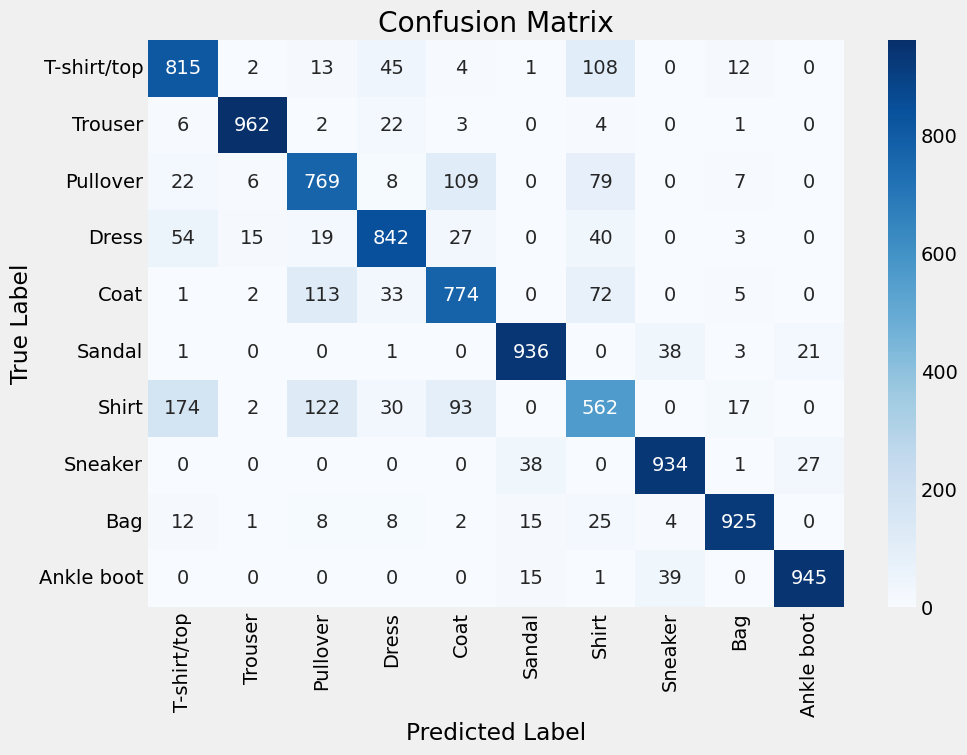

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Khởi động bộ đếm thời gian
start_time = time.time()

# Dự đoán nhãn
y_pred_full = full_linear_svm.predict(X_test_flat)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian dự đoán
prediction_time = end_time - start_time
print("Thời gian dự đoán model: {:.2f} giây".format(prediction_time))

# In báo cáo phân loại
report = classification_report(y_test, y_pred_full, target_names=list(label_description.values()))
print(report)

# Tạo ma trận nhầm lẫn (confusion matrix)
cm = confusion_matrix(y_test, y_pred_full)
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

#### Hiệu suất tổng quan với accuracy, precision, recall, F1 score là 0.85 tương đối tốt.

#### Nhận xét Confusion Matrix:
* Các giá trị đường chéo chính (biểu diễn số mẫu dự đoán đúng của từng lớp) cho thấy mô hình đã phân loại đúng nhiều mẫu thuộc các lớp khác nhau.
* Có sự khác biệt về số lượng mẫu bị phân loại sai:
  Một số lớp có số mẫu phân loại sai khá ít như lớp 'Sneaker', 'Bag', 'Ankle boot'.
  Một số lớp khác lại có số mẫu phân loại sai cao như 'Shirt'. Cho thấy lớp này gặp nhiều khó khăn trong việc phân loại, có thể do đặc trưng của lớp này chồng lấn với các lớp khác.

#### 1. Các Lớp Bị Nhầm Lẫn
- **T-shirt/top, Shirt, Pullover và Coat**:
  - Các lớp này có hình dáng tương tự nhau, dẫn đến việc mô hình gặp khó khăn trong việc phân loại chính xác.
  - Sự tương đồng trong kiểu dáng và màu sắc có thể khiến các đặc trưng phân loại trở nên không rõ ràng.

#### 2. Thông Số Phân Loại Thấp
- **Độ Chính Xác Thấp**:
  - Các lớp này thường có độ chính xác thấp hơn mức trung bình (macro avg: 0.85).
- **Chỉ Số F1 Thấp**:
  - Chỉ số F1 của các lớp Shirt, Pullover, và T-shirt/top đều dưới 0.80, trong đó Shirt chỉ đạt 0.59,  cho thấy hiệu suất không ổn định.

#### 3. Nguyên Nhân Gây Ra Vấn Đề

- **Thiếu Đặc Trưng Để Phân Loại**:
  - Các đặc trưng của các lớp Shirt, Pullover, Coat, và T-shirt/top khá giống nhau về mặt thiết kế và chất liệu, dẫn đến việc mô hình khó phân biệt chính xác.
- **Khó Khăn Trong Việc Huấn Luyện**:
  - Số lượng mẫu không đủ đa dạng và sự thiếu các đặc trưng rõ ràng có thể khiến mô hình gặp khó khăn khi huấn luyện, đặc biệt đối với các lớp có nhiều điểm tương đồng.

#### 4. Giải Pháp Cải Thiện
- **Nhận diện đặc trưng chồng lấn**: Sử dụng kỹ thuật feature engineering hoặc model SVM với các kernel phi tuyến (RBF)
- **Giảm số lượng lỗi phân loại nhầm**: Cân nhắc sử dụng tăng cường đặc trưng hoặc giảm chiều dữ liệu (ví dụ PCA hoặc LDA) để làm rõ sự khác biệt giữa các lớp.
- **Điều chỉnh tham số (Hyperparameter Tuning)**: Thực hiện điều chỉnh tham số C hoặc thử thêm các chiến lược OvO hoặc OvR để cải thiện khả năng phân loại.



### PCA + Linear SVM

#### Trực quan siêu phẳng với dữ liệu PCA 3 thành phần chính

In [ ]:
# Giảm chiều PCA xuống 3 chiều để trực quan siêu phẳng
from sklearn.decomposition import PCA
pca_3 = PCA(n_components=3)
X_train_pca_3 = pca_3.fit_transform(X_train_flat)
X_test_pca_3 = pca_3.transform(X_test_flat)

In [ ]:
pca_3_linear_svm = SVC(kernel='linear', decision_function_shape='ovo', C=1)
pca_3_linear_svm.fit(X_train_pca_3, y_train)

SVC(C=1, decision_function_shape='ovo', kernel='linear')

In [ ]:
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
from sklearn import svm
from itertools import combinations

def plot_decision_boundaries_3d_ovo_linear_plotly(X, y):
    # Lấy danh sách các lớp duy nhất
    classes = np.unique(y)
    pairs = list(combinations(classes, 2))  # Lấy tất cả các cặp lớp

    fig = go.Figure()

    # Vẽ từng siêu phẳng cho mỗi cặp lớp
    for (class1, class2) in pairs:
        # Tạo tập con dữ liệu chỉ chứa 2 lớp hiện tại
        mask = (y == class1) | (y == class2)
        X_pair = X[mask]
        y_pair = y[mask]

        # Huấn luyện linear SVM cho cặp lớp này
        clf = svm.SVC(kernel='linear', C=1)
        clf.fit(X_pair, y_pair)

        # Lấy các hệ số của siêu phẳng (w và b)
        w = clf.coef_[0]
        b = clf.intercept_[0]

        # Tạo lưới điểm để vẽ siêu phẳng
        x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
        y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
        xx, yy = np.meshgrid(np.linspace(x_min, x_max, 50),
                             np.linspace(y_min, y_max, 50))

        # Tính toán z cho siêu phẳng: z = (-w[0] * x - w[1] * y - b) / w[2]
        if w[2] != 0:  # Kiểm tra để đảm bảo w[2] không bằng 0
            zz = (-w[0] * xx - w[1] * yy - b) / w[2]
            fig.add_trace(go.Surface(x=xx, y=yy, z=zz, opacity=0.3, showscale=False))

    # Vẽ các điểm dữ liệu gốc
    fig_data = px.scatter_3d(x=X[:, 0], y=X[:, 1], z=X[:, 2], color=y.astype(str), title="Decision Boundaries for Linear OvO SVM in 3D")

    # Thêm điểm dữ liệu từ fig_data vào fig
    for trace in fig_data.data:
        fig.add_trace(trace)

    # Đặt nhãn trục
    fig.update_layout(scene=dict(
                        xaxis_title='PCA Component 1',
                        yaxis_title='PCA Component 2',
                        zaxis_title='PCA Component 3'))
    fig.show()

# Gọi hàm để vẽ đồ thị
plot_decision_boundaries_3d_ovo_linear_plotly(X_train_pca_3, y_train)




<img src="https://github.com/ThuanLy-0092/NDM/raw/main/SVMPCA.png" alt="My Image" style="width: 700px;"/>


Khi được sử dụng với dữ liệu giảm chiều PCA 3 thành phần chính, các siêu phẳng có sự chồng chéo và phức tạp trong không gian này do đó khiến mô hình SVM khó phân tách các lớp.

Để có một không gian đủ tốt cho việc phân tách tuyến tính, hỗ trợ model SVM, chúng ta cần tăng số thành phần chính trong PCA (Sử dụng PCA giảm 187 chiều để giữ 95% thông tin).



#### Huấn luyện với dữ liệu giảm chiều PCA giữ 95%

In [ ]:
import time
from sklearn.svm import SVC

# Khởi động bộ đếm thời gian
start_time = time.time()

# Huấn luyện mô hình
pca_linear_svm = SVC(kernel='linear', decision_function_shape='ovo', C=1)
pca_linear_svm.fit(X_train_pca, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

Thời gian huấn luyện model: 210.75 giây


Thời gian dự đoán model SVM với PCA: 40.37 giây
              precision    recall  f1-score   support

 T-shirt/top       0.79      0.82      0.80      1000
     Trouser       0.97      0.96      0.97      1000
    Pullover       0.74      0.76      0.75      1000
       Dress       0.85      0.88      0.86      1000
        Coat       0.76      0.76      0.76      1000
      Sandal       0.94      0.93      0.94      1000
       Shirt       0.65      0.58      0.61      1000
     Sneaker       0.91      0.95      0.93      1000
         Bag       0.95      0.95      0.95      1000
  Ankle boot       0.96      0.94      0.95      1000

    accuracy                           0.85     10000
   macro avg       0.85      0.85      0.85     10000
weighted avg       0.85      0.85      0.85     10000



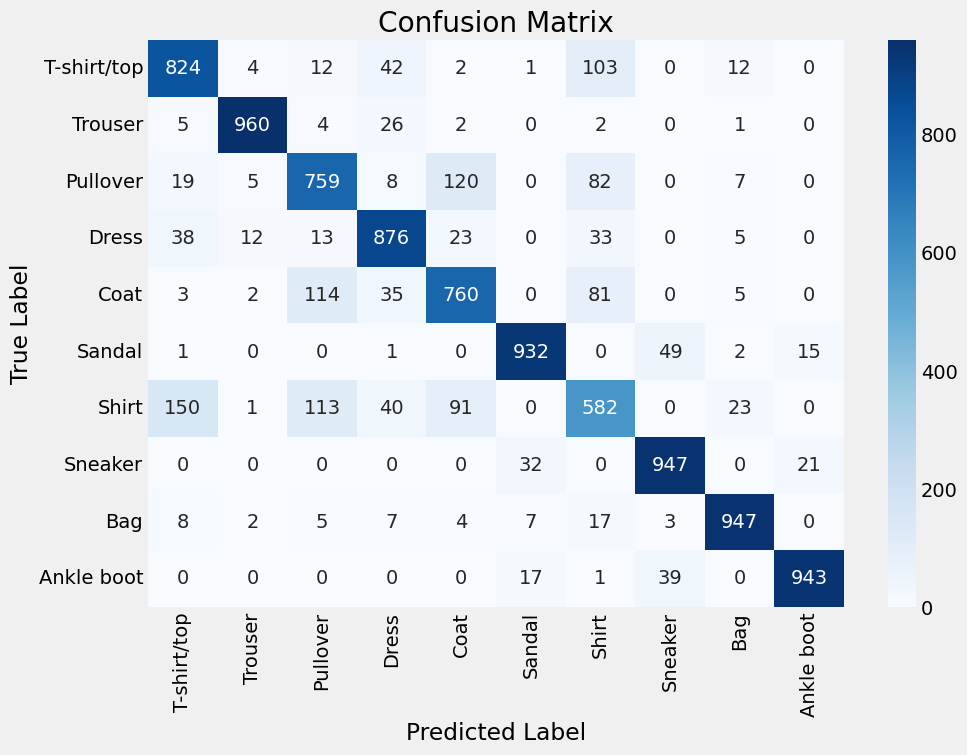

In [ ]:
# Bắt đầu thời gian
start_time = time.time()

# Dự đoán nhãn
y_pred_pca = pca_linear_svm.predict(X_test_pca)

# Kết thúc thời gian
end_time = time.time()

# Tính toán thời gian dự đoán
eval_time = end_time - start_time
print("Thời gian dự đoán model SVM với PCA: {:.2f} giây".format(eval_time))

# In báo cáo phân loại
report = classification_report(y_test, y_pred_pca, target_names=list(label_description.values()))
print(report)

# Tạo confusion matrix
cm = confusion_matrix(y_test, y_pred_pca)

# Hiển thị confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

Hiệu suất tổng quan với accuracy, precision, recall, f1-score đều 0.85 (**tương đương** với khi sử dụng full dimension). Cho thấy PCA không làm giảm hiệu suất tổng thể, nhưng vẫn giữ lại các thông tin quan trọng nhất từ dữ liệu, cải thiện tốc độ huấn luyện.

Nhận xét Confusion Matrix:
- Mức độ vẫn tương tự như trên dữ liệu full dimension
- Các lớp **T-shirt/top, Shirt, Pullover và Coat** vẫn còn bị nhầm lẫn rất cao.

Thông số phân loại
- Một số lớp cải thiện nhẹ (T-Shirt/top, Shirt, Dress, Sandal, Ankle boot)
- Các lớp còn lại hầu như không thay đổi hoặc giảm nhẹ. Shirt vẫn là lớp yếu nhất (tăng từ 0.59 lên 0.61), vẫn còn nhầm lẫn cao với T-shirt và Pullover.

Nguyên nhân và ý nghĩa
- PCA đã giúp giảm nhiễu (noise) và làm nổi bật hơn các đặc trưng quan trọng, nên f1-score của một số lớp có cải thiện.

- PCA giúp giảm chiều nhưng không thể khắc phục được vấn đề phân tách các lớp có đặc điểm tương đồng, như giữa Shirt và T-shirt, do những lớp này có đặc trưng dễ bị chồng chéo.

**Tổng kết**: PCA giúp giảm chiều, cải thiện tốc độ và giữ nguyên hiệu suất tổng thể của model. Tuy nhiên, nó không giúp giải quyết vấn đề phân biệt các đặc điểm tương đồng.

### LDA + Linear SVM

In [ ]:
import time
from sklearn.svm import SVC

# Khởi động bộ đếm thời gian
start_time = time.time()

# Huấn luyện mô hình
lda_linear_svm = SVC(kernel='linear', decision_function_shape='ovo', C=1)
lda_linear_svm.fit(X_train_lda, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

Thời gian huấn luyện model: 43.50 giây


Thời gian dự đoán model SVM với LDA: 10.99 giây
              precision    recall  f1-score   support

 T-shirt/top       0.78      0.81      0.79      1000
     Trouser       0.98      0.95      0.97      1000
    Pullover       0.71      0.69      0.70      1000
       Dress       0.82      0.86      0.84      1000
        Coat       0.70      0.76      0.73      1000
      Sandal       0.92      0.88      0.90      1000
       Shirt       0.60      0.54      0.57      1000
     Sneaker       0.88      0.92      0.90      1000
         Bag       0.92      0.94      0.93      1000
  Ankle boot       0.92      0.91      0.92      1000

    accuracy                           0.83     10000
   macro avg       0.82      0.83      0.82     10000
weighted avg       0.82      0.83      0.82     10000



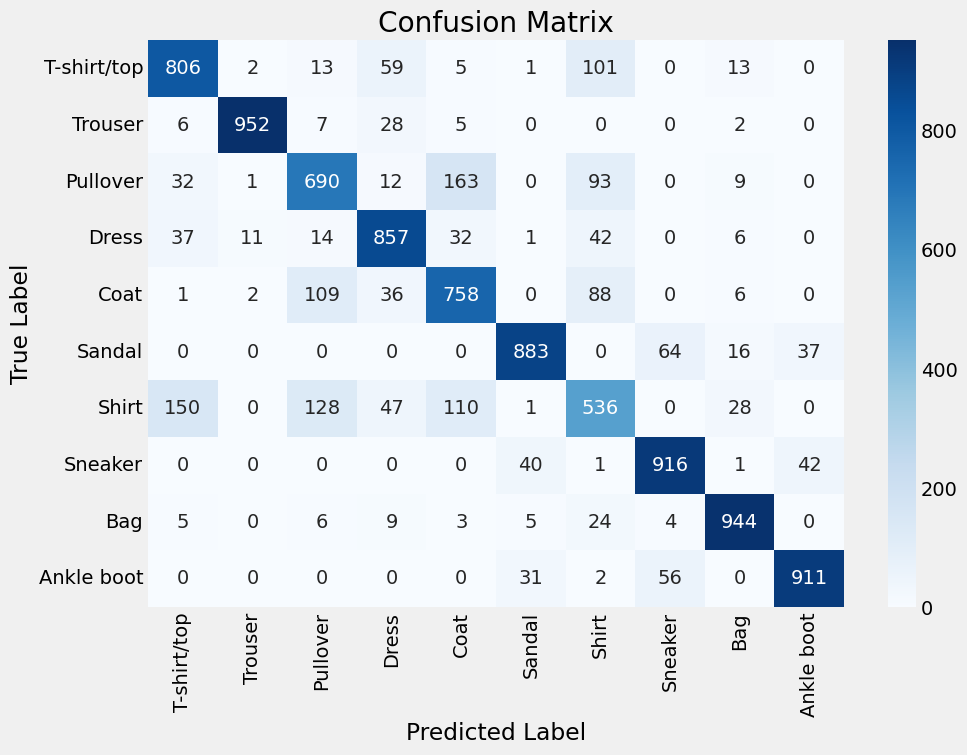

In [ ]:
# Khởi động bộ đếm thời gian
start_time = time.time()

# Dự đoán trên tập kiểm tra
y_pred_lda = lda_linear_svm.predict(X_test_lda)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian dự đoán
eval_time = end_time - start_time
print("Thời gian dự đoán model SVM với LDA: {:.2f} giây".format(eval_time))

# In báo cáo phân loại
report = classification_report(y_test, y_pred_lda, target_names=list(label_description.values()))
print(report)

# Tạo confusion matrix
cm = confusion_matrix(y_test, y_pred_lda)

# Hiển thị confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

**Hiệu suất tổng quan với LDA:**

Độ chính xác (accuracy) tổng thể là `0.83`, giảm nhẹ so với dữ liệu đầy đủ (`0.85`). Điều này cho thấy việc giảm chiều bằng LDA đã làm mất mát một phần thông tin quan trọng.

**Nhận xét Confusion Matrix:**

* Mức độ nhầm lẫn của một số lớp vẫn cao so với dữ liệu đầy đủ.
* Các lớp **Shirt**, **Pullover**, và **Coat** gặp nhiều nhầm lẫn, đặc biệt với các lớp có đặc trưng tương đồng như **T-shirt/top**.

**Thông số phân loại:**

* Các lớp như **Sneaker**, **Bag**, và **Ankle boot** có số lượng mẫu phân loại sai ít, cho thấy các đặc trưng của chúng vẫn duy trì tốt.
* **Shirt** là lớp yếu nhất (F1-score chỉ đạt `0.57`), có nhầm lẫn cao với **T-shirt/top** và **Pullover**.

**Nguyên nhân:**

LDA giúp giảm chiều và giữ lại các đặc trưng chính, nhưng không hoàn toàn khắc phục được vấn đề phân tách các lớp có đặc trưng tương đồng, dẫn đến nhầm lẫn giữa các lớp này.

**Tổng kết:** LDA giúp giảm chiều và cải thiện tốc độ huấn luyện, nhưng không giúp giải quyết triệt để vấn đề nhầm lẫn đối với các lớp có đặc trưng tương đồng.

### Tuning linear SVM

#### Undersampling

In [ ]:
import pandas as pd
import numpy as np
import time
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, f1_score
import matplotlib.pyplot as plt
from sklearn.model_selection import StratifiedKFold
import csv

# Tạo DataFrame từ dữ liệu hiện có
xtrn_ytrn_data = pd.DataFrame(data=X_train_flat)
xtrn_ytrn_data['class'] = y_train

# Biến lưu trữ kết quả cho việc vẽ biểu đồ
accuracies = []
train_times = []

# Tạo tập con
# Danh sách các kích thước mẫu tổng bạn muốn thử nghiệm
total_sample_sizes = [10000, 20000, 30000, 40000]

# Sử dụng Stratified Cross Validation
skf = StratifiedKFold(n_splits=4, shuffle=True, random_state=42)

# Tạo file CSV để lưu kết quả
with open('training_undersampling_linear.csv', mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['Sample Size', 'Training Time (s)', 'Validation Accuracy', 'Validation F1-score'])

    # Lặp qua các kích thước mẫu tổng
    for total_samples in total_sample_sizes:
        samples_per_class = total_samples // 10  # số mẫu mỗi lớp

        # Tạo tập con nhỏ cho training từ tập còn lại
        X_train_small = xtrn_ytrn_data.groupby('class').apply(lambda x: x.sample(samples_per_class)).sample(frac=1, random_state=42).reset_index(drop=True)
        y_train_small = X_train_small['class'].values
        X_train_small = X_train_small.drop(columns='class').values  # Loại bỏ cột nhãn khỏi X_train_small

        # Sử dụng StratifiedKFold để chia nhỏ tập con nhỏ
        for train_index, val_index in skf.split(X_train_small, y_train_small):
            X_train_fold, X_val_fold = X_train_small[train_index], X_train_small[val_index]
            y_train_fold, y_val_fold = y_train_small[train_index], y_train_small[val_index]

            # Bắt đầu đếm thời gian huấn luyện
            start_time = time.time()

            # Tạo mô hình SVM
            svm_model = SVC(kernel="linear", decision_function_shape='ovo', C=1)
            svm_model.fit(X_train_fold, y_train_fold)  # Huấn luyện mô hình với tập con nhỏ

            # Kết thúc đếm thời gian huấn luyện
            training_time = time.time() - start_time

            # Dự đoán trên tập validation
            y_pred_val = svm_model.predict(X_val_fold)

            # Tính toán accuracy trên tập validation
            accuracy = accuracy_score(y_val_fold, y_pred_val)
            f1 = f1_score(y_val_fold, y_pred_val, average='weighted')

            # Lưu kết quả cho việc vẽ biểu đồ
            accuracies.append(accuracy)
            train_times.append(training_time)

            # Lưu kết quả vào file CSV
            writer.writerow([samples_per_class * 10, training_time, accuracy, f1])

            # In ra kết quả
            print(f"Sample size: {samples_per_class * 10} (total), Training Time: {training_time:.2f} seconds, Validation Accuracy: {accuracy:.4f}, Validation F1-score: {f1:.4f}")

In [ ]:
import plotly.subplots as sp
import plotly.graph_objects as go

# Đọc kết quả từ file CSV để vẽ biểu đồ
results = pd.read_csv('training_undersampling_linear.csv')

# Lấy giá trị trung bình cho mỗi sample size
results_avg = results.groupby('Sample Size').mean().reset_index()

fig = sp.make_subplots(rows=1, cols=2, subplot_titles=("Training Time vs Total Sample Size", "Validation Accuracy vs Total Sample Size"))
traces = [
    {'x': results_avg['Sample Size'], 'y': results_avg['Training Time (s)'], 'name': 'Training Time (s)', 'color': 'blue', 'row': 1, 'col': 1, 'yaxis_title': 'Training Time (s)'},
    {'x': results_avg['Sample Size'], 'y': results_avg['Validation Accuracy'], 'name': 'Validation Accuracy', 'color': 'red', 'row': 1, 'col': 2, 'yaxis_title': 'Validation Accuracy'}
]

for trace in traces:
    fig.add_trace(go.Scatter(
        x=trace['x'], y=trace['y'],
        mode='lines+markers', name=trace['name'], line=dict(width=3, color=trace['color'])
    ), row=trace['row'], col=trace['col'])

    # Cập nhật tiêu đề cho các trục
    fig.update_xaxes(title_text='Total Sample Size', row=trace['row'], col=trace['col'])
    fig.update_yaxes(title_text=trace['yaxis_title'], row=trace['row'], col=trace['col'])

# Cập nhật layout để hiển thị hai biểu đồ bên cạnh nhau
fig.update_layout(
    width=1200,
    height=550,
)
fig.show()

<img src="https://github.com/ThuanLy-0092/NDM/raw/main/UndersamplingSVM.png" alt="My Image" style="width: 700px;"/>


Cả 2 đường biểu diễn có xu hướng tăng dần.
  - Khi kích thước mẫu càng lớn, yêu cầu thời gian xử lý và độ chính xác kiểm thử càng tăng.
  - Tuy nhiên, mức độ tăng của độ chính xác có vẻ không lớn như mức độ tăng của thời gian huấn luyện. Điều này cho thấy, sau một mức độ nào đó, việc thêm dữ liệu chỉ cải thiện nhỏ độ chính xác nhưng đòi hỏi rất nhiều thời gian xử lý.

→ Tập mẫu tăng từ 10k lên 40k, thời gian huấn luyện tăng lên gấp nhiều lần (gấp khoảng 15 lần) trong khi độ chính xác chỉ tăng khoảng 0.02, như vậy, **chi phí tính toán** tăng lên nhưng không tương xứng với **lợi ích** từ độ chính xác.

**Phân tích lựa chọn dữ liệu phù hợp**:
- Kích thước mẫu nhỏ (10k, 20k): thời gian huấn luyện tăng đáng kể và độ chính xác đã đạt khoảng 0.83. Nếu yêu cầu huấn luyện nhanh và độ chính xác vừa phải, kích thước khoảng 10k, 20k là tốt.
- Kích thước mẫu lớn (30k, 40k): độ chính xác cải thiện thêm (gần 0.85) nhưng thời gian huấn luyện tăng gần 100 giây. Nếu yêu cầu độ chính xác cao và không hạn chế về tài nguyên, thì kích thước dữ liệu lớn sẽ hợp lý.

→ Chọn mốc 20000 data vì nhóm tập trung vào thời gian của mô hình để xác định được tham số tối ưu cho mô hình. Tuy nhiên, không sử dụng số lượng data đó (20,000 data) cho training được vì sẽ làm ảnh hưởng đến hiệu suất mô hình.

#### Hyperparameter Tuning

**Điều chỉnh tham số C:**

Để tìm giá trị tối ưu cho tham số C có thể sử dụng các phương pháp như **GridSearchCV** hoặc **RandomizedSearchCV** kết hợp **Cross-validation**.

Sau khi đã xử lý undersampling tụi em tiếp tục hyperparameter tuning cho tham số C bằng phương pháp GridSearchCV kết hợp Cross-validation.

### Quy Trình Huấn Luyện Mô Hình SVM với Tinh Chỉnh Hyperparameters

Trong quy trình phát triển mô hình SVM (Support Vector Machine), chúng ta đã thực hiện các bước sau để tối ưu hóa mô hình:

1. **Chuẩn Bị Dữ Liệu**:
   - Chúng ta tạo một DataFrame từ dữ liệu huấn luyện hiện có (`X_train_flat` và `y_train`).
   - Để giảm thiểu thời gian huấn luyện và kiểm tra hiệu suất, chúng ta đã tạo một tập con nhỏ với 20,000 mẫu, đảm bảo rằng mỗi lớp có số mẫu ngang nhau. Điều này giúp mô hình học từ dữ liệu đại diện cho tất cả các lớp mà không bị thiên lệch.

2. **Định Nghĩa Lưới Tham Số (Hyperparameter Grid)**:
   - Chúng ta định nghĩa một lưới tham số (`param_grid`) để tìm kiếm các giá trị tốt nhất cho tham số `C`, kiểu `kernel`, và `decision_function_shape`. Việc lựa chọn các giá trị khác nhau cho những tham số này sẽ giúp tìm ra cấu hình tối ưu cho mô hình.

3. **Tìm Kiếm Tham Số Tốt Nhất**:
   - Chúng ta sử dụng `GridSearchCV` để tìm kiếm các hyperparameters tốt nhất cho mô hình SVM. Quá trình này sử dụng k-fold cross-validation (cv=3) để đảm bảo rằng mô hình không bị quá khớp (overfitting) và đánh giá chính xác hiệu suất của nó.

4. **Lưu Mô Hình**:
   - Sau khi tìm được các hyperparameters tối ưu, chúng ta lưu mô hình vào một file pickle. Điều này cho phép chúng ta dễ dàng tái sử dụng mô hình mà không cần phải huấn luyện lại từ đầu, giúp tiết kiệm thời gian và tài nguyên tính toán.

### Kết Luận
Quy trình này giúp đảm bảo rằng mô hình SVM được tối ưu hóa cho dữ liệu huấn luyện và có khả năng tổng quát tốt khi gặp dữ liệu mới. Việc lưu mô hình vào file pickle là một bước quan trọng trong quy trình phát triển mô hình máy học, cho phép sử dụng lại tham số tối ưu của mô hình. Việc dùng tham số tối ưu của tập data 20000 sample sau đó dùng tham số đó để train lại với toàn bộ tập data sẽ giúp giảm chi phí tính toán và đồng thời tận dụng được lượng thông tin từ dữ liệu.


#### Full dimension

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
import pickle

# Tạo DataFrame từ dữ liệu hiện có
xtrn_ytrn_data = pd.DataFrame(data=X_train_flat)
xtrn_ytrn_data['class'] = y_train

# Tạo tập con nhỏ cho training với 20,000 mẫu
total_samples = 20000
samples_per_class = total_samples // 10
# Tạo tập con nhỏ cho training
X_train_small = xtrn_ytrn_data.groupby('class').apply(lambda x: x.sample(samples_per_class)).sample(frac=1, random_state=42).reset_index(drop=True)
y_train_small = X_train_small['class'].values
X_train_small = X_train_small.drop(columns='class').values  # Loại bỏ cột nhãn

# Định nghĩa lưới tham số để tìm kiếm
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'kernel': ['linear'],  # Các loại kernel khác nhau
    'decision_function_shape': ['ovo']
}

# Khởi tạo mô hình SVM
svm = SVC()

# Sử dụng GridSearchCV để tìm kiếm tham số tốt nhất
grid_search = GridSearchCV(svm, param_grid, cv=3, scoring='accuracy', n_jobs=-1)

# Tìm hyperparameter tối ưu
grid_search.fit(X_train_small, y_train_small)

# In kết quả hyperparameter tốt nhất
print("Best Parameters:", grid_search.best_params_)
print("Best Cross-Validation Score:", grid_search.best_score_)

# Lưu kết quả RandomizedSearchCV vào file .pickle
with open('best_linear_svm.pkl', 'wb') as file:
    pickle.dump(grid_search, file)

#### PCA - 187 dimension

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
import pickle

# Tạo DataFrame từ dữ liệu hiện có
xtrn_ytrn_data = pd.DataFrame(data=X_train_pca)
xtrn_ytrn_data['class'] = y_train

# Tạo tập con nhỏ cho training với 20,000 mẫu
total_samples = 20000
samples_per_class = total_samples // 10
# Tạo tập con nhỏ cho training
X_train_small_pca = xtrn_ytrn_data.groupby('class').apply(lambda x: x.sample(samples_per_class)).sample(frac=1, random_state=42).reset_index(drop=True)
y_train_small_pca = X_train_small_pca['class'].values
X_train_small_pca = X_train_small_pca.drop(columns='class').values  # Loại bỏ cột nhãn

# Định nghĩa lưới tham số để tìm kiếm
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'kernel': ['linear'],  # Các loại kernel khác nhau
    'decision_function_shape': ['ovo']
}

# Khởi tạo mô hình SVM
svm = SVC()

# Sử dụng GridSearchCV để tìm kiếm tham số tốt nhất
grid_search = GridSearchCV(svm, param_grid, cv=3, scoring='accuracy', n_jobs=-1)

# Tìm hyperparameter tối ưu
grid_search.fit(X_train_small_pca, y_train_small_pca)

# In kết quả hyperparameter tốt nhất
print("Best Parameters:", grid_search.best_params_)
print("Best Cross-Validation Score:", grid_search.best_score_)

# Lưu kết quả GridSearchCV vào file .pickle
with open('best_pca_linear_svm.pkl', 'wb') as file:
    pickle.dump(grid_search, file)

#### LDA - 9 dimension

* Vì số chiều giảm bằng phương pháp LDA nhỏ (cụ thể 9 chiều) nên tụi em quyết định không giảm mẫu để tìm được tham số tối ưu nhất.

In [ ]:
from sklearn.model_selection import GridSearchCV
import pickle

# Định nghĩa lưới tham số để tìm kiếm
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'kernel': ['linear'],  # Các loại kernel khác nhau
    'decision_function_shape': ['ovo']
}

# Khởi tạo mô hình SVM
svm = SVC()

# Sử dụng GridSearchCV để tìm kiếm tham số tốt nhất
grid_search = GridSearchCV(svm, param_grid, cv=3, scoring='accuracy', n_jobs=-1)

# Tìm hyperparameter tối ưu
grid_search.fit(X_train_lda, y_train)

# In kết quả hyperparameter tốt nhất
print("Best Parameters:", grid_search.best_params_)
print("Best Cross-Validation Score:", grid_search.best_score_)

# Lưu kết quả GridSearchCV vào file .pickle
with open('best_lda_linear_svm.pkl', 'wb') as file:
    pickle.dump(grid_search, file)

Best Parameters: {'C': 10, 'decision_function_shape': 'ovo', 'kernel': 'linear'}
Best Cross-Validation Score: 0.8431833333333333


#### Huấn luyện lại mô hình với hyperparameter tối ưu

**Full dimension + Linear SVM**

In [ ]:
import pickle
# Load đối tượng từ file .pickle
with open('best_linear_svm.pkl', 'rb') as file:
    best_linear_svm = pickle.load(file)

# In kết quả từ đối tượng đã load
print("Best Cross-Validation Score:", best_linear_svm.best_score_)
print("Best Parameters:", best_linear_svm.best_params_)

# Khởi động bộ đếm thời gian
start_time = time.time()

# Huấn luyện lại mô hình với hyperparameter tối ưu
best_linear_full = best_linear_svm.best_estimator_
best_linear_full.fit(X_train_flat, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

Best Cross-Validation Score: 0.8582001067963403
Best Parameters: {'C': 0.1, 'decision_function_shape': 'ovo', 'kernel': 'linear'}
Thời gian huấn luyện model: 380.30 giây


              precision    recall  f1-score   support

 T-shirt/top       0.78      0.83      0.80      1000
     Trouser       0.98      0.96      0.97      1000
    Pullover       0.75      0.77      0.76      1000
       Dress       0.85      0.87      0.86      1000
        Coat       0.77      0.78      0.77      1000
      Sandal       0.95      0.94      0.94      1000
       Shirt       0.65      0.57      0.61      1000
     Sneaker       0.92      0.94      0.93      1000
         Bag       0.95      0.95      0.95      1000
  Ankle boot       0.96      0.95      0.95      1000

    accuracy                           0.86     10000
   macro avg       0.85      0.86      0.86     10000
weighted avg       0.85      0.86      0.86     10000



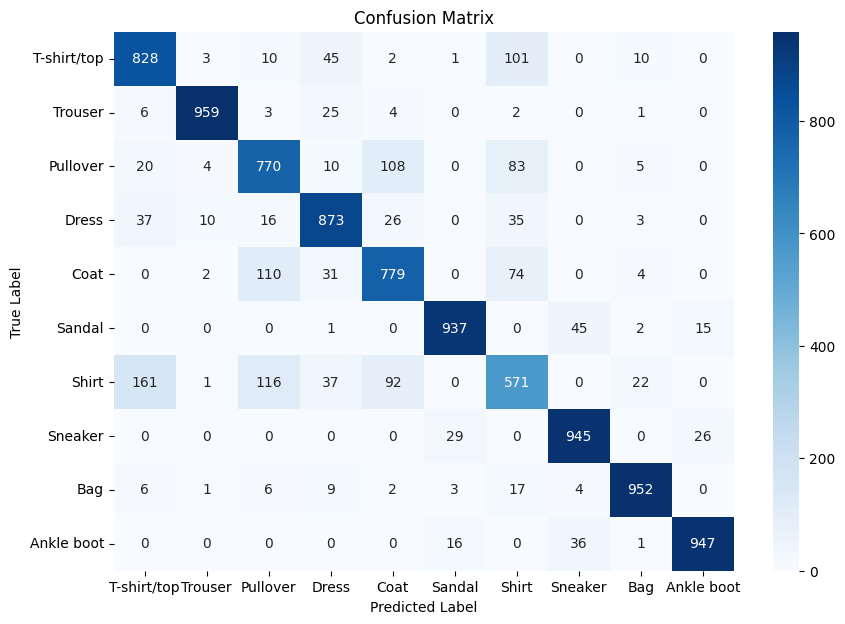

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import matplotlib.pyplot as plt

# Predict labels
y_pred_full_best = best_linear_full.predict(X_test_flat)

report = classification_report(y_test, y_pred_full_best, target_names=list(label_description.values()))
print(report)

cm = confusion_matrix(y_test, y_pred_full_best)
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

So sánh mô hình dữ liệu đầy đủ với mô hình đã giảm mẫu và tuning tham số C.

1. Độ chính xác và các chỉ số Precision, Recall, F1-Score:

* Mô hình có độ chính xác tổng thể tăng nhẹ từ 85% lên 86%.
* Các chỉ số macro average và weighted average của Precision, Recall, F1-Score cũng giữ nguyên mức 0.86.

2. Ma trận nhầm lẫn (Confusion Matrix):
* Một số lớp có sự thay đổi nhỏ trong số lượng dự đoán nhưng các lỗi chính vẫn nằm ở các lớp như Pullover, Shirt, T-shirt/top, cho thấy các lớp khó phân loại.

Kết luận:
Việc tuning như vậy giúp cải thiện hiệu suất tương đối và tối ưu hoá tài nguyên tính toán.


**PCA + Linear SVM**

In [ ]:
# Load đối tượng từ file .pickle
with open('best_pca_linear_svm.pkl', 'rb') as file:
    best_pca_linear = pickle.load(file)

# In kết quả từ đối tượng đã load
print("Best Cross-Validation Score:", best_pca_linear.best_score_)
print("Best Parameters:", best_pca_linear.best_params_)

# Khởi động bộ đếm thời gian
start_time = time.time()

# Huấn luyện lại mô hình với hyperparameter tối ưu
best_pca_linear_svm = best_pca_linear.best_estimator_
best_pca_linear_svm.fit(X_train_pca, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

# Load đối tượng từ file .pickle
with open('best_linear_svm.pkl', 'rb') as file:
    best_linear_svm = pickle.load(file)

Best Cross-Validation Score: 0.8562999842807139
Best Parameters: {'C': 0.1, 'decision_function_shape': 'ovo', 'kernel': 'linear'}
Thời gian huấn luyện model: 136.71 giây


              precision    recall  f1-score   support

 T-shirt/top       0.80      0.83      0.82      1000
     Trouser       0.98      0.96      0.97      1000
    Pullover       0.75      0.76      0.76      1000
       Dress       0.85      0.89      0.87      1000
        Coat       0.76      0.76      0.76      1000
      Sandal       0.95      0.93      0.94      1000
       Shirt       0.65      0.58      0.61      1000
     Sneaker       0.91      0.94      0.93      1000
         Bag       0.95      0.96      0.95      1000
  Ankle boot       0.96      0.94      0.95      1000

    accuracy                           0.86     10000
   macro avg       0.85      0.86      0.86     10000
weighted avg       0.85      0.86      0.86     10000



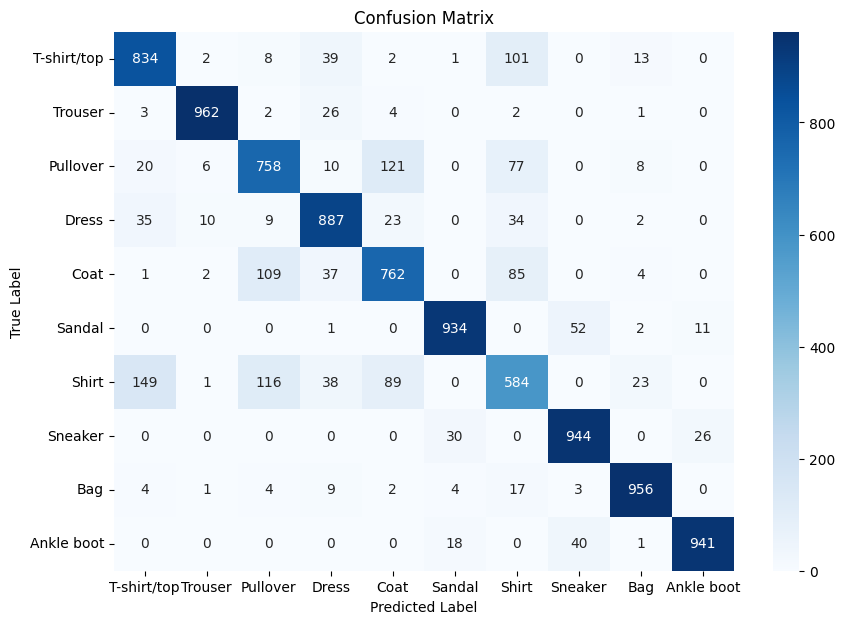

In [ ]:
# Predict labels according
y_pred_pca_best = best_pca_linear_svm.predict(X_test_pca)

report = classification_report(y_test, y_pred_pca_best, target_names=list(label_description.values()))
print(report)

cm = confusion_matrix(y_test, y_pred_pca_best)
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

So sánh mô hình dữ liệu giảm chiều PCA với mô hình đã tuning tham số C và giảm chiều PCA	.

1. Độ chính xác và các chỉ số Precision, Recall, F1-Score:

* Sau khi tuning tham số C, độ chính xác tổng thể đã tăng từ 0.85 lên 0.86.
* Các chỉ số macro average và weighted average của Precision, Recall, F1-Score có sự tăng nhẹ. Đặc biệt ở lớp T-shirt/top, Pullover, Coat các chỉ số này đã có sự cải thiện.
Điều này thể hiện rằng tuning đã giúp mô hình phân loại tốt hơn ở một số loại sản phẩm.

2. Ma trận nhầm lẫn (Confusion Matrix):
* Một số hạng mục như T-shirt/top, Pullover, và Coat cho thấy sự giảm nhẹ trong các nhầm lẫn với các lớp khác.
* Lỗi giữa Shirt và T-shirt/top, cũng như giữa Pullover và Coat đã giảm, điều này có thể do tuning đã giúp mô hình phân biệt rõ hơn giữa các lớp này.

Kết luận:
Việc tuning như vậy giúp cải thiện hiệu suất mô hình và tối ưu hoá tài nguyên tính toán.

**LDA + Linear SVM**

In [ ]:
# Load đối tượng từ file .pickle
with open('best_lda_linear_svm.pkl', 'rb') as file:
    best_lda_linear = pickle.load(file)

# In kết quả từ đối tượng đã load
print("Best Cross-Validation Score:", best_lda_linear.best_score_)
print("Best Parameters:", best_lda_linear.best_params_)

# Khởi động bộ đếm thời gian
start_time = time.time()

# Huấn luyện lại mô hình với hyperparameter tối ưu
best_lda_linear_svm = best_lda_linear.best_estimator_
best_lda_linear_svm.fit(X_train_lda, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

Best Cross-Validation Score: 0.8431833333333333
Best Parameters: {'C': 10, 'decision_function_shape': 'ovo', 'kernel': 'linear'}
Thời gian huấn luyện model: 131.60 giây


              precision    recall  f1-score   support

 T-shirt/top       0.78      0.81      0.79      1000
     Trouser       0.98      0.95      0.97      1000
    Pullover       0.71      0.69      0.70      1000
       Dress       0.82      0.86      0.84      1000
        Coat       0.70      0.76      0.73      1000
      Sandal       0.92      0.88      0.90      1000
       Shirt       0.60      0.54      0.57      1000
     Sneaker       0.88      0.92      0.90      1000
         Bag       0.92      0.94      0.93      1000
  Ankle boot       0.92      0.91      0.92      1000

    accuracy                           0.83     10000
   macro avg       0.82      0.83      0.82     10000
weighted avg       0.82      0.83      0.82     10000



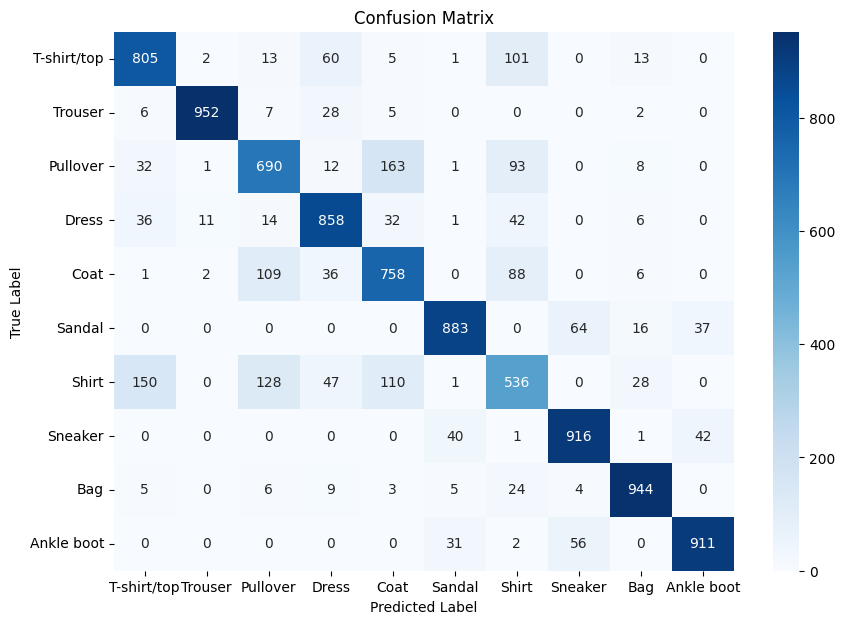

In [ ]:
# Predict labels according
y_pred_lda_best = best_lda_linear_svm.predict(X_test_lda)

report = classification_report(y_test, y_pred_lda_best, target_names=list(label_description.values()))
print(report)

cm = confusion_matrix(y_test, y_pred_lda_best)
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

So sánh mô hình dữ liệu giảm chiều LDA với mô hình đã tuning tham số C và giảm chiều LDA	.

1. Độ chính xác và các chỉ số Precision, Recall, F1-Score:

* Cả hai mô hình đều đạt độ chính xác tổng thể 83%.
* Các chỉ số macro average và weighted average của Precision, Recall, F1-Score vẫn giữ nguyên ở mức 0.82.

2. Ma trận nhầm lẫn (Confusion Matrix):
* Một số hạng mục như T-shirt/top, Pullover, và Coat cho thấy sự dao động trong số lượng dự đoán.
* Các lỗi chính vẫn nằm ở các lớp như Pullover, Shirt và T-shirt/top, cho thấy đây là các lớp khó phân loại.

Kết luận:
Việc tuning như vậy giúp duy trì hiệu suất ổn định nhưng không cải thiện. Điều này cho thấy mô hình có thể đã đạt giới hạn về hiệu suất với cấu trúc hiện tại và tập dữ liệu đang dùng.

### RBF SVM

#### Giới thiệu về RBF Kernel trong SVM

**Radial Basis Function (RBF) Kernel** là một loại kernel phi tuyến phổ biến trong SVM, đặc biệt hiệu quả trên các bài toán với dữ liệu phức tạp và không tách rời tuyến tính. Công thức của RBF kernel được định nghĩa như sau:

$$
K(x, x') = \exp\left(-\gamma \|x - x'\|^2\right)
$$

Trong đó:
- γ : Là tham số điều chỉnh độ ảnh hưởng của một điểm dữ liệu đơn lẻ. Giá trị của γ càng lớn thì mô hình càng nhạy cảm với các điểm gần, tạo ra một ranh giới phức tạp và dễ dẫn đến overfitting. Khi γ thấp, ranh giới sẽ mượt mà hơn.
- C: Là tham số phạt, điều chỉnh mức độ cho phép các điểm dữ liệu bị phân loại sai. Giá trị C càng cao sẽ tập trung vào việc phân loại chính xác các điểm huấn luyện, nhưng có thể dẫn đến overfitting nếu quá lớn.

RBF kernel hoạt động rất tốt trong các bài toán phi tuyến, bởi vì nó có thể biến đổi không gian dữ liệu, cho phép SVM tìm được ranh giới quyết định phức tạp. Tuy nhiên, việc lựa chọn tham số C và γ phù hợp rất quan trọng để đạt hiệu suất tối ưu.


### RBF SVM + Full dimension

In [ ]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
# Khởi động bộ đếm thời gian
start_time = time.time()

# Tạo mô hình SVM với kernel RBF')
rbf_svm = SVC(kernel='rbf', C=1.0, gamma='scale', decision_function_shape = 'ovo')
rbf_svm.fit(X_train_flat, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

Thời gian huấn luyện model: 402.17 giây


              precision    recall  f1-score   support

 T-shirt/top       0.83      0.86      0.84      1000
     Trouser       0.99      0.96      0.98      1000
    Pullover       0.79      0.82      0.80      1000
       Dress       0.87      0.89      0.88      1000
        Coat       0.81      0.81      0.81      1000
      Sandal       0.96      0.95      0.96      1000
       Shirt       0.72      0.65      0.69      1000
     Sneaker       0.93      0.95      0.94      1000
         Bag       0.97      0.98      0.97      1000
  Ankle boot       0.96      0.95      0.96      1000

    accuracy                           0.88     10000
   macro avg       0.88      0.88      0.88     10000
weighted avg       0.88      0.88      0.88     10000

Thời gian đánh giá: 244.1933 giây


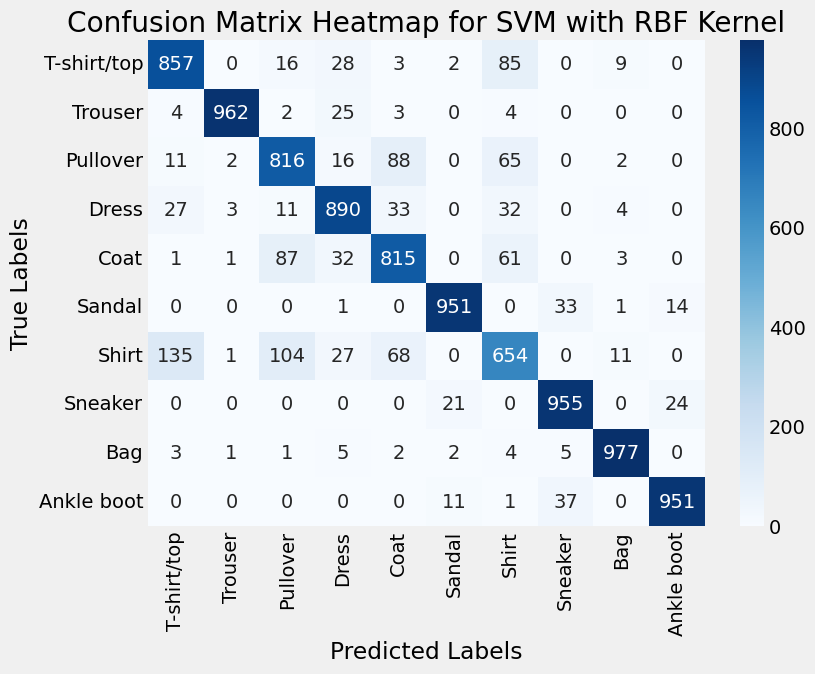

In [ ]:
# Dự đoán trên tập kiểm tra
start_time = time.time()  # Bắt đầu thời gian
y_pred_rbf_full = rbf_svm.predict(X_test_flat)
end_time = time.time()  # Kết thúc thời gian

# In báo cáo phân loại
report = classification_report(y_test, y_pred_rbf_full, target_names=list(label_description.values()))
print(report)

# In thời gian đánh giá
evaluation_time = end_time - start_time
print(f"Thời gian đánh giá: {evaluation_time:.4f} giây")

# Tạo ma trận nhầm lẫn (confusion matrix)
conf_matrix = confusion_matrix(y_test, y_pred_rbf_full)

# Vẽ heatmap cho ma trận nhầm lẫn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(label_description.values()),
            yticklabels=list(label_description.values()))
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix Heatmap for SVM with RBF Kernel")
plt.show()

#### Nhận xét về Kết quả của SVM với RBF Kernel trên Dữ liệu Full Dimensional

1. **Độ Chính Xác Chung**:
   - Mô hình đạt **độ chính xác tổng thể là 88%**, thể hiện hiệu quả phân loại rất tốt trên dữ liệu với 784 chiều.
   - Các chỉ số precision, recall, và f1-score trung bình cũng đều đạt khoảng 0.88, cho thấy sự cân bằng giữa khả năng phát hiện chính xác các lớp và việc giảm thiểu các phân loại sai.

2. **Hiệu Suất Theo Từng Lớp**:
   - Mô hình hoạt động tốt nhất trên các lớp như **“Trouser”**, **“Sandal”**, **“Bag”**, và **“Ankle boot”**, với precision và recall đạt khoảng 0.96 - 0.99. Điều này cho thấy mô hình dễ dàng nhận diện được các đặc điểm đặc trưng của các lớp này.
   - Lớp **“Shirt”** có hiệu suất thấp nhất với precision là 0.72 và recall là 0.65. Điều này có thể là do đặc điểm của lớp "Shirt" chồng chéo với các lớp khác (như “Pullover” hoặc “Coat”), khiến mô hình khó phân biệt.

3. **Ma Trận Nhầm Lẫn**:
   - Quan sát ma trận nhầm lẫn cho thấy các lỗi phân loại chủ yếu xảy ra giữa các lớp có đặc điểm tương tự, chẳng hạn như:
     - **“Shirt”** và **“Coat”** có số lượng nhầm lẫn cao, với nhiều điểm của lớp “Shirt” bị dự đoán sai thành “Coat”.
     - **“Pullover”** và **“Coat”** cũng có một số nhầm lẫn, điều này có thể giải thích bởi đặc điểm hình dạng hoặc màu sắc của các sản phẩm tương đồng trong tập dữ liệu.
   - Các lớp dễ phân biệt như **“Trouser”** và **“Sandal”** có rất ít hoặc không có lỗi phân loại, cho thấy mô hình nhận diện các đặc điểm rõ ràng của các lớp này khá tốt.

4. **Đánh Giá Tổng Thể**:
   - **SVM với kernel RBF** hoạt động rất tốt trên dữ liệu full dimensional, cho thấy khả năng xử lý và phân loại dữ liệu phức tạp với chiều cao.
   - Mặc dù vậy, một số lớp như “Shirt” vẫn gặp khó khăn do sự tương đồng với các lớp khác, dẫn đến một số lỗi nhầm lẫn.
   - Nếu cần tối ưu hơn, có thể xem xét các phương pháp xử lý hoặc giảm chiều khác (như PCA kết hợp với tuning tham số gamma và C cho RBF) để tìm ra ranh giới phân loại tốt hơn cho các lớp khó phân biệt.

#### Kết Luận

Kết quả này cho thấy hiệu quả của RBF kernel trong SVM trên dữ liệu phức tạp với nhiều chiều, nhưng cũng nêu bật một số giới hạn khi các lớp có sự chồng chéo về đặc điểm. Việc điều chỉnh thêm các tham số hoặc kết hợp với các kỹ thuật phân tích đặc trưng có thể giúp cải thiện hơn nữa hiệu suất phân loại.


### SVM RBF + PCA

In [ ]:
# Khởi động bộ đếm thời gian
start_time = time.time()

# Tạo mô hình SVM với kernel RBF
rbf_svm_pca = SVC(kernel='rbf', C=1.0, gamma='scale', decision_function_shape = 'ovo')
rbf_svm_pca.fit(X_train_pca, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

Thời gian huấn luyện model: 146.02 giây


Thời gian dự đoán (evaluation time) model SVM_RBF_PCA: 84.93 giây
              precision    recall  f1-score   support

 T-shirt/top       0.83      0.86      0.84      1000
     Trouser       0.99      0.96      0.98      1000
    Pullover       0.80      0.82      0.81      1000
       Dress       0.88      0.89      0.88      1000
        Coat       0.81      0.82      0.82      1000
      Sandal       0.97      0.95      0.96      1000
       Shirt       0.71      0.66      0.69      1000
     Sneaker       0.93      0.96      0.95      1000
         Bag       0.97      0.97      0.97      1000
  Ankle boot       0.97      0.95      0.96      1000

    accuracy                           0.89     10000
   macro avg       0.89      0.89      0.89     10000
weighted avg       0.89      0.89      0.89     10000



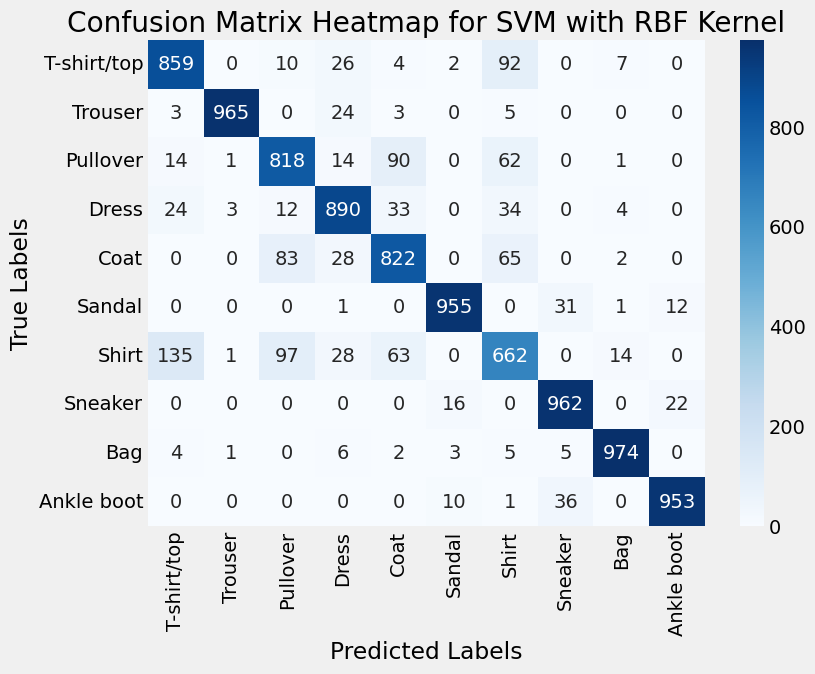

In [ ]:
# Khởi động bộ đếm thời gian
start_time = time.time()

# Dự đoán trên tập kiểm tra
y_pred_rbf_pca = rbf_svm_pca.predict(X_test_pca)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian dự đoán
eval_time = end_time - start_time
print("Thời gian dự đoán (evaluation time) model SVM_RBF_PCA: {:.2f} giây".format(eval_time))

# In báo cáo phân loại
report = classification_report(y_test, y_pred_rbf_pca, target_names=list(label_description.values()))
print(report)

# Tạo ma trận nhầm lẫn (confusion matrix)
conf_matrix = confusion_matrix(y_test, y_pred_rbf_pca)

# Vẽ heatmap cho ma trận nhầm lẫn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(label_description.values()),
            yticklabels=list(label_description.values()))
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix Heatmap for SVM with RBF Kernel")
plt.show()

Hiệu suất tổng quan với accuracy, precision, recall, f1-score đều 0.89 (cải thiện nhẹ, tăng từ 0.88 lên 0.89). Cho thấy PCA giữ lại 95% không làm giảm hiệu suất tổng thể, nhưng vẫn giữ lại các thông tin quan trọng nhất từ dữ liệu, cải thiện tốc độ huấn luyện.

Nhận xét Confusion Matrix:
- Các lớp có mức độ nhầm lẫn vẫn giữ tương tự như trên bộ full dimension.
- Các lớp **T-shirt/top, Shirt, Pullover và Coat** vẫn còn bị nhầm lẫn rất cao, đặc biệt là Shirt với T-shirt/top, do đặc điểm giữa chúng dễ bị chồng lấn.

Thông số phân loại
- Một số lớp cải thiện nhẹ (Pullover, Coat, Sneaker: đều tăng 0.01)
- Các lớp còn lại đều không thay đổi. Shirt vẫn là lớp yếu nhất (f1-score chỉ 0.71 và 0.72 trên cả 2 tập data)

Nguyên nhân và ý nghĩa
- PCA đã giúp giảm nhiễu (noise) và làm nổi bật hơn các đặc trưng quan trọng, nên f1-score của một số lớp có cải thiện nhẹ.

- PCA giúp giảm chiều nhưng không thể khắc phục được vấn đề phân tách các lớp có đặc điểm tương đồng, như giữa Shirt, T-shirt, Pullover và Coat, chứng tỏ rằng những đặc trưng của các lớp này có sự chồng lấn lớn, và việc giảm chiều bằng PCA không giúp cải thiện đáng kể vấn đề này.

**Tổng kết**: PCA giúp giảm chiều, cải thiện tốc độ và giữ nguyên hiệu suất tổng thể của model. Tuy nhiên, nó không giúp giải quyết vấn đề phân biệt các đặc điểm tương đồn, đặc biệt là giữa các loại áo (Shirt, Pullover, T-shirt).

### SVM RBF + LDA


In [ ]:
# Khởi động bộ đếm thời gian
start_time = time.time()

# Tạo mô hình SVM với kernel RBF
rbf_svm_lda = SVC(kernel='rbf', C=1.0, gamma='scale', decision_function_shape = 'ovo')
rbf_svm_lda.fit(X_train_lda, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

Thời gian huấn luyện model: 28.67 giây


Thời gian dự đoán (evaluation time) model SVM_RBF_LDA: 18.88 giây
              precision    recall  f1-score   support

 T-shirt/top       0.78      0.82      0.80      1000
     Trouser       0.99      0.95      0.97      1000
    Pullover       0.73      0.71      0.72      1000
       Dress       0.83      0.87      0.85      1000
        Coat       0.70      0.79      0.74      1000
      Sandal       0.93      0.89      0.91      1000
       Shirt       0.64      0.51      0.57      1000
     Sneaker       0.88      0.93      0.90      1000
         Bag       0.92      0.95      0.93      1000
  Ankle boot       0.93      0.91      0.92      1000

    accuracy                           0.83     10000
   macro avg       0.83      0.83      0.83     10000
weighted avg       0.83      0.83      0.83     10000



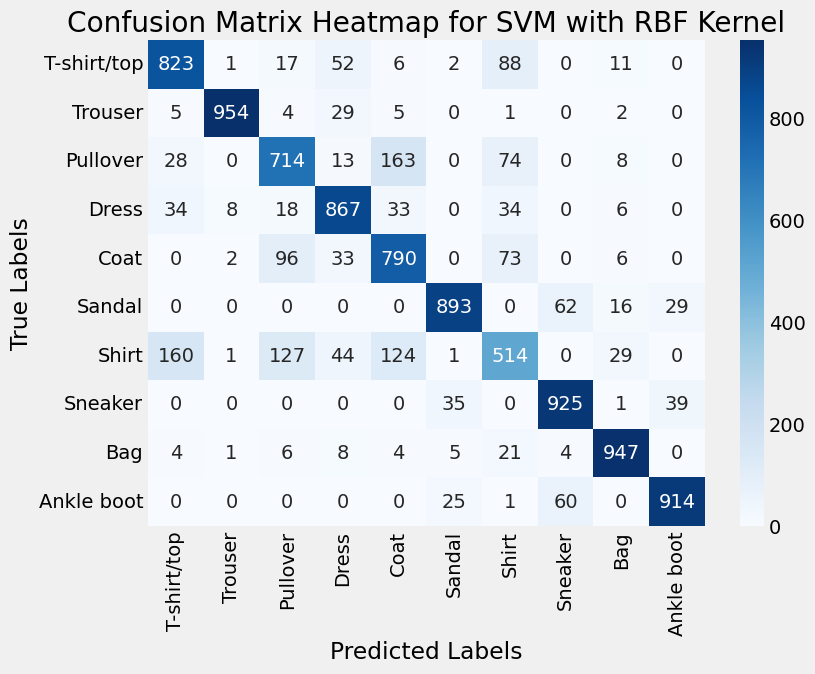

In [ ]:
# Khởi động bộ đếm thời gian
start_time = time.time()

# Dự đoán trên tập kiểm tra
y_pred_rbf_lda = rbf_svm_lda.predict(X_test_lda)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian dự đoán
eval_time = end_time - start_time
print("Thời gian dự đoán (evaluation time) model SVM_RBF_LDA: {:.2f} giây".format(eval_time))

# In báo cáo phân loại
report = classification_report(y_test, y_pred_rbf_lda, target_names=list(label_description.values()))
print(report)

# Tạo ma trận nhầm lẫn (confusion matrix)
conf_matrix = confusion_matrix(y_test, y_pred_rbf_lda)

# Vẽ heatmap cho ma trận nhầm lẫn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(label_description.values()),
            yticklabels=list(label_description.values()))
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix Heatmap for SVM with RBF Kernel")
plt.show()

**Hiệu suất tổng quan với LDA:**
Độ chính xác (accuracy) tổng thể là `0.83`, thấp hơn so với dữ liệu đầy đủ (`0.88`). Điều này cho thấy giảm chiều bằng LDA dẫn đến mất mát thông tin, làm giảm hiệu suất phân loại.

**Nhận xét Confusion Matrix:**
* Mức độ nhầm lẫn của một số lớp tăng lên rõ rệt so với dữ liệu đầy đủ.
* Các lớp **Shirt**, **Pullover**, và **Coat** có sự nhầm lẫn cao, đặc biệt là với các lớp có đặc trưng tương đồng như **T-shirt/top** và **Dress**.

**Thông số phân loại:**
* **Shirt** là lớp yếu nhất với F1-score chỉ đạt 0.64 khi sử dụng LDA, cho thấy sự nhầm lẫn cao với các lớp **T-shirt/top** và **Pullover**.
* **Sneaker**, **Bag**, và **Ankle boot** duy trì được hiệu suất khá tốt, với số lượng mẫu phân loại sai thấp và F1-score cao.

**Nguyên nhân:**
* LDA giúp giảm chiều và loại bỏ các chiều ít quan trọng, nhưng cũng khiến mất đi các đặc trưng cần thiết để phân tách chính xác các lớp có đặc trưng gần nhau.
* Điều này dẫn đến nhầm lẫn tăng lên đối với các lớp có đặc trưng tương đồng, như **Shirt**, **Pullover**, và **T-shirt/top**.

**Tổng kết:**
LDA giúp giảm chiều và cải thiện tốc độ huấn luyện, nhưng làm giảm khả năng phân loại, đặc biệt với các lớp có đặc trưng gần nhau, khiến việc phân biệt các lớp này trở nên khó khăn hơn.

### Tuning RBF SVM

#### Undersampling

In [ ]:
import pandas as pd
import numpy as np
import time
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, f1_score
import matplotlib.pyplot as plt
from sklearn.model_selection import StratifiedKFold
import csv

In [ ]:
# Tạo DataFrame từ dữ liệu hiện có
xtrn_ytrn_data = pd.DataFrame(data=X_train_flat)
xtrn_ytrn_data['class'] = y_train

# Biến lưu trữ kết quả cho việc vẽ biểu đồ
accuracies = []
train_times = []

# Danh sách các kích thước mẫu tổng bạn muốn thử nghiệm
total_sample_sizes = [10000, 20000, 30000, 40000]

# Sử dụng StratifiedKFold cho Cross Validation
skf = StratifiedKFold(n_splits=4, shuffle=True, random_state=42)

# Tạo file CSV để lưu kết quả
with open('training_results_rbf.csv', mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['Sample Size', 'Training Time (s)', 'Validation Accuracy', 'Validation F1-score'])

    # Lặp qua các kích thước mẫu tổng
    for total_samples in total_sample_sizes:
        samples_per_class = total_samples // 10  # số mẫu mỗi lớp

        # Tạo tập con nhỏ cho training từ tập còn lại
        X_train_small = xtrn_ytrn_data.groupby('class').apply(lambda x: x.sample(samples_per_class, random_state=42)).sample(frac=1, random_state=42).reset_index(drop=True)
        y_train_small = X_train_small['class'].values
        X_train_small = X_train_small.drop(columns='class').values  # Loại bỏ cột nhãn khỏi X_train_small

        # Sử dụng StratifiedKFold để chia nhỏ tập con nhỏ
        for train_index, val_index in skf.split(X_train_small, y_train_small):
            X_train_fold, X_val_fold = X_train_small[train_index], X_train_small[val_index]
            y_train_fold, y_val_fold = y_train_small[train_index], y_train_small[val_index]

            # Bắt đầu đếm thời gian huấn luyện
            start_time = time.time()

            # Tạo mô hình SVM với kernel RBF
            svm_model = SVC(kernel='rbf', decision_function_shape='ovo', C=1)
            svm_model.fit(X_train_fold, y_train_fold)  # Huấn luyện mô hình với tập con nhỏ

            # Kết thúc đếm thời gian huấn luyện
            training_time = time.time() - start_time

            # Dự đoán trên tập validation
            y_pred_val = svm_model.predict(X_val_fold)

            # Tính toán accuracy trên tập validation
            accuracy = accuracy_score(y_val_fold, y_pred_val)
            f1 = f1_score(y_val_fold, y_pred_val, average='weighted')

            # Lưu kết quả cho việc vẽ biểu đồ
            accuracies.append(accuracy)
            train_times.append(training_time)

            # Lưu kết quả vào file CSV
            writer.writerow([samples_per_class * 10, training_time, accuracy, f1])

            # In ra kết quả
            print(f"Sample size: {samples_per_class * 10} (total), Training Time: {training_time:.2f} seconds, Validation Accuracy: {accuracy:.4f}, Validation F1-score: {f1:.4f}")

In [ ]:
import plotly.subplots as sp
import plotly.graph_objects as go

# Đọc kết quả từ file CSV để vẽ biểu đồ
results = pd.read_csv('training_results_rbf.csv')

# Lấy giá trị trung bình cho mỗi sample size
results_avg = results.groupby('Sample Size').mean().reset_index()

fig = sp.make_subplots(rows=1, cols=2, subplot_titles=("Training Time vs Total Sample Size", "Validation Accuracy vs Total Sample Size"))
traces = [
    {'x': results_avg['Sample Size'], 'y': results_avg['Training Time (s)'], 'name': 'Training Time (s)', 'color': 'blue', 'row': 1, 'col': 1, 'yaxis_title': 'Training Time (s)'},
    {'x': results_avg['Sample Size'], 'y': results_avg['Validation Accuracy'], 'name': 'Validation Accuracy', 'color': 'red', 'row': 1, 'col': 2, 'yaxis_title': 'Validation Accuracy'}
]

for trace in traces:
    fig.add_trace(go.Scatter(
        x=trace['x'], y=trace['y'],
        mode='lines+markers', name=trace['name'], line=dict(width=3, color=trace['color'])
    ), row=trace['row'], col=trace['col'])

    # Cập nhật tiêu đề cho các trục
    fig.update_xaxes(title_text='Total Sample Size', row=trace['row'], col=trace['col'])
    fig.update_yaxes(title_text=trace['yaxis_title'], row=trace['row'], col=trace['col'])

# Cập nhật layout để hiển thị hai biểu đồ bên cạnh nhau
fig.update_layout(
    width=1200,
    height=550,
)
fig.show()

<img src="https://github.com/ThuanLy-0092/NDM/raw/main/UndersamplingRBFSVM.png" alt="My Image" style="width: 700px;"/>


**Training Time vs Total Sample Size**
* Biểu đồ này cho thấy thời gian huấn luyện (training time) tăng gần như **tuyến tính** theo kích thước mẫu (total sample size) - Khi số lượng dữ liệu tăng lên, số lượng tính toán cần thiết để huấn luyện mô hình cũng tăng lên, dẫn đến thời gian cần thiết dài hơn.

**Validation Accuracy vs Total Sample Size**
* Biểu đồ này cho thấy độ chính xác kiểm định (validation accuracy) **tăng dần** khi kích thước mẫu tăng (total sample size).
* Điều này cho thấy rằng việc sử dụng thêm dữ liệu trong quá trình huấn luyện có thể giúp cải thiện khả năng học tập của mô hình và nâng cao độ chính xác của dự đoán.

**→ Khi tăng kích thước tập dữ liệu, thời gian huấn luyện tăng lên đáng kể, nhưng bù lại là sự cải thiện về độ chính xác của mô hình.**

**→ Theo như biểu đồ thể hiện thì ta sẽ chọn mốc 20,000 data.**

Tuy nhiên, **Undersampling** có thể hỗ trợ hiệu quả trong việc xác định các tham số tối ưu nhưng ta không thể sử dụng số lượng data đó (20,000 data) cho training được vì sẽ làm ảnh hưởng đến hiệu suất mô hình.

#### Hyperparameter Tuning

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
import pickle

In [ ]:
# Tạo DataFrame từ dữ liệu hiện có
xtrn_ytrn_data = pd.DataFrame(data=X_train_flat)
xtrn_ytrn_data['class'] = y_train

# Tạo tập con nhỏ cho training với 20,000 mẫu
total_samples = 20000
samples_per_class = total_samples // 10
# Tạo tập con nhỏ cho training
X_train_small = xtrn_ytrn_data.groupby('class').apply(lambda x: x.sample(samples_per_class, random_state=42)).sample(frac=1, random_state=42).reset_index(drop=True)
y_train_small = X_train_small['class'].values
X_train_small = X_train_small.drop(columns='class').values  # Loại bỏ cột nhãn

# Định nghĩa lưới tham số để tìm kiếm cho RBF kernel
param_grid = {
    'C': [1, 10, 100, 1000],
    'gamma': [0.01, 0.1, 1],
    'kernel': ['rbf'],
    'decision_function_shape': ['ovo'],
}

# Khởi tạo mô hình SVM
svm = SVC()

# Sử dụng GridSearchCV để tìm kiếm tham số tốt nhất
grid_search = GridSearchCV(svm, param_grid, cv=3, scoring='accuracy', n_jobs=-1, verbose=1)

# Tìm hyperparameter tối ưu
grid_search.fit(X_train_small, y_train_small)

# In kết quả hyperparameter tốt nhất
print("Best Parameters:", grid_search.best_params_)
print("Best Cross-Validation Score:", grid_search.best_score_)

# Lưu kết quả GridSearchCV vào file .pickle
with open('best_rbf_svm.pkl', 'wb') as file:
    pickle.dump(grid_search, file)


In [ ]:
# Tạo DataFrame từ dữ liệu PCA hiện có
xtrn_ytrn_data_pca = pd.DataFrame(data=X_train_pca)
xtrn_ytrn_data_pca['class'] = y_train

# Tạo tập con nhỏ cho training với 20,000 mẫu
total_samples = 20000
samples_per_class = total_samples // 10
X_train_small = xtrn_ytrn_data_pca.groupby('class').apply(lambda x: x.sample(samples_per_class, random_state=42)).sample(frac=1, random_state=42).reset_index(drop=True)
y_train_small = X_train_small['class'].values
X_train_small = X_train_small.drop(columns='class').values  # Loại bỏ cột nhãn

# Định nghĩa lưới tham số cho kernel RBF
param_grid = {
    'C': [1, 10, 100],
    'gamma': [0.01, 0.1, 1],
    'kernel': ['rbf'],
    'decision_function_shape': ['ovo'],
}

# Khởi tạo mô hình SVM
svm = SVC()

# Sử dụng GridSearchCV để tìm kiếm tham số tốt nhất
grid_search = GridSearchCV(svm, param_grid, cv=3, scoring='accuracy', n_jobs=-1, verbose=1)

# Tìm hyperparameter tối ưu
grid_search.fit(X_train_small, y_train_small)

# In kết quả tham số tốt nhất
print("Best Parameters:", grid_search.best_params_)
print("Best Cross-Validation Score:", grid_search.best_score_)

# Lưu kết quả GridSearchCV vào file .pickle
with open('best_rbf_svm_pca.pkl', 'wb') as file:
    pickle.dump(grid_search, file)

In [ ]:
# Tạo DataFrame từ dữ liệu LDA hiện có
xtrn_ytrn_data_lda = pd.DataFrame(data=X_train_lda)
xtrn_ytrn_data_lda['class'] = y_train

# Tạo tập con nhỏ cho training với 20,000 mẫu
total_samples = 20000
samples_per_class = total_samples // 10
X_train_small = xtrn_ytrn_data_lda.groupby('class').apply(lambda x: x.sample(samples_per_class, random_state=42)).sample(frac=1, random_state=42).reset_index(drop=True)
y_train_small = X_train_small['class'].values
X_train_small = X_train_small.drop(columns='class').values  # Loại bỏ cột nhãn

# Định nghĩa lưới tham số cho kernel RBF
param_grid = {
    'C': [1, 10, 100],
    'gamma': [0.01, 0.1, 1],  # Thêm gamma cho kernel RBF
    'kernel': ['rbf'],
    'decision_function_shape': ['ovo'],
}

# Khởi tạo mô hình SVM
svm = SVC()

# Sử dụng GridSearchCV để tìm kiếm tham số tốt nhất
grid_search = GridSearchCV(svm, param_grid, cv=3, scoring='accuracy', n_jobs=-1, verbose=1)

# Tìm hyperparameter tối ưu
grid_search.fit(X_train_small, y_train_small)

# In kết quả tham số tốt nhất
print("Best Parameters:", grid_search.best_params_)
print("Best Cross-Validation Score:", grid_search.best_score_)

# Lưu kết quả GridSearchCV vào file .pickle
with open('best_rbf_svm_lda.pkl', 'wb') as file:
    pickle.dump(grid_search, file)

#### Huấn luyện lại mô hình với hyperparameter tối ưu

**Full dimension + RBF SVM**

In [ ]:
# Load đối tượng từ file .pickle
with open('best_rbf_svm.pkl', 'rb') as file:
    best_rbf_svm = pickle.load(file)

# In kết quả từ đối tượng đã load
print("Best Cross-Validation Score:", best_rbf_svm.best_score_)
print("Best Parameters:", best_rbf_svm.best_params_)

# Khởi động bộ đếm thời gian
start_time = time.time()

# Huấn luyện lại mô hình với hyperparameter tối ưu
best_rbf = best_rbf_svm.best_estimator_
best_rbf.fit(X_train_flat, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:376: InconsistentVersionWarning:

Trying to unpickle estimator SVC from version 1.5.0 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:376: InconsistentVersionWarning:

Trying to unpickle estimator GridSearchCV from version 1.5.0 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations



Best Cross-Validation Score: 0.8831498269070944
Best Parameters: {'C': 10, 'decision_function_shape': 'ovo', 'gamma': 0.01, 'kernel': 'rbf'}
Thời gian huấn luyện model: 362.18 giây


              precision    recall  f1-score   support

 T-shirt/top       0.84      0.85      0.84      1000
     Trouser       0.99      0.97      0.98      1000
    Pullover       0.81      0.84      0.82      1000
       Dress       0.90      0.91      0.91      1000
        Coat       0.83      0.83      0.83      1000
      Sandal       0.97      0.97      0.97      1000
       Shirt       0.75      0.72      0.73      1000
     Sneaker       0.95      0.96      0.96      1000
         Bag       0.98      0.98      0.98      1000
  Ankle boot       0.97      0.96      0.97      1000

    accuracy                           0.90     10000
   macro avg       0.90      0.90      0.90     10000
weighted avg       0.90      0.90      0.90     10000



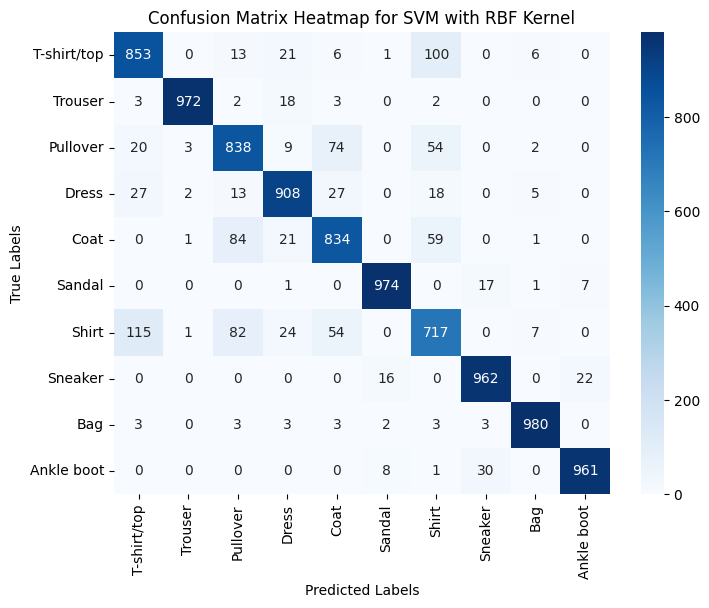

In [ ]:
# Dự đoán trên tập test
y_pred_best_rbf = best_rbf.predict(X_test_flat)

# In báo cáo phân loại
report = classification_report(y_test, y_pred_best_rbf, target_names=list(label_description.values()))
print(report)


# Tạo ma trận nhầm lẫn (confusion matrix)
conf_matrix = confusion_matrix(y_test, y_pred_best_rbf)

# Vẽ heatmap cho ma trận nhầm lẫn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=list(label_description.values()),
            yticklabels=list(label_description.values()))
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix Heatmap for SVM with RBF Kernel")
plt.show()


So sánh mô hình dữ liệu đầy đủ với mô hình đã tuning tham số C.

1. Độ chính xác và các chỉ số Precision, Recall, F1-Score:

* Mô hình sau khi tuning đạt độ chính xác tăng nhẹ từ 88% lên 90%.
* Các chỉ số macro average và weighted average của Precision, Recall, F1-Score cũng tăng nhẹ từ 0.88 lên 0.90. Cho thấy hiệu suất tổng thể của mô hình có cải thiện một chút sau khi tuning.

2. Ma trận nhầm lẫn (Confusion Matrix):
* Các lỗi nhầm lẫn lớn vẫn xảy ra ở các lớp như Shirt và T-shirt/top, cho thấy đây là những lớp khó phân loại chính xác.

Kết luận:
Việc tuning như vậy đã giúp cải thiện nhẹ hiệu suất ở một số lớp nhưng không ảnh hưởng đến độ chính xác tổng thể. Mô hình đã đạt ngưỡng hiệu suất ổn định.

**PCA + RBF SVM**

In [ ]:
# Load đối tượng từ file .pickle
with open('best_rbf_svm_pca.pkl', 'rb') as file:
    best_rbf_svm_pca = pickle.load(file)

# In kết quả từ đối tượng đã load
print("Best Cross-Validation Score:", best_rbf_svm_pca.best_score_)
print("Best Parameters:", best_rbf_svm_pca.best_params_)

# Khởi động bộ đếm thời gian
start_time = time.time()

# Huấn luyện lại mô hình với hyperparameter tối ưu
best_rbf_pca = best_rbf_svm_pca.best_estimator_
best_rbf_pca.fit(X_train_pca, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:376: InconsistentVersionWarning:

Trying to unpickle estimator SVC from version 1.5.0 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:376: InconsistentVersionWarning:

Trying to unpickle estimator GridSearchCV from version 1.5.0 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations



Best Cross-Validation Score: 0.8824498019023442
Best Parameters: {'C': 10, 'decision_function_shape': 'ovo', 'gamma': 0.01, 'kernel': 'rbf'}
Thời gian huấn luyện model: 125.38 giây


              precision    recall  f1-score   support

 T-shirt/top       0.84      0.86      0.85      1000
     Trouser       0.99      0.97      0.98      1000
    Pullover       0.81      0.83      0.82      1000
       Dress       0.89      0.91      0.90      1000
        Coat       0.83      0.83      0.83      1000
      Sandal       0.98      0.97      0.97      1000
       Shirt       0.75      0.70      0.73      1000
     Sneaker       0.95      0.98      0.96      1000
         Bag       0.98      0.98      0.98      1000
  Ankle boot       0.98      0.96      0.97      1000

    accuracy                           0.90     10000
   macro avg       0.90      0.90      0.90     10000
weighted avg       0.90      0.90      0.90     10000



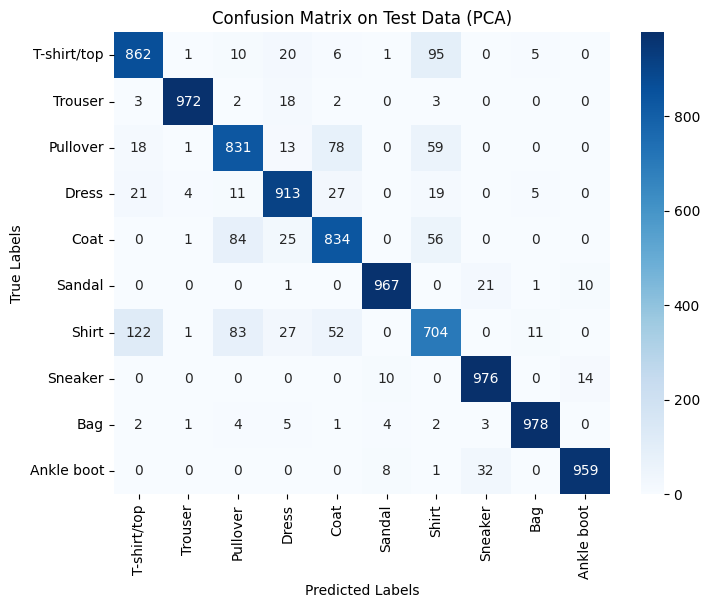

In [ ]:
y_pred_best_pca = best_rbf_pca.predict(X_test_pca)

# In báo cáo phân loại
report = classification_report(y_test, y_pred_best_pca, target_names=list(label_description.values()))
print(report)

conf_matrix = confusion_matrix(y_test, y_pred_best_pca)
# Vẽ confusion matrix với heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix on Test Data (PCA)')
plt.show()

So sánh mô hình dữ liệu giảm chiều PCA với mô hình đã tuning tham số C và giảm chiều PCA.

1. Độ chính xác và các chỉ số Precision, Recall, F1-Score:

* Mô hình sau khi tuning đạt độ chính xác tăng nhẹ từ 88% lên 90%.
* Các chỉ số macro average và weighted average của Precision, Recall, F1-Score cũng tăng nhẹ từ 0.88 lên 0.90.
Cho thấy hiệu suất tổng thể của mô hình có cải thiện một chút sau khi tuning.

2. Ma trận nhầm lẫn (Confusion Matrix):
* Sau khi tuning, số lượng dự đoán đúng tăng ở một số lớp.
* Tuy nhiên, các lỗi chính vẫn nằm ở các lớp như Shirt và T-shirt/top.

Kết luận:
Việc tuning như vậy đã giúp cải thiện nhẹ hiệu suất tổng thể của mô hình, nâng độ chính xác lên 89%. Điều này cho thấy tham số C có ảnh hưởng tích cực đến mô hình.

**LDA + RBF SVM**

In [ ]:
# Load đối tượng từ file .pickle
with open('best_rbf_svm_lda.pkl', 'rb') as file:
    best_rbf_svm_lda = pickle.load(file)

# In kết quả từ đối tượng đã load
print("Best Cross-Validation Score:", best_rbf_svm_lda.best_score_)
print("Best Parameters:", best_rbf_svm_lda.best_params_)

# Khởi động bộ đếm thời gian
start_time = time.time()

# Dự đoán trên tập test LDA
best_rbf_lda = best_rbf_svm_lda.best_estimator_
best_rbf_lda.fit(X_train_lda, y_train)

# Kết thúc bộ đếm thời gian
end_time = time.time()

# Tính toán và in ra thời gian huấn luyện
training_time = end_time - start_time
print("Thời gian huấn luyện model: {:.2f} giây".format(training_time))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:376: InconsistentVersionWarning:

Trying to unpickle estimator SVC from version 1.5.0 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:376: InconsistentVersionWarning:

Trying to unpickle estimator GridSearchCV from version 1.5.0 when using version 1.5.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations



Best Cross-Validation Score: 0.8480497667285852
Best Parameters: {'C': 1, 'decision_function_shape': 'ovo', 'gamma': 0.1, 'kernel': 'rbf'}
Thời gian huấn luyện model: 35.45 giây


              precision    recall  f1-score   support

 T-shirt/top       0.78      0.82      0.80      1000
     Trouser       0.99      0.96      0.97      1000
    Pullover       0.73      0.72      0.72      1000
       Dress       0.83      0.87      0.85      1000
        Coat       0.71      0.78      0.74      1000
      Sandal       0.94      0.90      0.92      1000
       Shirt       0.64      0.53      0.58      1000
     Sneaker       0.88      0.93      0.90      1000
         Bag       0.92      0.95      0.93      1000
  Ankle boot       0.94      0.92      0.93      1000

    accuracy                           0.84     10000
   macro avg       0.83      0.84      0.83     10000
weighted avg       0.83      0.84      0.83     10000



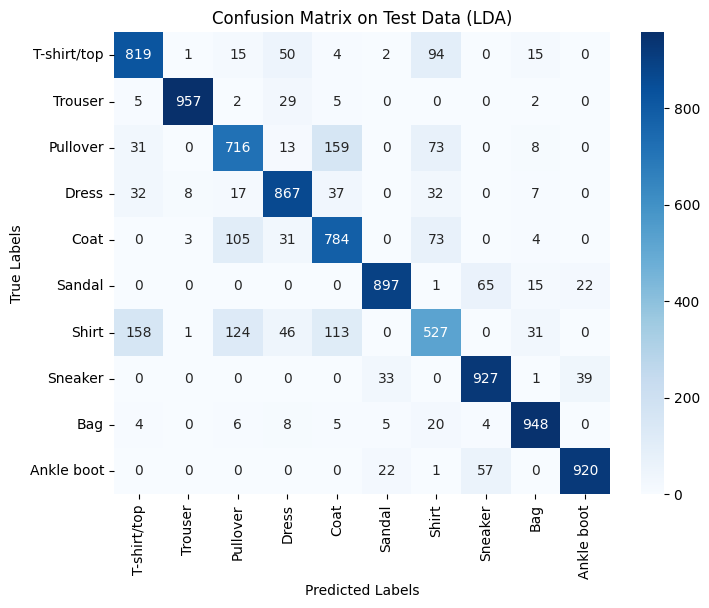

In [ ]:
y_pred_best_lda = best_rbf_lda.predict(X_test_lda)

# In báo cáo phân loại
report = classification_report(y_test, y_pred_best_lda, target_names=list(label_description.values()))
print(report)
conf_matrix = confusion_matrix(y_test, y_pred_best_lda)

# Vẽ confusion matrix với heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=list(label_description.values()), yticklabels=list(label_description.values()))
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix on Test Data (LDA)')
plt.show()


So sánh mô hình dữ liệu giảm chiều LDA với mô hình đã tuning tham số C và giảm chiều LDA.

1. Độ chính xác và các chỉ số Precision, Recall, F1-Score:

* Mô hình sau khi tuning đạt độ chính xác tăng nhẹ từ 83% lên 84%.
* Các chỉ số macro average và weighted average của Precision, Recall, F1-Score cũng tăng nhẹ. Cho thấy hiệu suất tổng thể của mô hình có cải thiện một chút sau khi tuning.

2. Ma trận nhầm lẫn (Confusion Matrix):
* Sau khi tuning, có một số thay đổi nhỏ trong số lượng dự đoán đúng ở các lớp như Pullover và Dress.
* Các lớp khó phân loại vẫn có tỷ lệ nhầm lẫn cao.

Kết luận:
Việc tuning tham số C có mang lại sự cải thiện nhỏ về hiệu suất cho mô hình. Điều này cho thấy tham số C có ảnh hưởng lớn tới mô hình.

### **Conclusion for task Train another SVM using an RBF kernel and compare the results with the linear kernel SVM and logistic regression.**

  **Bảng So Sánh Kết Quả**

|        Metric     | Full    |               |        |
|-------------------|---------|---------------|--------|
|                   | LR      | Linear        | RBF    |
| Accuracy          | 0.8435  | 0.85          | 0.88   |
| F1-score          | 0.8426  | 0.85          | 0.88   |
| Training time     | 241.62  | 517.9         | 402.17 |
| Eval time         | 0.04    | 122.97        | 244.1933 |

 Nhận xét về Kết quả

- **Độ chính xác (Accuracy)**: Mô hình SVM với kernel RBF cho thấy độ chính xác cao nhất (0.88), tuy không đạt mức cao nhất là 0.90 như dự đoán trước đó nhưng vẫn vượt qua cả SVM với kernel tuyến tính (0.85) và hồi quy logistic (0.8435). Điều này cho thấy khả năng phân loại tốt của mô hình RBF trong bài toán này.

- **F1-score**: Tương tự như độ chính xác, F1-score của SVM với kernel RBF (0.88) cũng là cao nhất so với hai mô hình còn lại (SVM tuyến tính: 0.85, Hồi quy logistic: 0.8426). F1-score cao cho thấy mô hình RBF không chỉ chính xác hơn mà còn cân bằng tốt giữa độ chính xác và độ nhạy.

- **Thời gian huấn luyện (Training time)**: Thời gian huấn luyện của SVM với kernel tuyến tính (517.9 giây) là cao hơn so với hồi quy logistic (241.62 giây), trong khi thời gian huấn luyện của SVM với kernel RBF (402.17 giây) nằm giữa hai mô hình còn lại. Điều này cho thấy mô hình RBF có thể tốn thời gian hơn một chút so với hồi quy logistic nhưng vẫn hiệu quả hơn về mặt chính xác.

- **Thời gian dự đoán (Eval time)**: Mặc dù thời gian huấn luyện của SVM với kernel RBF tương đối cạnh tranh, nhưng thời gian dự đoán lại cao hơn đáng kể (244.1933 giây) so với SVM tuyến tính (122.97 giây) và hồi quy logistic (0.04 giây). Điều này có thể là một yếu tố cần xem xét trong ứng dụng thực tế, đặc biệt khi tốc độ phản hồi của mô hình là quan trọng. Thời gian dự đoán lâu có thể ảnh hưởng đến trải nghiệm người dùng, đặc biệt trong các ứng dụng yêu cầu phản hồi nhanh.


 Kết Luận

- Mô hình SVM với kernel RBF cho thấy hiệu suất vượt trội hơn hẳn so với SVM tuyến tính và hồi quy logistic trong bài toán này. Tuy nhiên, cần cân nhắc giữa hiệu suất và thời gian huấn luyện, đặc biệt khi thời gian là yếu tố quan trọng trong ứng dụng thực tế. Việc lựa chọn mô hình nên dựa trên yêu cầu cụ thể của ứng dụng, giữa độ chính xác và thời gian dự đoán.


### **Analyze and compare computation time for training and evaluation, especially between the linear and RBF kernels.**

|        Metric     | Linear      | RBF        |
|-------------------|-------------|------------|
| Accuracy          | 0.85        | 0.88       |
| F1-score          | 0.85        | 0.88       |
| Training time     | 517.90  | 402.17  |
| Evaluation time      | 122.97  | 244.19  |





**Giải thích vì sao RBF có thời gian huấn luyện thấp hơn nhưng thời gian dự đoán cao hơn**

1. **Thời gian Huấn luyện (Training Time)**:
   - **RBF Kernel**: Kernel RBF (Radial Basis Function) sử dụng một hàm phi tuyến tính để tạo ra không gian đặc trưng phức tạp hơn so với kernel tuyến tính. Tuy nhiên, trong quá trình huấn luyện, thuật toán có thể sử dụng các tối ưu hóa và phương pháp tính toán hiệu quả hơn để tìm ra các tham số tốt nhất. Điều này có thể dẫn đến thời gian huấn luyện thấp hơn cho kernel RBF trong một số trường hợp.
   - **Linear Kernel**: Kernel tuyến tính có thể yêu cầu thời gian huấn luyện lâu hơn do nó cần xác định trọng số cho từng đặc trưng trong không gian nhiều chiều. Bên cạnh đó, khi dữ liệu không tuyến tính, kernel tuyến tính có thể không đạt được hiệu suất tốt và có thể cần nhiều vòng lặp hơn để tối ưu hóa.

2. **Thời gian Dự đoán (Evaluation Time)**:
   - **RBF Kernel**: Thời gian dự đoán cho mô hình RBF thường cao hơn vì nó cần tính toán giá trị của hàm RBF cho từng điểm dữ liệu đầu vào so với tất cả các điểm dữ liệu huấn luyện (các vector hỗ trợ). Điều này đòi hỏi tính toán nhiều phép toán phức tạp hơn, đặc biệt khi kích thước tập dữ liệu lớn.
   - **Linear Kernel**: Mô hình tuyến tính, ngược lại, có thể thực hiện dự đoán nhanh hơn vì nó chỉ cần nhận các đặc trưng đầu vào với các trọng số đã học. Tính toán này đơn giản và có thể thực hiện nhanh chóng.

**Kết luận**
- Mặc dù kernel RBF có thể huấn luyện nhanh hơn trong một số tình huống, nó lại yêu cầu nhiều phép toán phức tạp hơn trong quá trình dự đoán, dẫn đến thời gian dự đoán cao hơn so với kernel tuyến tính. Điều này là do sự khác biệt trong cách mà các kernel xử lý dữ liệu và tính toán trong không gian đặc trưng.


### **Reflect on the trade-offs between dimensionality reduction and model performance.**

 Bảng So Sánh Kết Quả Mô Hình

|        Metric     | Full        |          |            | PCA         |             |            | LDA         |          |
|-------------------|-------------|----------|------------|-------------|-------------|------------|-------------|----------|
|                   | Linear      | RBF      |            | Linear      | RBF         |            | Linear      | RBF      |
| Accuracy          | 0.85        | 0.88     |            | 0.85        | 0.89        |            | 0.83        | 0.83     |
| F1-score          | 0.85        | 0.88     |            | 0.85        | 0.89        |            | 0.82        | 0.83     |
| Training time     | 517.90      | 402.17   |            | 210.75      | 146.02      |            | 3.50      | 28.67    |
| Eval time         | 122.97      | 244.19   |            | 40.37       | 84.93       |            | 10.99      | 18.88    |

- Mô hình SVM với phương pháp kernel RBF đạt hiệu suất cao nhất với độ chính xác 0.88. Tuy nhiên, thời gian huấn luyện của nó là 402.17 giây, cho thấy rằng mặc dù nó mang lại kết quả tốt, nhưng chi phí tính toán cũng đáng kể.

- Mô hình SVM sử dụng PCA cho cả kernel Linear và RBF cho thấy sự cân bằng giữa độ chính xác và thời gian huấn luyện. Cả hai đều đạt độ chính xác 0.85 và 0.89, trong khi thời gian huấn luyện giảm xuống còn 210.75 giây và 146.02 giây. Điều này cho thấy rằng PCA có thể là một lựa chọn hợp lý nếu bạn muốn giảm thiểu thời gian huấn luyện mà vẫn giữ được hiệu suất chấp nhận được.

- LDA, mặc dù không thể so sánh với PCA và mô hình đầy đủ về hiệu suất, vẫn giữ được độ chính xác ổn định (0.83 cho Linear và 0.83 cho RBF) với thời gian huấn luyện rất thấp (43.50 giây và 28.67 giây). Điều này chứng tỏ rằng LDA có thể là một phương pháp hữu ích khi bạn cần một giải pháp nhanh chóng mà không yêu cầu độ chính xác tối đa.


## **05. Compare Models**

### Bảng So Sánh Kết Quả Mô Hình

|        Metric     | Full    |               |        | PCA        |              |            | LDA        |         |                 |
|-------------------|------------------|---------------|--------|------------|--------------|------------|------------|---------|-----------------|
|                   | LR               | Linear        | RBF    | LR         | Linear       | RBF        | LR         | Linear  | RBF             |
| Accuracy          | 0.8435           | 0.85          | 0.88   | 0.8435     | 0.85         | 0.89       | 0.82       | 0.83    | 0.83            |
| F1-score          | 0.8426           | 0.85          | 0.88   | 0.84       | 0.85         | 0.89       | 0.82       | 0.82    | 0.83            |
| Training time     | 241.62           | 517.90        | 402.17 | 52.02      | 210.75       | 146.02     | 3.50      | 43.50   | 28.67            |
| Eval time         | 0.04             | 122.97        | 244.19 | 0.0110     | 40.37        | 84.93      | 0.0021     | 10.99   | 18.88            |


**Độ chính xác tổng thể:**

- **SVM Linear** đạt độ chính xác tổng thể là **0.85** trên dữ liệu đầy đủ (Full dimension), **0.85** trên PCA và **0.83** trên LDA. **SVM RBF** đạt độ chính xác cao hơn, với **0.88** trên Full dimension, **0.89** trên PCA và **0.83** trên LDA, cho thấy mô hình RBF có khả năng phân loại tốt hơn so với mô hình Linear.
- **Logistic Regression (LR)** đạt độ chính xác tổng thể là **0.8435** trên dữ liệu Full dimension, **0.8435** trên PCA và **0.82** trên LDA. Mặc dù độ chính xác của LR không cao như SVM, nhưng vẫn cho thấy khả năng phân loại ổn định trên cả ba loại dữ liệu.

**Hiệu suất tổng quan (F1-score):**

- **SVM Linear** đạt F1-score là **0.85** trên Full dimension, **0.85** trên PCA và giảm xuống **0.83** trên LDA. Điều này cho thấy SVM Linear hoạt động tốt trên dữ liệu đầy đủ và PCA, nhưng hiệu suất giảm nhẹ trên LDA.
- **SVM RBF** có F1-score ổn định ở mức **0.88** trên Full dimension, **0.89** trên PCA, trong khi giảm xuống **0.83** trên LDA. Mô hình RBF có khả năng duy trì hiệu suất cao hơn so với Linear trong cả dữ liệu đầy đủ và PCA.
- F1-score của **LR** là **0.8426** trên Full dimension, **0.84** trên PCA và **0.82** trên LDA. Mặc dù các giá trị này gần bằng với độ chính xác, nhưng chúng cho thấy LR có hiệu suất khá nhất quán trên các tập dữ liệu khác nhau.

**Ma trận nhầm lẫn:**

- Ma trận nhầm lẫn của cả **hai mô hình SVM** đều cho thấy các lớp có đặc điểm tương tự dễ bị nhầm lẫn, đặc biệt là "T-Shirt/top", "Shirt", "Pullover" và "Coat".
- Tuy nhiên, trên RBF có giảm thiểu số lượng mẫu bị nhầm lẫn nhiều hơn so với Linear, nhờ vào khả năng phi tuyến giúp tìm ra ranh giới phân loại phức tạp hơn.
- Ma trận nhầm lẫn của **Logistic Regression** cũng chỉ ra rằng một số lớp tương tự dễ bị nhầm lẫn. Điều này đặc biệt đúng đối với các lớp có đặc điểm giống nhau, chẳng hạn như "T-Shirt/top", "Shirt", và "Pullover".

**Thời gian huấn luyện:**

- Thời gian huấn luyện của **SVM Linear** với Full dimension là **517.90 giây**, giảm đáng kể khi sử dụng PCA (**210.75 giây**) và LDA (**146.02 giây**).
- **SVM RBF** có thời gian huấn luyện là **402.17 giây** trên Full dimension, nhưng giảm khi sử dụng PCA (**146.02 giây**) và rất nhanh với LDA (**28.67 giây**).
- Thời gian huấn luyện của **Logistic Regression** trên dữ liệu Full dimension là **245.72 giây**, trong khi thời gian giảm xuống **58.01 giây** với PCA và rất nhanh ở **3.05 giây** với LDA.

**Nhận xét tổng quan:**

- Mô hình **SVM Linear** thể hiện hiệu suất khá tốt với các lớp có ranh giới phân loại rõ ràng, nhưng vẫn còn gặp khó khăn trong việc phân biệt các lớp có đặc trưng chồng chéo.
- **SVM RBF** cho thấy khả năng cải thiện đáng kể về độ chính xác cũng như hiệu suất, nhờ vào khả năng xử lý dữ liệu phi tuyến và phức tạp.
- Sử dụng **PCA** và **LDA** giúp giảm thời gian huấn luyện đáng kể, đặc biệt là với kernel RBF, trong khi độ chính xác chỉ giảm rất ít trong hầu hết các trường hợp.
- Mô hình **Logistic Regression** thể hiện hiệu suất khá tốt trên các lớp có ranh giới phân loại rõ ràng. Tuy nhiên, khi đối mặt với các lớp có đặc trưng chồng chéo, mô hình có thể không đạt được độ chính xác tối ưu như SVM, đặc biệt là trong trường hợp dữ liệu phi tuyến.
- Mặc dù **Logistic Regression** là một phương pháp đơn giản và hiệu quả, nhưng nó có thể không khai thác được các mối quan hệ phi tuyến trong dữ liệu như **SVM RBF**, điều này dẫn đến việc SVM RBF có khả năng phân loại tốt hơn trong hầu hết các trường hợp.
- Thời gian huấn luyện của **Logistic Regression** cũng cho thấy nó có thể là một lựa chọn nhanh chóng trong các tình huống cần kết quả nhanh chóng, nhưng không nên bỏ qua các mô hình phức tạp hơn nếu mục tiêu là đạt được độ chính xác cao nhất.

Từ những phân tích trên, có thể thấy rằng bộ dữ liệu có tính chất phi tuyến nên sử dụng mô hình **SVM RBF kernel** sẽ đạt được độ chính xác cao hơn.

**So sánh giữa PCA và LDA**

1. **PCA**: Khi giảm chiều bằng PCA, mô hình SVM với kernel RBF vẫn giữ được độ chính xác cao gần với dữ liệu gốc. PCA giữ lại các thông tin quan trọng nhất, giúp duy trì cấu trúc phi tuyến của dữ liệu, phù hợp cho việc phân loại các lớp trong Fashion-MNIST, PCA sẽ là 1 lựa chọn cân đối cho hiệu suất - chi phí tính toán - thời gian.

2. **LDA**: LDA chỉ giữ lại tối đa 9 chiều (do có 10 lớp) và tập trung vào việc phân biệt tuyến tính giữa các lớp. Với dữ liệu phi tuyến và đa dạng như Fashion-MNIST, LDA làm mất nhiều đặc trưng quan trọng, khiến mô hình SVM hoạt động kém hiệu quả hơn so với khi dùng PCA. Mặc dù là kém hơn PCA về hiệu suất nhưng với LDA, thì chi phí tính toán và thời gian training sẽ giảm đi rất nhiều bởi vì với các bài toán phân loại hiện tại có số lớp thấp (10 lớp) thì LDA đang là 1 lựa chọn rất tốt nếu mục tiêu là tối ưu hóa chi phí tính toán và thời gian training.

**Tóm lại**: PCA giữ lại được nhiều thông tin hữu ích hơn trong dữ liệu phức tạp và phi tuyến, giúp mô hình SVM RBF đạt hiệu suất tốt hơn so với LDA.


 **Đánh Giá Hiệu Quả Mô Hình SVM-RBF Sau Khi Giảm Chiều Dữ Liệu**

- Thông qua các chỉ số đánh giá (metrics), chúng ta nhận thấy rằng mô hình SVM với kernel RBF, khi kết hợp với kỹ thuật giảm chiều dữ liệu như PCA, đã đạt được kết quả tốt hơn so với khi sử dụng toàn bộ các chiều ban đầu. Cụ thể, sau khi áp dụng PCA, số chiều dữ liệu đã giảm từ 784 xuống còn 187. Trong trường hợp của SVM_linear và logistic regression có thể do model chưa đủ phức tạp để học được thông tin ở các lớp chồng chéo lên nhau vì thế nên hiệu suất vẫn không được cải thiện rõ rệt.

**Phân Tích Tỷ Lệ Khoảng Cách Gần Nhất và Xa Nhất**

- Như được thể hiện trong đồ thị bên dưới, tại ngưỡng gần 200 chiều, tỷ lệ giữa khoảng cách gần nhất (min_distance) và khoảng cách xa nhất (max_distance) vẫn chưa có sự chênh lệch quá lớn và chưa hoàn toàn hội tụ. Điều này cho thấy rằng mặc dù số chiều đã giảm đáng kể, nhưng dữ liệu vẫn giữ được cấu trúc và thông tin quan trọng.

**Kết Luận về Việc Phân Lớp**

- Với mô hình đủ mạnh như SVM-RBF, việc giảm chiều dữ liệu giúp tăng cường khả năng phân lớp giữa các lớp chồng chéo. Khi dữ liệu đã được tối ưu hóa về số chiều, mô hình có khả năng học được sự phức tạp giữa các lớp một cách dễ dàng hơn, dẫn đến việc cải thiện độ chính xác trong phân loại.


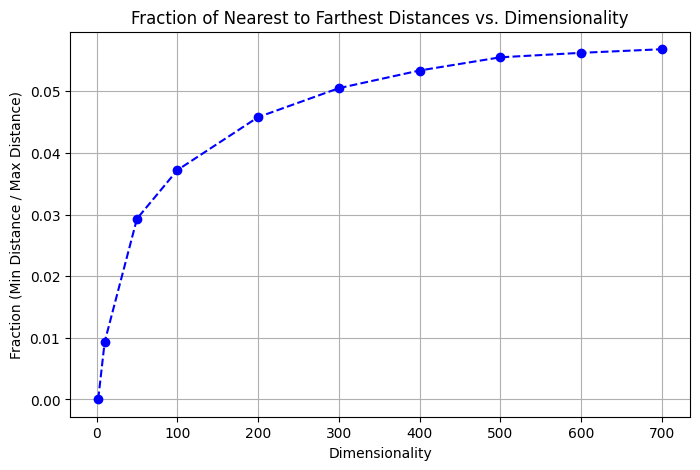

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(dimensions_list, fraction_list, marker='o', linestyle='--', color='b')
plt.title('Fraction of Nearest to Farthest Distances vs. Dimensionality')
plt.xlabel('Dimensionality')
plt.ylabel('Fraction (Min Distance / Max Distance)')
plt.grid(True)
plt.show()

### Create plots to visualize model accuracy, confusion matrices, or performance metrics (precision, recall, F1 score) across different models and settings.


In [ ]:
df_features = [
    'Model Name',
    'Training Time (s)',
    'Evaluation Time (s)',
    'Accuracy',
    'F1 Score'
]

In [ ]:
model_names = [
  'SVM linear',
  'SVM RBF',
  'SVM PCA Linear',
  'SVM LDA Linear',
  'SVM PCA RBF',
  'SVM LDA RBF',
  'Logistic Regression',
  'Logistic Regression - LDA',
  'Logistic Regression - PCA'
]

training_times = [517.90, 402.17, 210.75, 43.50, 146.02, 28.67, 245.7179, 245.62, 52.02]
predict_times = [122.97, 244.1933, 40.37, 10.99, 84.93, 18.88,  0.04, 0.0021, 0.011]
accuracies = [0.85, 0.88, 0.85, 0.83, 0.89, 0.83, 0.8435, 0.82, 0.84]
f1_scores = [0.85, 0.88, 0.85, 0.82, 0.89, 0.83, 0.8426, 0.82, 0.84]

In [ ]:
print(len(model_names))
print(len(training_times))
print(len(predict_times))
print(len(accuracies))
print(len(f1_scores))

9
9
9
9
9


In [ ]:
import pandas as pd
model_comparison_df = pd.DataFrame({
    'Model Name': model_names,
    'Training Time (s)': training_times,
    'Prediction Time (s)': predict_times,
    'Accuracy': accuracies,
    'F1 Score': f1_scores
})

model_comparison_df

,Model Name,Training Time (s),Prediction Time (s),Accuracy,F1 Score
0,SVM linear,517.9000,122.9700,0.8500,0.8500
1,SVM RBF,402.1700,244.1933,0.8800,0.8800
2,SVM PCA Linear,210.7500,40.3700,0.8500,0.8500
3,SVM LDA Linear,43.5000,10.9900,0.8300,0.8200
4,SVM PCA RBF,146.0200,84.9300,0.8900,0.8900
5,SVM LDA RBF,28.6700,18.8800,0.8300,0.8300
6,Logistic Regression,245.7179,0.0400,0.8435,0.8426
7,Logistic Regression - LDA,245.6200,0.0021,0.8200,0.8200
8,Logistic Regression - PCA,52.0200,0.0110,0.8400,0.8400


In [ ]:
#Training Time (s)
training_time_df = model_comparison_df.sort_values(by='Training Time (s)', ascending=False)
training_time_df

,Model Name,Training Time (s),Prediction Time (s),Accuracy,F1 Score
0,SVM linear,517.9000,122.9700,0.8500,0.8500
1,SVM RBF,402.1700,244.1933,0.8800,0.8800
6,Logistic Regression,245.7179,0.0400,0.8435,0.8426
7,Logistic Regression - LDA,245.6200,0.0021,0.8200,0.8200
2,SVM PCA Linear,210.7500,40.3700,0.8500,0.8500
4,SVM PCA RBF,146.0200,84.9300,0.8900,0.8900
8,Logistic Regression - PCA,52.0200,0.0110,0.8400,0.8400
3,SVM LDA Linear,43.5000,10.9900,0.8300,0.8200
5,SVM LDA RBF,28.6700,18.8800,0.8300,0.8300


<ipython-input-40-37d92428c98f>:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


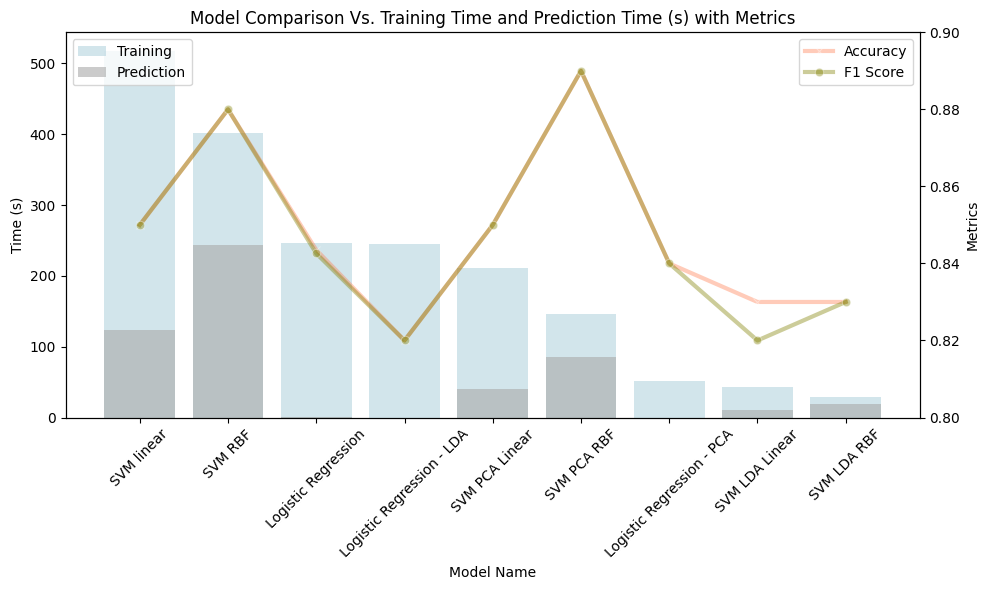

In [ ]:
plt.figure(figsize=(10, 6))

# Create first 2 barplots
ax1 = plt.gca()
sns.barplot(x='Model Name', y='Training Time (s)', data=training_time_df, color='lightblue', linewidth=2, label='Training', alpha=0.6, ax=ax1)
sns.barplot(x='Model Name', y='Prediction Time (s)', data=training_time_df, color='darkgrey', linewidth=2, label='Prediction', alpha=0.6, ax=ax1)
ax1.set_ylabel('Time (s)')
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)
ax1.legend(loc='upper left')

# Create 2 more linegraphs
ax2 = plt.gca().twinx()
sns.lineplot(x='Model Name', y='Accuracy', data=training_time_df, marker='x', color='coral', label='Accuracy', ax=ax2, linewidth=3, alpha=0.4)
sns.lineplot(x='Model Name', y='F1 Score', data=training_time_df, marker='o', color='olive', label='F1 Score', ax=ax2, linewidth=3, alpha=0.4)
ax2.set_ylim(0.8, 0.9)
ax2.set_ylabel('Metrics', color='black')
ax2.tick_params(axis='y', labelcolor='black')
ax2.legend(loc='upper right')

plt.xlabel('Model Name')
plt.title('Model Comparison Vs. Training Time and Prediction Time (s) with Metrics')


plt.tight_layout()
plt.show()


### Discuss the pros and cons of each model, considering aspects like accuracy, computation time, and their behavior when handling high-dimensional data.

 So sánh các Mô hình: Ưu và Nhược điểm

1. Hồi quy Logistic (Logistic Regression)
- **Ưu điểm:**
  - **Thời gian tính toán**: Logistic Regression có hiệu quả tính toán cao, cả ở giai đoạn huấn luyện và dự đoán, do bản chất tuyến tính của nó. Điều này giúp mô hình phù hợp với các tập dữ liệu lớn hoặc các ứng dụng yêu cầu dự đoán trong thời gian thực.
  - **Dễ hiểu và Giải thích**: Dễ dàng giải thích các kết quả, do mô hình gán trọng số cho từng đặc trưng, giúp người dùng hiểu được tầm quan trọng của mỗi đặc trưng.
  - **Hiệu suất trong không gian chiều cao**: Logistic Regression hoạt động tốt trong không gian chiều cao, đặc biệt khi sử dụng điều chuẩn (regularization) để tránh overfitting.
- **Nhược điểm:**
  - **Giới hạn ở các đường biên tuyến tính**: Logistic Regression khó xử lý các dữ liệu phi tuyến, vì nó chỉ mô hình hóa đường biên tuyến tính.
  - **Độ chính xác thấp trên dữ liệu phức tạp**: Logistic Regression có thể cho độ chính xác thấp hơn trên các dữ liệu phức tạp, phi tuyến so với các mô hình phi tuyến như SVM với kernel RBF.

2. SVM với Kernel tuyến tính (Linear Kernel)
- **Ưu điểm:**
  - **Hiệu quả trong không gian chiều cao**: Kernel tuyến tính hoạt động tốt trong không gian chiều cao, phù hợp cho các ứng dụng có nhiều đặc trưng như phân loại văn bản.
  - **Cân bằng tốt giữa Độ chính xác và Hiệu quả**: Linear SVM thường có độ chính xác cao hơn Logistic Regression cho dữ liệu có ranh giới phân cách rõ ràng, và có chi phí tính toán vừa phải.
  - **Chống overfitting tốt**: Linear SVM có khả năng điều chuẩn tốt, giúp mô hình tránh overfitting ngay cả khi có nhiều chiều.
- **Nhược điểm:**
  - **Giới hạn ở dữ liệu phi tuyến**: Linear SVM hoạt động không tốt trên dữ liệu phi tuyến vì không thể mô hình hóa mối quan hệ phức tạp.
  - **Thời gian huấn luyện dài hơn**: So với Logistic Regression, Linear SVM có thể tốn nhiều thời gian huấn luyện hơn, đặc biệt là với các tập dữ liệu lớn.

3. SVM với Kernel RBF (Radial Basis Function)
- **Ưu điểm:**
  - **Độ chính xác cao trên dữ liệu phức tạp**: Kernel RBF giúp SVM xử lý các mối quan hệ phi tuyến trong dữ liệu, thường mang lại độ chính xác cao nhất trên các tập dữ liệu phức tạp.
  - **Hiệu quả với dữ liệu phi tuyến**: Kernel RBF ánh xạ dữ liệu vào không gian chiều cao hơn, giúp phân tách các lớp không phân tách được trong không gian gốc.
- **Nhược điểm:**
  - **Chi phí tính toán cao khi dự đoán**: Dự đoán với SVM RBF chậm hơn nhiều so với các mô hình tuyến tính do phải tính hàm RBF với mỗi điểm hỗ trợ (support vector) trong tập huấn luyện.
  - **Tốn tài nguyên với tập dữ liệu lớn**: SVM với Kernel RBF cần bộ nhớ và công suất xử lý cao, đặc biệt là trên các tập dữ liệu lớn, nên không thích hợp với các bài toán đòi hỏi thời gian tính toán nhanh.
  - **Khó điều chỉnh tham số**: Cần điều chỉnh cẩn thận các siêu tham số (như C và gamma) để tránh hiện tượng overfitting hoặc underfitting, điều này làm tăng độ phức tạp khi huấn luyện.

4. Tóm lại
- **Với dữ liệu tuyến tính**: Logistic Regression và SVM với Kernel tuyến tính là các lựa chọn tốt do đơn giản và hiệu quả.
- **Với dữ liệu phi tuyến phức tạp**: SVM với Kernel RBF thường là lựa chọn tốt nhất để tối ưu độ chính xác, dù chi phí tính toán cao.
- **Dữ liệu chiều cao**: Logistic Regression và SVM (Kernel tuyến tính) xử lý tốt dữ liệu nhiều chiều, trong khi SVM với Kernel RBF có thể gặp hạn chế về tài nguyên.

Lựa chọn mô hình phụ thuộc vào đặc trưng của tập dữ liệu và các ràng buộc như độ chính xác yêu cầu, thời gian tính toán, và tài nguyên sẵn có.


| Mô hình                  | Độ chính xác (dữ liệu tuyến tính) | Độ chính xác (dữ liệu phi tuyến) | Thời gian tính toán (Huấn luyện) | Thời gian tính toán (Dự đoán) | Khả năng xử lý trong không gian nhiều chiều | Ứng dụng trong dự án thực tế |
|--------------------------|-----------------------------------|----------------------------------|----------------------------------|-------------------------------|--------------------------------------------|-------------------------------|
| **Logistic Regression**  | Tốt                              | Kém                              | Nhanh                            | Nhanh                         | Tốt                                       | Thích hợp khi cần giải pháp đơn giản và nhanh chóng, dữ liệu tuyến tính |
| **SVM Linear Kernel**    | Tốt                              | Kém                              | Chậm                             | Nhanh hơn RBF                      | Tốt                                       | Phù hợp với dữ liệu tuyến tính, độ chính xác cao nhưng thời gian huấn luyện lâu |
| **SVM với RBF Kernel**   | Tốt                              | Tốt                              | Nhanh hơn Linear                 | Chậm                          | Tốt (nhưng bị hạn chế về chi phí tính toán)       | Lý tưởng cho dữ liệu phi tuyến nếu không giới hạn thời gian và tài nguyên |
